
# Preprocessing - QC & Filtering - NVF E15.5 Multiome GEX & ATAC

Michael Sterr

2022-02-25 19:23:34   

# Setup

In [1]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging

#R
import rpy2
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rcParams
import seaborn as sb

# Analysis
import scanpy as sc

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

In [2]:
# Display options
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))
#pd.set_option("display.max_rows", None)

from itables import init_notebook_mode
init_notebook_mode(all_interactive=True)

<IPython.core.display.Javascript object>

In [3]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
sc.logging.print_versions()

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                         8.3.2
anndata2ri                  1.0.6
backcall                    0.2.0
backports                   NA
beta_ufunc                  NA
binom_ufunc                 NA
cffi                        1.14.6
cloudpickle                 2.0.0
colorama                    0.4.4
cycler                      0.10.0
cython_runtime              NA
dask                        2021.09.0
dateutil                    2.8.2
debugpy      

In [4]:
%%R

.libPaths(c("/home/michi/Software/venvs/scAnalysis_1.8_R4.1/lib/R/library"))

.libPaths()

library(tidyverse)
library(Signac)
library(Seurat)
library(EnsDb.Mmusculus.v102)
library(BSgenome.Mmusculus.UCSC.mm10)

# Parallelization
library(BiocParallel)
register(MulticoreParam(64, progressbar = TRUE))

sessionInfo()

R version 4.1.1 (2021-08-10)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/openblas-pthread/libblas.so.3
LAPACK: /usr/lib/x86_64-linux-gnu/openblas-pthread/liblapack.so.3

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=de_DE.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=de_DE.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=de_DE.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=de_DE.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats4    tools     stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] BiocParallel_1.28.0                BSgenome.Mmusculus.UCSC.mm10_1.4.3
 [3] BSgenome_1.62.0                    rtracklayer_1.54.0                
 [5] Biostrings_2.62.0                  XVector_0.34.0                    
 [7] 

In [5]:
# Color maps
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())

In [6]:
# Plot settings
%matplotlib inline
# %config InlineBackend.figure_format='retina'

## Directory
sc.settings.figdir='/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Figures'

## Plotting parameters
rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
rcParams['grid.alpha'] = 0
rcParams['xtick.bottom'] = True
rcParams['ytick.left'] = True

## Embed font
plt.rc('pdf', fonttype=42)

## Define new default settings
plt.rcParamsDefault = plt.rcParams

# Load Data

In [7]:
# Load multi modal data
adata_multi=sc.read('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix.h5ad', gex_only=False)
adata_multi.obs['sample'] = ['E15.5']*adata_multi.n_obs
adata_multi.obs['int_id'] = ['4xx']*adata_multi.n_obs
adata_multi.obs['reporter'] = ['Neurog3-Venus-Fusion']*adata_multi.n_obs
adata_multi.var_names_make_unique()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [8]:
# GEX
adata = adata_multi[:,adata_multi.var.feature_types.isin(['Gene Expression'])].copy()
adata.X = adata.X.toarray()

In [9]:
# ATAC
#adata_atac = adata_multi[:,adata_multi.var.feature_types.isin(['Peaks'])].copy()

In [10]:
# DropletUtils output
cell_barcodes_du = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_DropletUtils_CellBarcodes.csv')
cell_probs = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_DropletUtils_LogProbabilities.csv')
ambient_genes = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_DropletUtils_AmbientGenes.csv')

# CellRanger cell barcodes
cell_barcodes_cr = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/filtered_feature_bc_matrix/barcodes.tsv.gz', names=['x'])

# Preprocessing GEX

## Ambient Genes

In [11]:
ambient_genes[:10]

Unnamed: 0,ambient_genes


In [12]:
len(ambient_genes)

24784

In [13]:
adata.var['ambient_genes'] = 0.0

In [14]:
all_genes = adata.var.index
all_genes[:10]

Index(['Xkr4', 'Gm1992', 'Gm37381', 'Rp1', 'Sox17', 'Gm37323', 'Mrpl15',
       'Lypla1', 'Gm37988', 'Tcea1'],
      dtype='object')

In [15]:
adata.var['ambient_genes'][np.isin(all_genes, ambient_genes)] = ambient_genes['ambient_genes'].values

/tmp/ipykernel_2210162/2973299457.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['ambient_genes'][np.isin(all_genes, ambient_genes)] = ambient_genes['ambient_genes'].values


In [16]:
adata.var['ambient_genes'][np.isin(all_genes, ambient_genes)][:10]

,ambient_genes


/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Ambient Genes Cut-Off (221 Genes)')

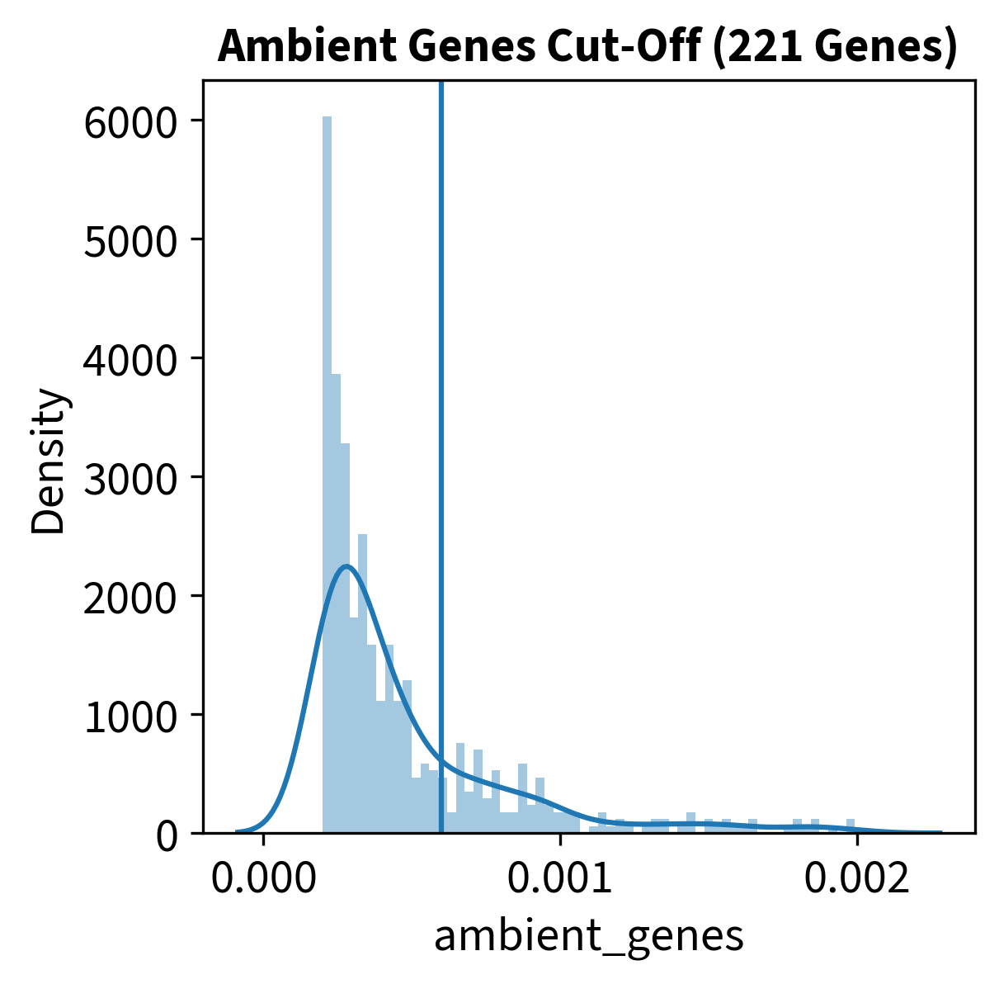

In [17]:
cut_off = 0.0006
sb.distplot(adata.var['ambient_genes'][(adata.var['ambient_genes'] > 0.0002) & (adata.var['ambient_genes'] < 0.002)], kde=True, bins=60)
plt.axvline(cut_off, 0, 1)
plt.title(label='Ambient Genes Cut-Off (' + str(len(adata.var['ambient_genes'][adata.var['ambient_genes'] > cut_off])) + ' Genes)', fontweight='bold')

In [18]:
pd.DataFrame(adata.var['ambient_genes'][adata.var['ambient_genes'] > cut_off]).sort_values(by='ambient_genes', ascending=False)

,ambient_genes


In [19]:
adata.var['is_ambient'] = pd.Categorical(list(map(str,list(adata.var['ambient_genes'] > cut_off))))

## Filter Cell Droplets

In [20]:
adata.shape

(734819, 24784)

In [21]:
all_barcodes = pd.Series(adata.obs.index)
all_barcodes[:10]

0


In [22]:
cell_probs = cell_probs.iloc[:,1:]
cell_probs[0:10]

barcodes,cell_probs


In [23]:
cell_probs.iloc[~np.isnan(list(cell_probs['cell_probs'])),:][0:10]

,barcodes,cell_probs


In [24]:
cell_probs['cell_probs'].values

array([nan, nan, nan, ..., nan, nan, nan])

In [25]:
len(cell_probs)

734819

In [26]:
cell_barcodes_du = pd.Series(cell_barcodes_du.loc[:,'x'])
cell_barcodes_du[:10]

x


In [27]:
len(cell_barcodes_du)

9388

In [28]:
cell_barcodes_cr = pd.Series(cell_barcodes_cr.loc[:,'x'])
cell_barcodes_cr[:10]

x


In [29]:
len(cell_barcodes_cr)

9067

In [30]:
adata.obs.loc[all_barcodes[all_barcodes.isin(cell_probs['barcodes'])],'log_cell_probs'] = cell_probs['cell_probs'].values

adata.obs.loc[:,'cell_barcodes_du'] = 0
adata.obs.loc[all_barcodes[all_barcodes.isin(cell_barcodes_du)],'cell_barcodes_du'] = 1

adata.obs.loc[:,'cell_barcodes_cr'] = 0
adata.obs.loc[all_barcodes[all_barcodes.isin(cell_barcodes_cr)],'cell_barcodes_cr'] = 1

adata.obs.loc[:,'cell_barcodes'] = adata.obs.loc[:,['cell_barcodes_cr','cell_barcodes_du']].sum(axis=1)

In [31]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)
adata.obs['log_genes'] = np.log(adata.obs['n_genes'])

mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

rp_gene_mask = [gene.startswith(('Rps','Rpl')) for gene in adata.var_names]
adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)

rp_gene_mask = list(adata.var['ambient_genes'] > 0.0003)
adata.obs['ambi_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)

adata.obs['total_counts_rank'] = adata.obs['n_counts'].rank(method='first',ascending=False)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_2210162/2825217654.py:11: RuntimeWarning: invalid value encountered in true_divide
  adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)
/tmp/ipykernel_2210162/2825217654.py:14: RuntimeWarning: invalid value encountered in true_divide
  adata.obs['ambi_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)


/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Log Cell Probabilities')

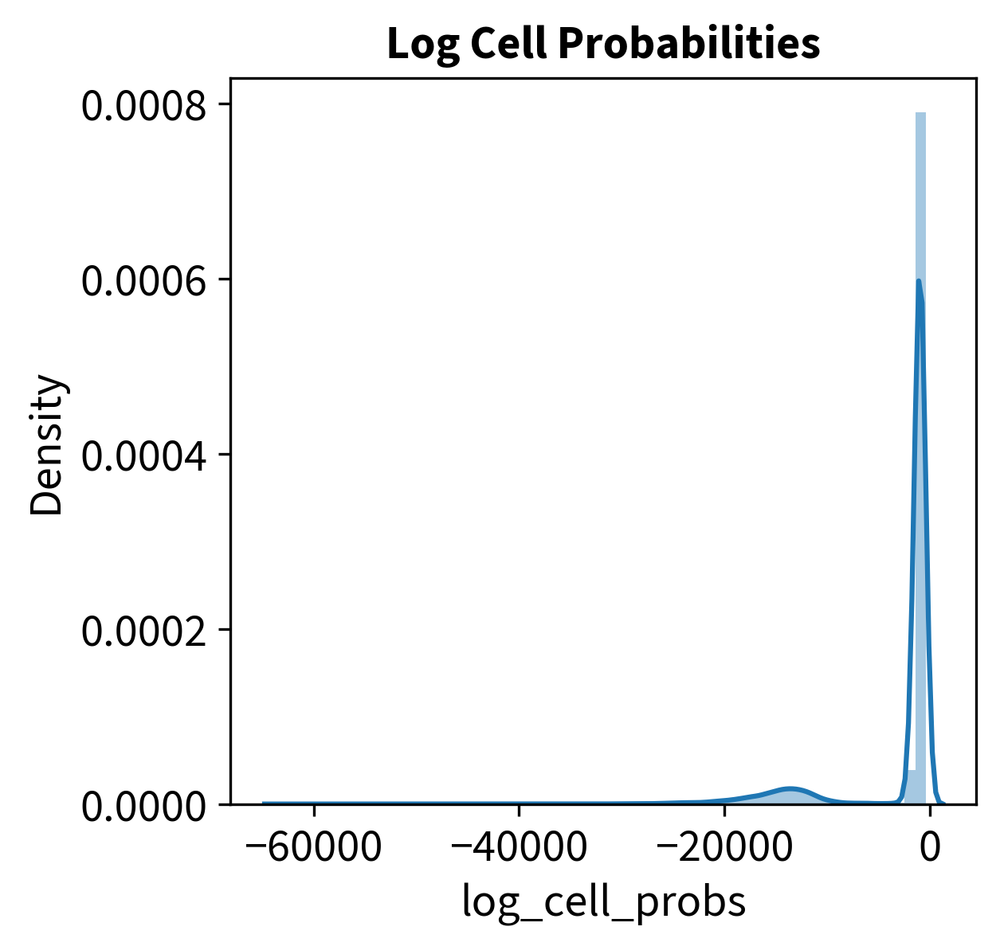

In [32]:
sb.distplot(adata.obs['log_cell_probs'][~np.isnan(list(adata.obs['log_cell_probs']))], kde=True, bins=60)
plt.title(label='Log Cell Probabilities', fontweight='bold')

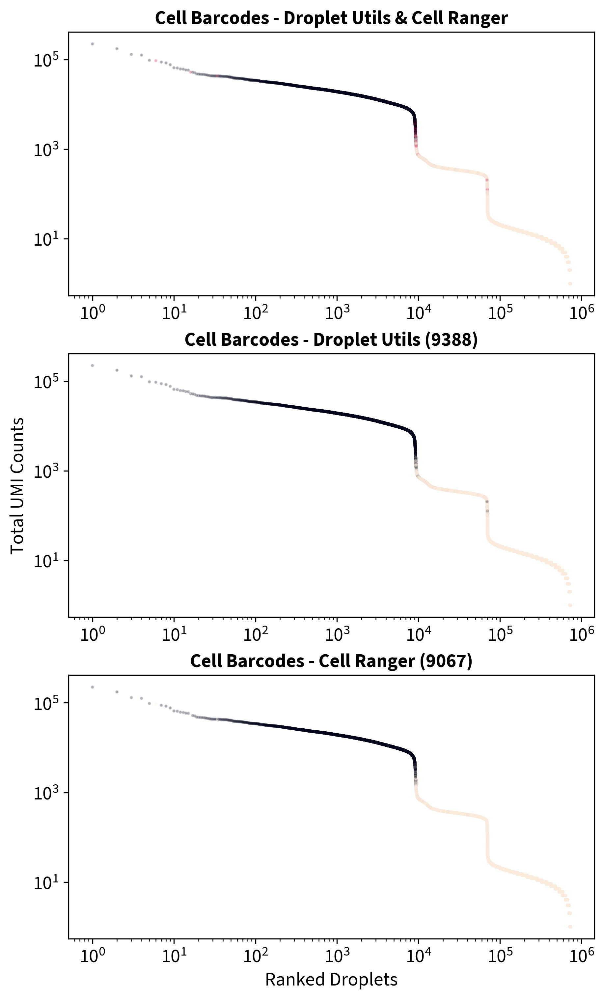

In [33]:


fig, axs = plt.subplots(3, 1, constrained_layout=True, figsize=(6, 10))
axs[0].scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=2, alpha=0.2, c=adata.obs['cell_barcodes'], cmap='rocket_r')
axs[0].set(xscale='log', yscale='log')
axs[0].set_title('Cell Barcodes - Droplet Utils & Cell Ranger', fontweight='bold')

axs[1].scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=2, alpha=0.2, c=adata.obs['cell_barcodes_du'], cmap='rocket_r')
axs[1].set(xscale='log', yscale='log')
axs[1].set_ylabel('Total UMI Counts')
axs[1].set_title('Cell Barcodes - Droplet Utils (' + str(sum(adata.obs['cell_barcodes_du'])) + ')', fontweight='bold')


axs[2].scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=2, alpha=0.2, c=adata.obs['cell_barcodes_cr'], cmap='rocket_r')
axs[2].set(xscale='log', yscale='log')
axs[2].set_xlabel('Ranked Droplets')
axs[2].set_title('Cell Barcodes - Cell Ranger (' + str(sum(adata.obs['cell_barcodes_cr'])) + ')', fontweight='bold')

plt.show()

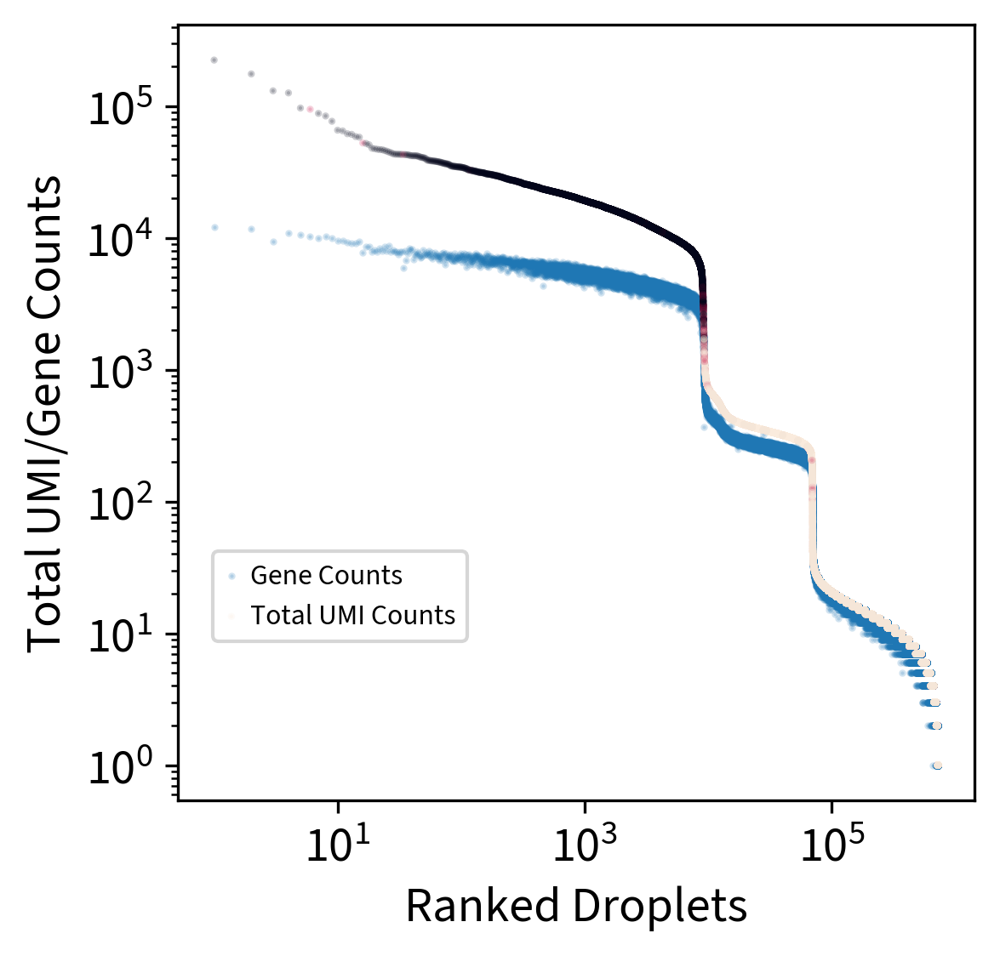

In [34]:
fig, ax1 = plt.subplots()
#ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_genes'], s=1, alpha=0.2, c='tab:blue', label='Gene Counts')
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c=adata.obs['cell_barcodes'], label='Total UMI Counts', cmap='rocket_r')
ax1.set(xscale='log', yscale='log')
ax1.set_ylabel('Total UMI/Gene Counts')
ax1.set_xlabel('Ranked Droplets')
fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

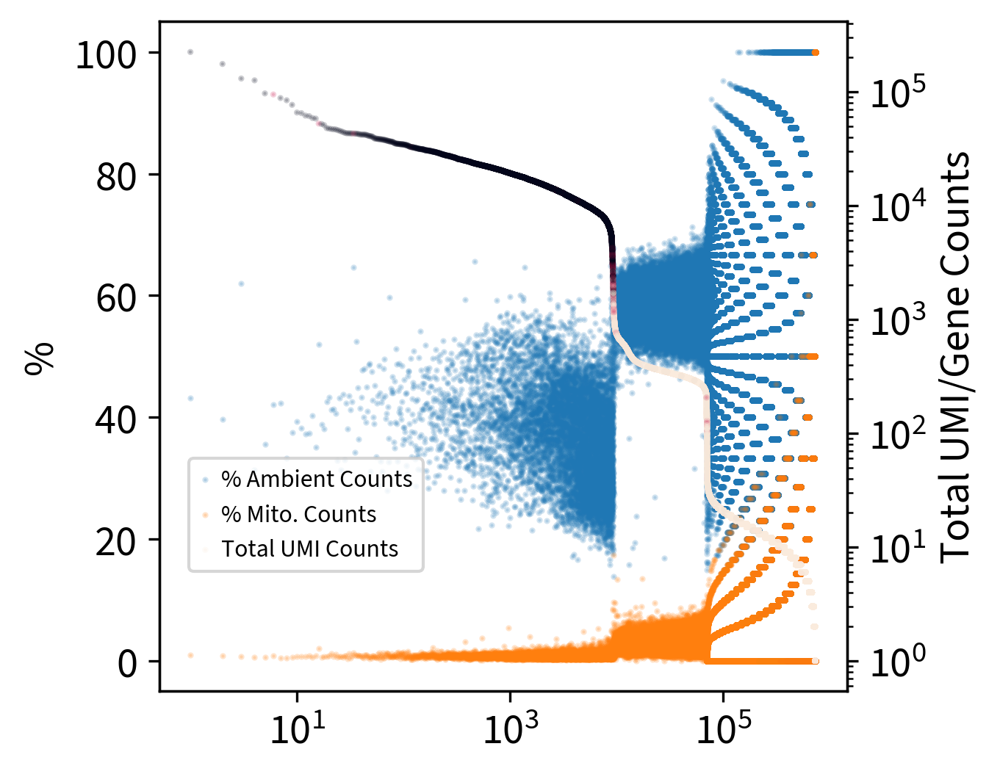

In [35]:
fig, ax1 = plt.subplots()
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['ambi_frac']*100, s=1, alpha=0.2, c='tab:blue', label='% Ambient Counts')
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['mt_frac']*100, s=1, alpha=0.2, c='tab:orange', label='% Mito. Counts')
ax1.set_ylabel('%')

ax2 = ax1.twinx()
ax2.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c=adata.obs['cell_barcodes'], label='Total UMI Counts', cmap='rocket_r')
ax2.set(xscale='log', yscale='log')
ax2.set_ylabel('Total UMI/Gene Counts')
ax2.set_xlabel('Ranked Droplets')

fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

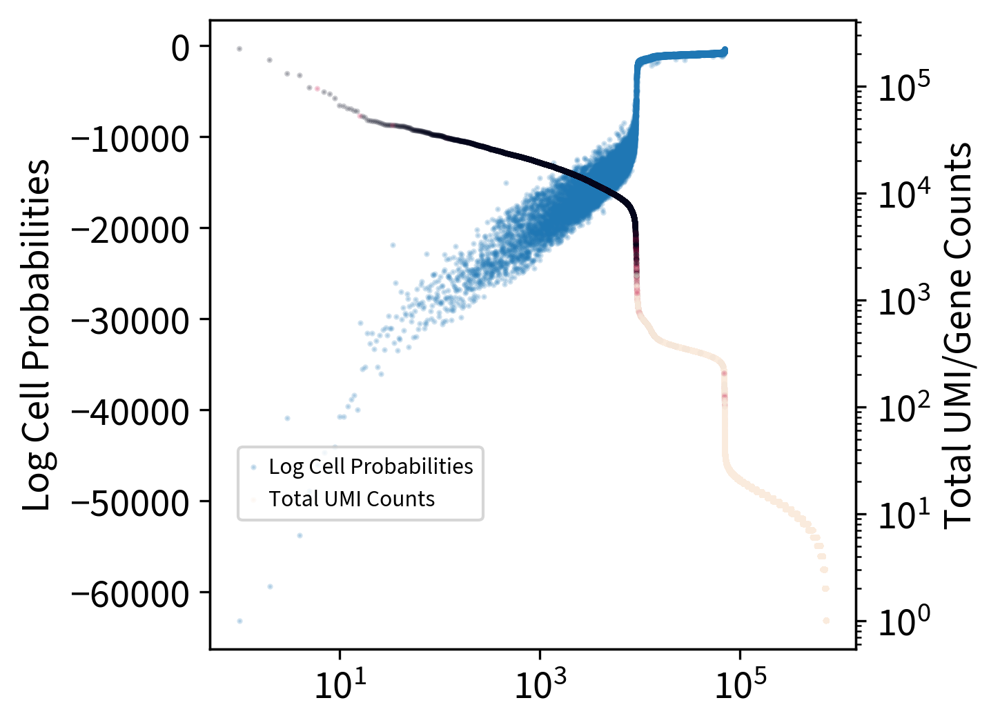

In [36]:
fig, ax1 = plt.subplots()
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['log_cell_probs'], s=1, alpha=0.2, c='tab:blue', label='Log Cell Probabilities')
ax1.set_ylabel('Log Cell Probabilities')

ax2 = ax1.twinx()
ax2.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c=adata.obs['cell_barcodes'], label='Total UMI Counts', cmap='rocket_r')
ax2.set(xscale='log', yscale='log')
ax2.set_ylabel('Total UMI/Gene Counts')
ax2.set_xlabel('Ranked Droplets')

fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

In [37]:
#Filter cell barcodes from cell ranger pipelines
adata=adata[adata.obs['cell_barcodes_cr'] > 0].copy()

In [38]:
adata.shape

(9067, 24784)

In [39]:
sc.pp.calculate_qc_metrics(adata, inplace=True, log1p=True)

In [40]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)
adata.obs['log_genes'] = np.log(adata.obs['n_genes'])

mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

rp_gene_mask = [gene.startswith(('Rps','Rpl')) for gene in adata.var_names]
adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)

rp_gene_mask = list(adata.var['ambient_genes'] > 0.0003)
adata.obs['ambi_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)

adata.obs['total_counts_rank'] = adata.obs['total_counts'].rank(method='first',ascending=False)

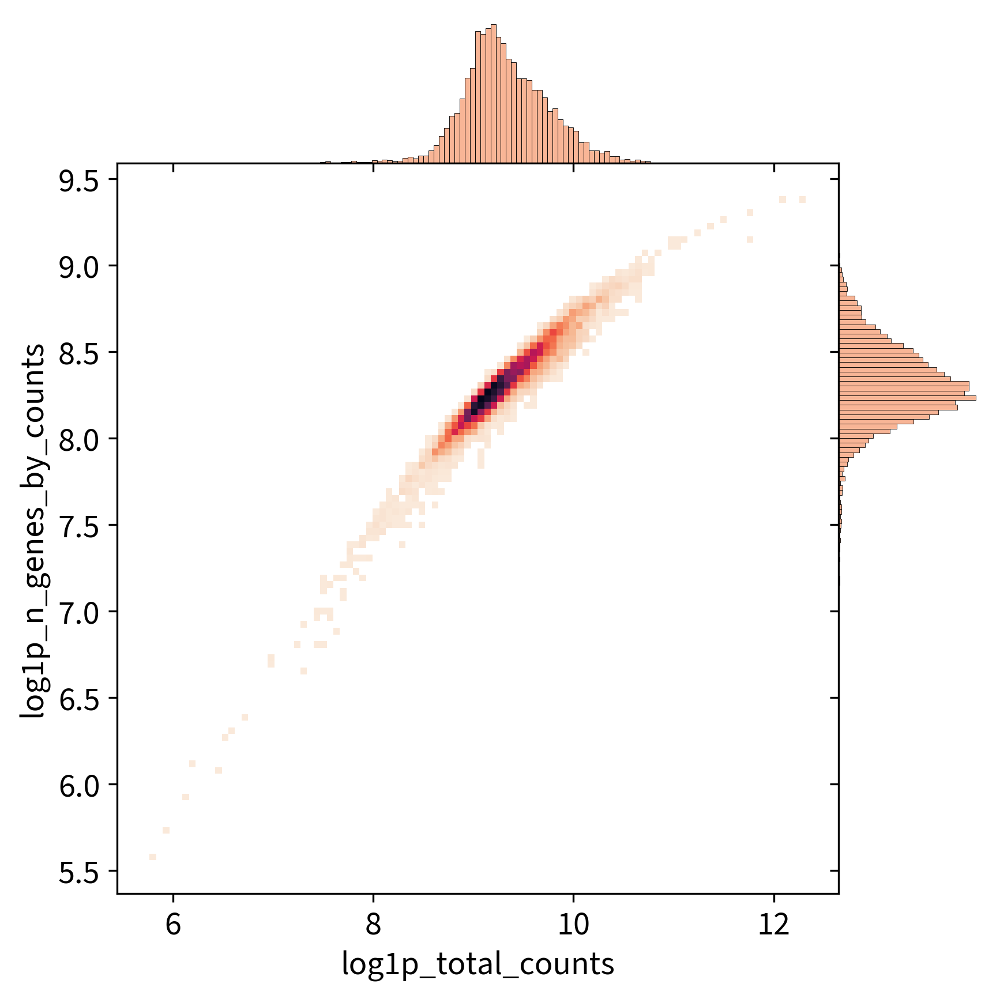

In [41]:
sb.jointplot(
    data=adata.obs,
    x="log1p_total_counts",
    y="log1p_n_genes_by_counts",
    kind="hist", bins=100, cmap="rocket_r", color="#f69c73", space=0
)

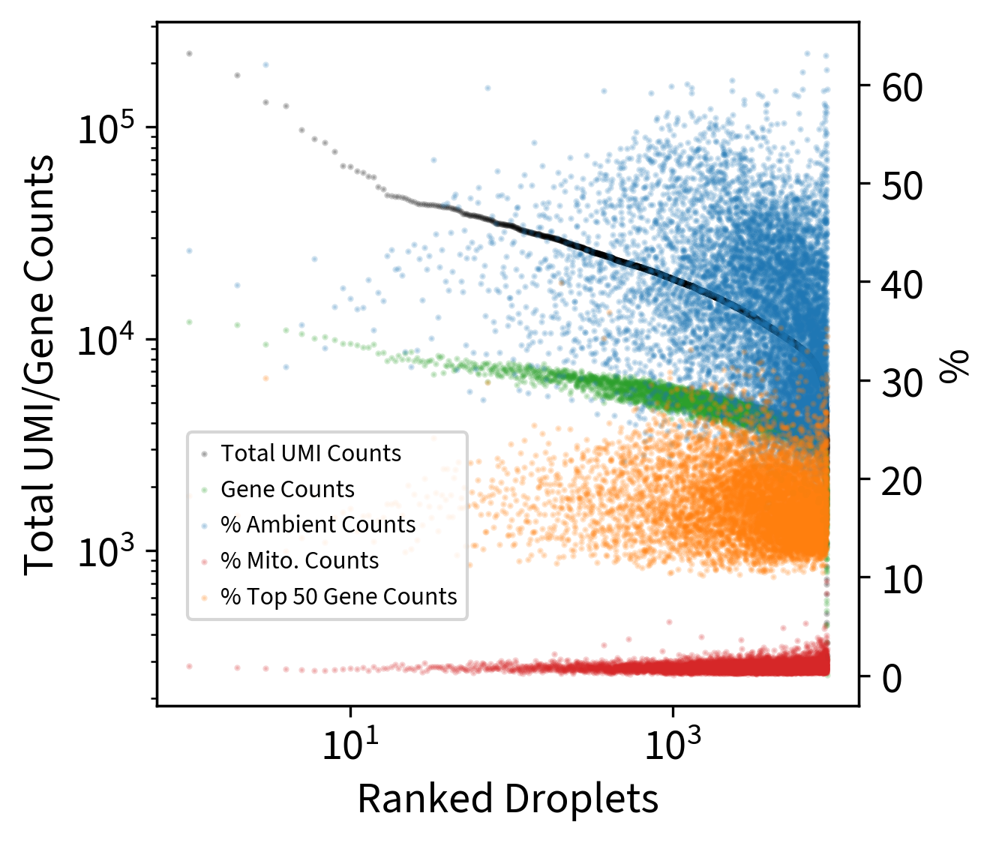

In [42]:
fig, ax1 = plt.subplots()
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['total_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
ax1.set(xscale='log', yscale='log')
ax1.set_ylabel('Total UMI/Gene Counts')
ax1.set_xlabel('Ranked Droplets')
#ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

ax2 = ax1.twinx()
ax2.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['ambi_frac']*100, s=1, alpha=0.2, c='tab:blue', label='% Ambient Counts')
ax2.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['mt_frac']*100, s=1, alpha=0.2, c='tab:red', label='% Mito. Counts')
ax2.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['pct_counts_in_top_50_genes'], s=1, alpha=0.2, c='tab:orange', label='% Top 50 Gene Counts')
ax2.set_ylabel('%')

fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

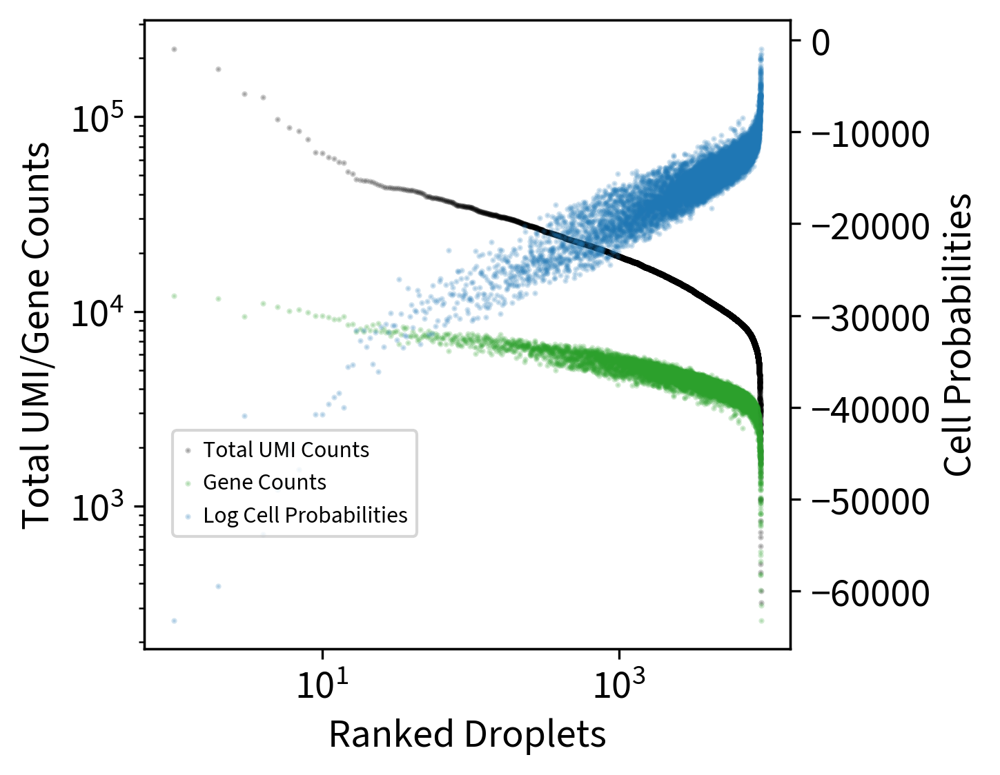

In [43]:
fig, ax1 = plt.subplots()
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['total_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
ax1.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
ax1.set(xscale='log', yscale='log')
ax1.set_ylabel('Total UMI/Gene Counts')
ax1.set_xlabel('Ranked Droplets')
#ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

ax2 = ax1.twinx()
ax2.scatter(x=adata.obs['total_counts_rank'], y=adata.obs['log_cell_probs'], s=1, alpha=0.2, c='tab:blue', label='Log Cell Probabilities')
ax2.set_ylabel('Cell Probabilities')

fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Log Cell Probabilities - Cell Barcodes')

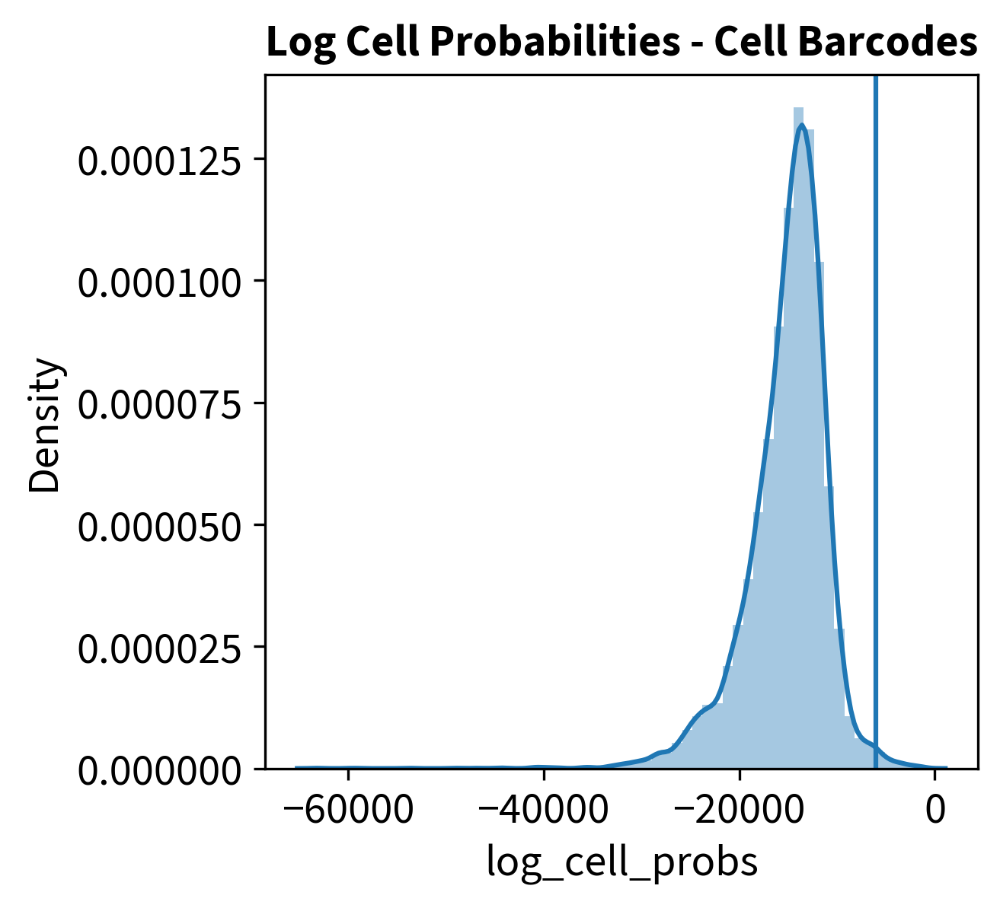

In [44]:
max_prob = -6000
sb.distplot(adata.obs['log_cell_probs'][~np.isnan(list(adata.obs['log_cell_probs']))], kde=True, bins=60)
plt.axvline(max_prob, 0, 1)
plt.title(label='Log Cell Probabilities - Cell Barcodes', fontweight='bold')

## QC & Filtering GEX

### QC & Thresholding Decisions

In [45]:
#sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=5000)
sc.pp.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata)
sc.tl.leiden(adata, resolution=0.5)

sc.tl.umap(adata)

computing PCA
    with n_comps=50
    finished (0:00:04)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:11)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'sample' as categorical
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'int_id' as categorical
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated

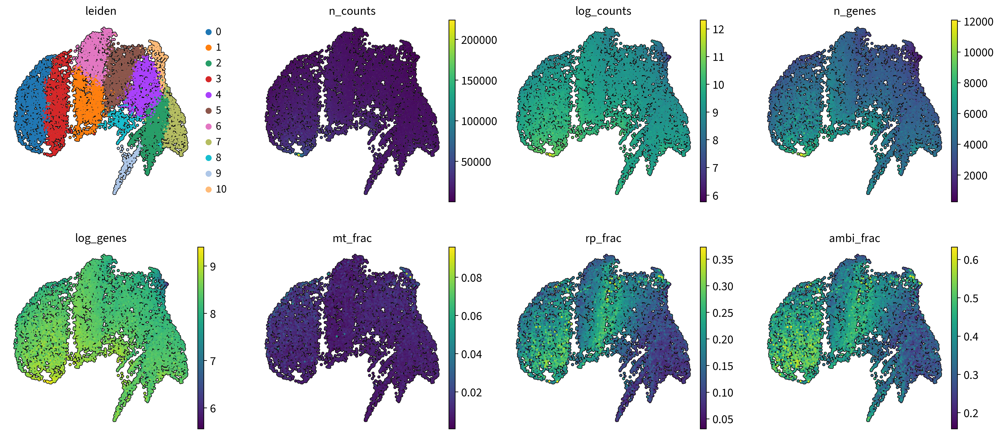

In [46]:
sc.pl.umap(adata, color=['leiden','n_counts','log_counts','n_genes','log_genes','mt_frac','rp_frac','ambi_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

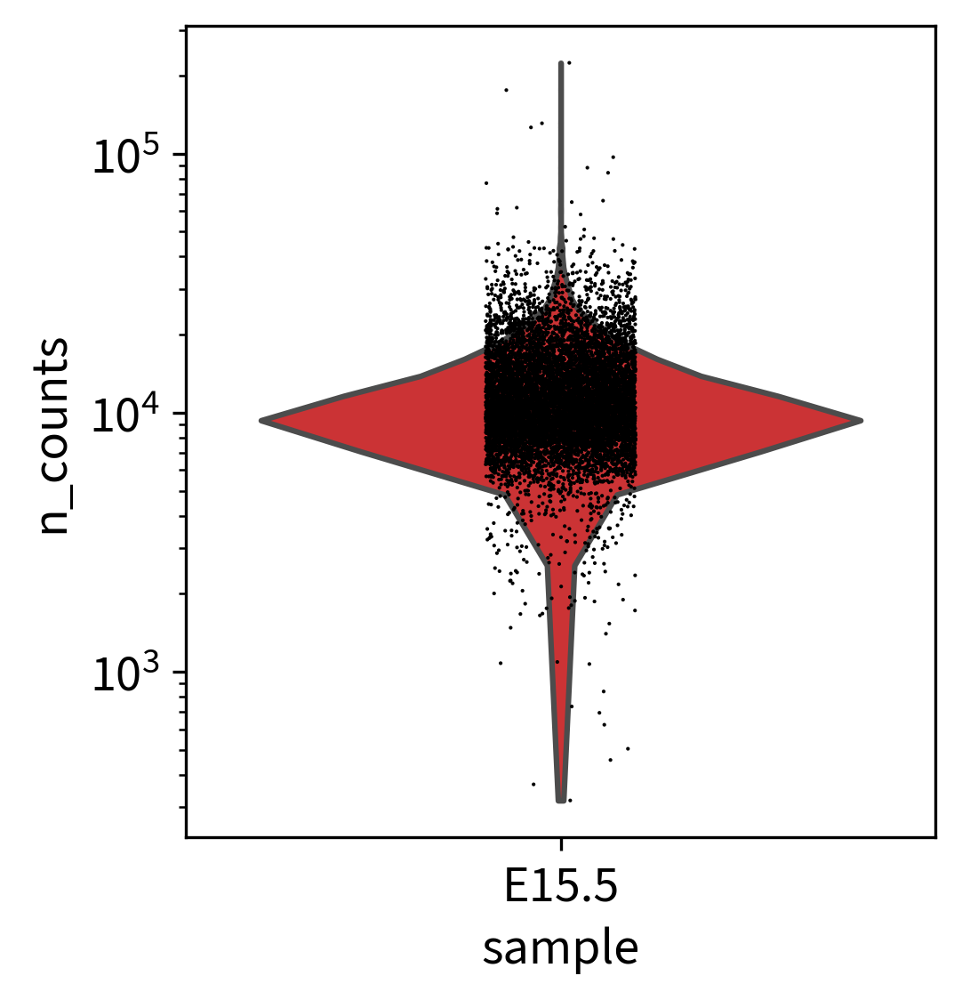

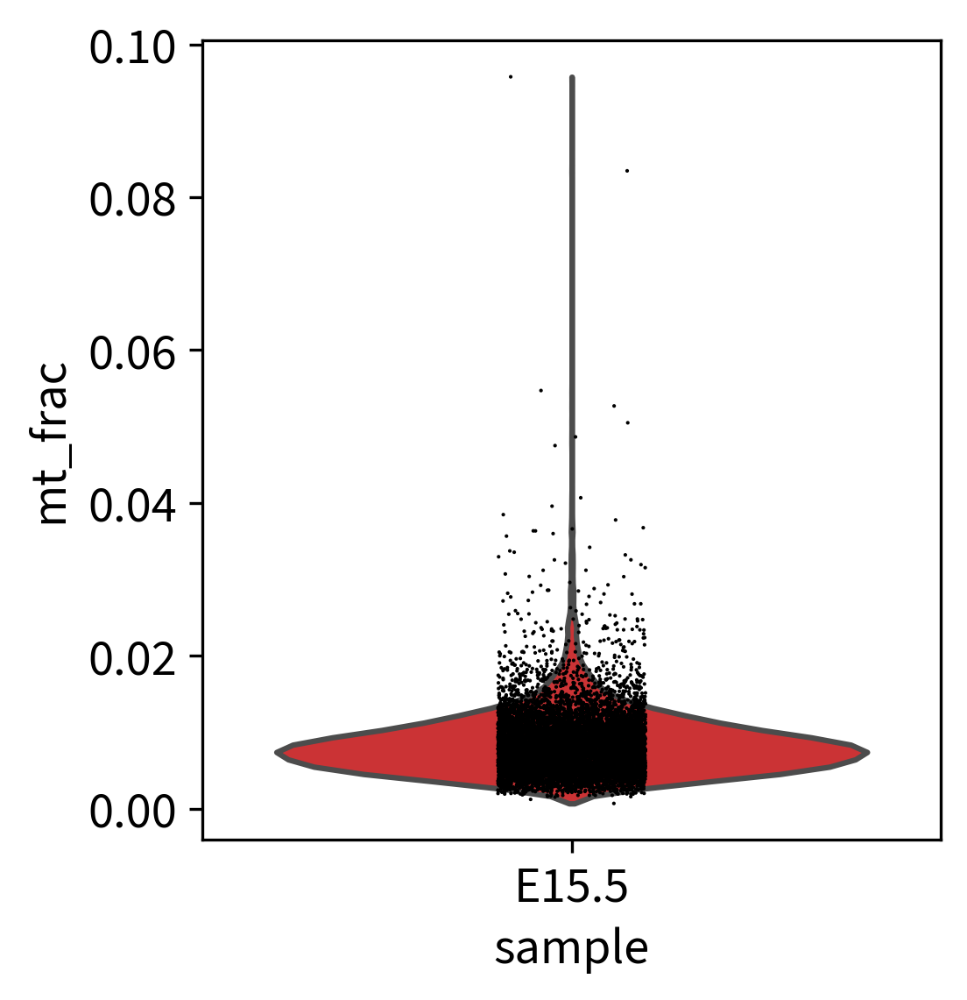

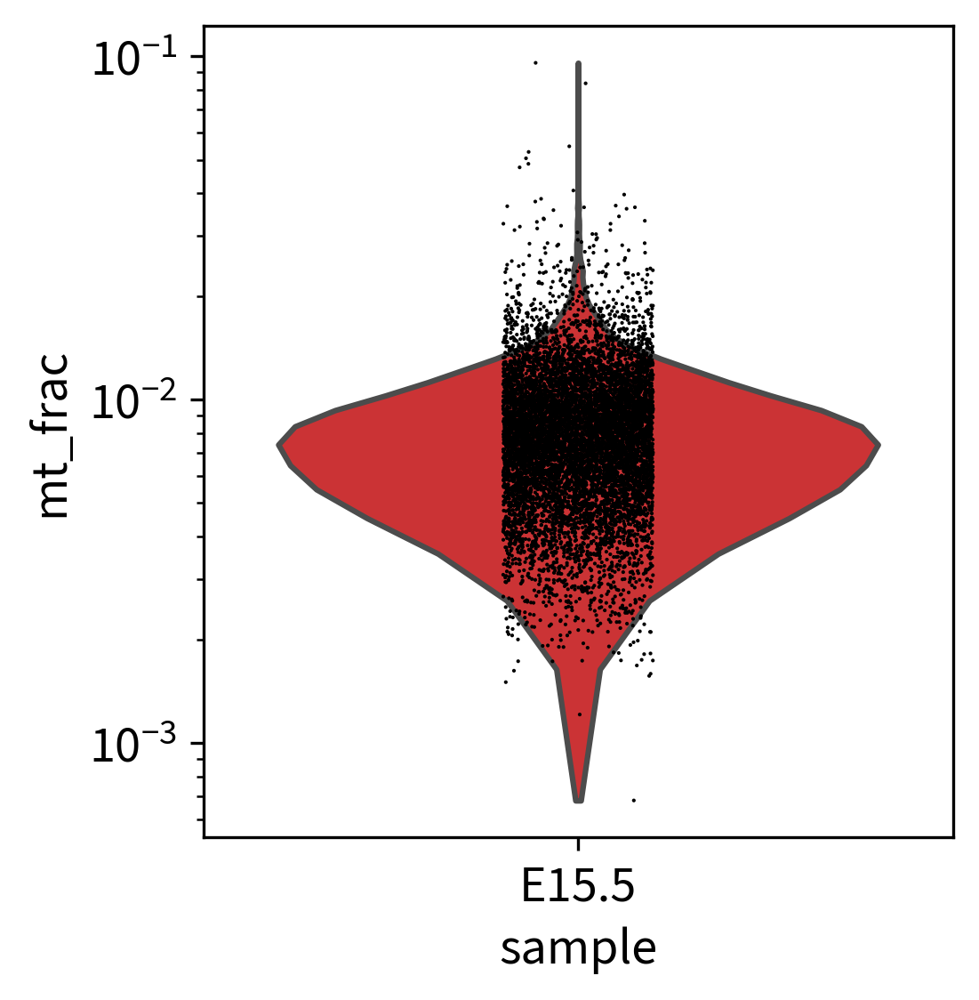

In [47]:
# Quality control - plot QC metrics
#Sample quality plots
sc.pl.violin(adata, 'n_counts', groupby='sample', log=True, cut=0, palette='Set1')
sc.pl.violin(adata, 'mt_frac', groupby='sample', palette='Set1')
sc.pl.violin(adata, 'mt_frac', groupby='sample', palette='Set1', log=True)

#### Mitochondrial Gene Fraction

##### High MT-Gene Fraction

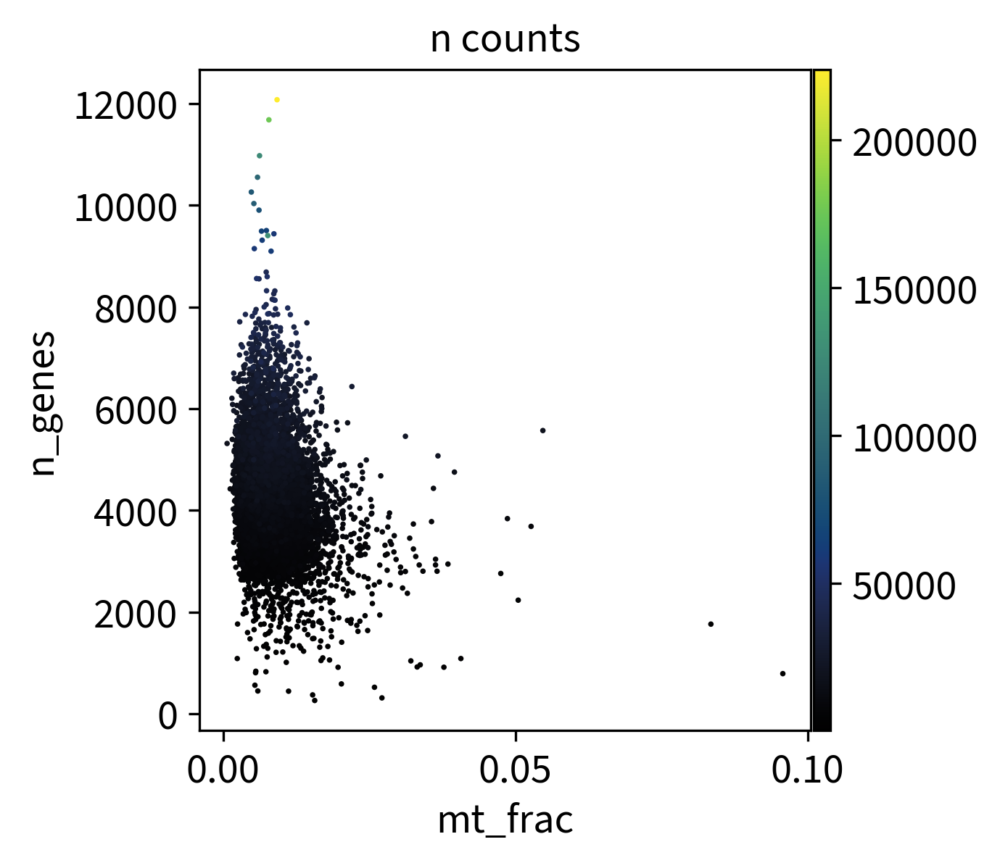

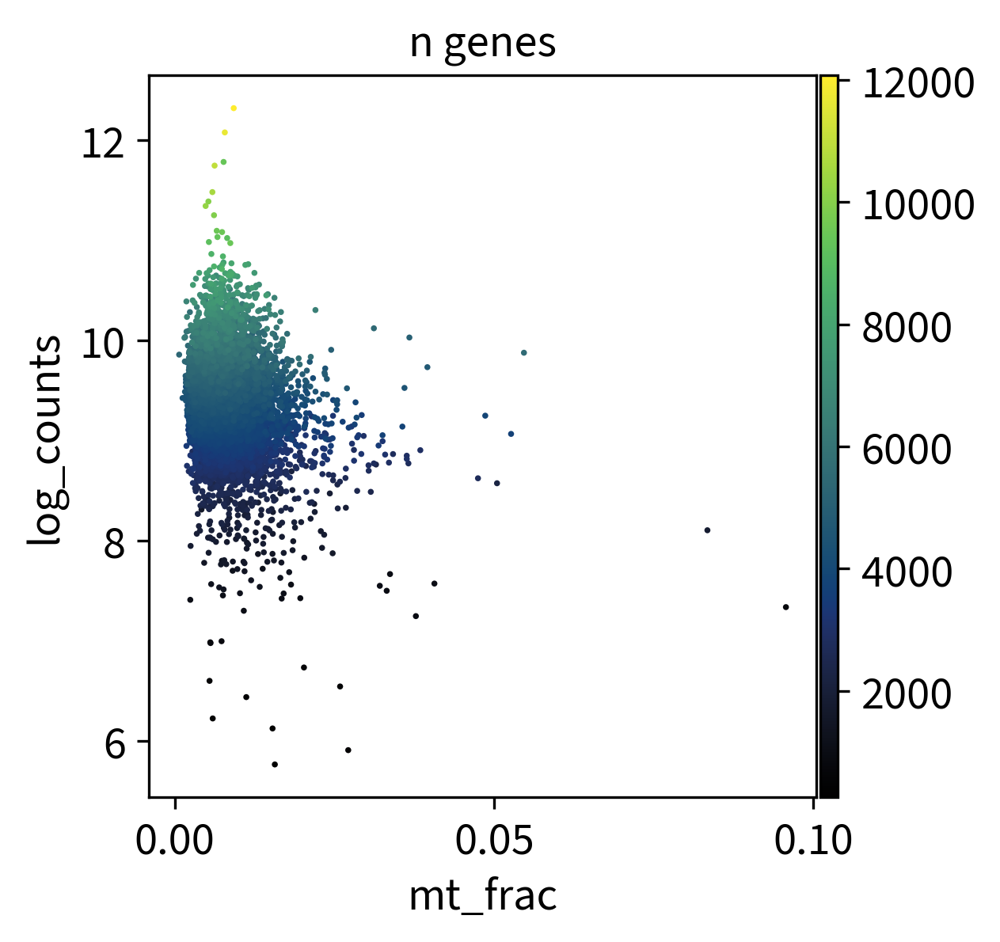

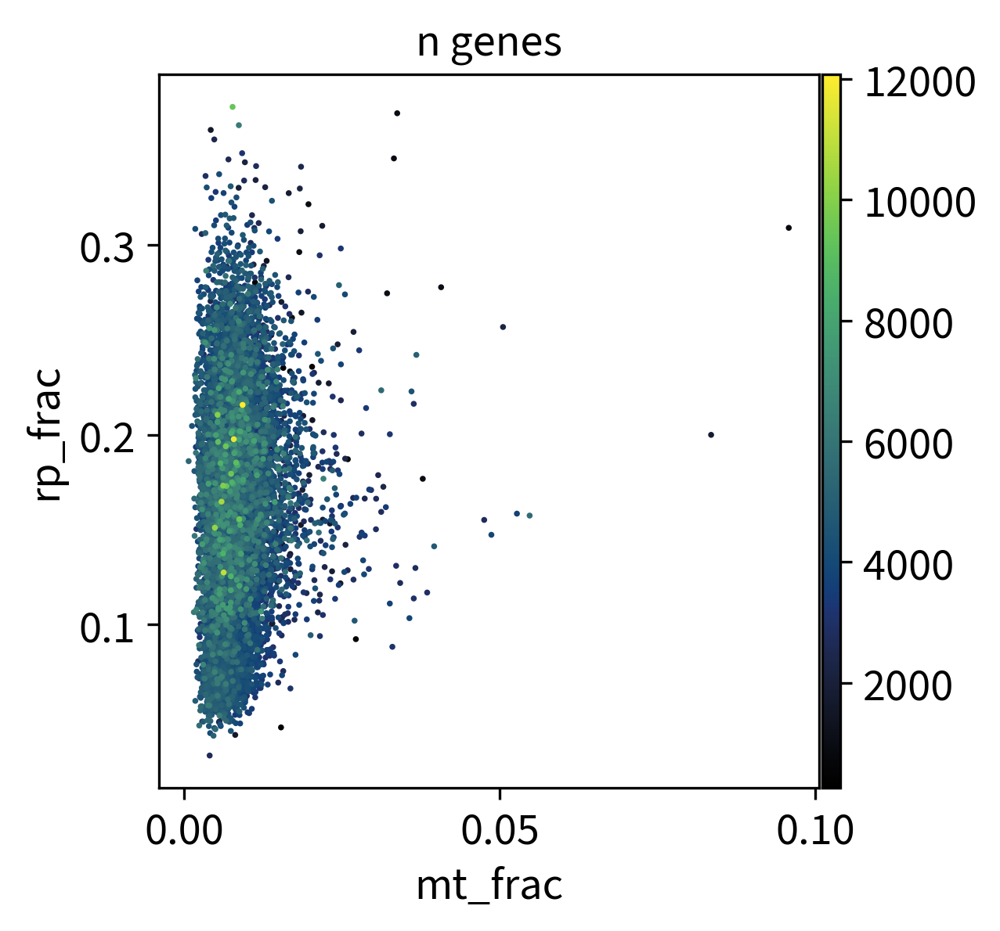

In [48]:
sc.pl.scatter(adata, 'mt_frac', 'n_genes', color='n_counts', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'mt_frac', 'log_counts', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'mt_frac', 'rp_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)

In [49]:
max_mito = 0.02

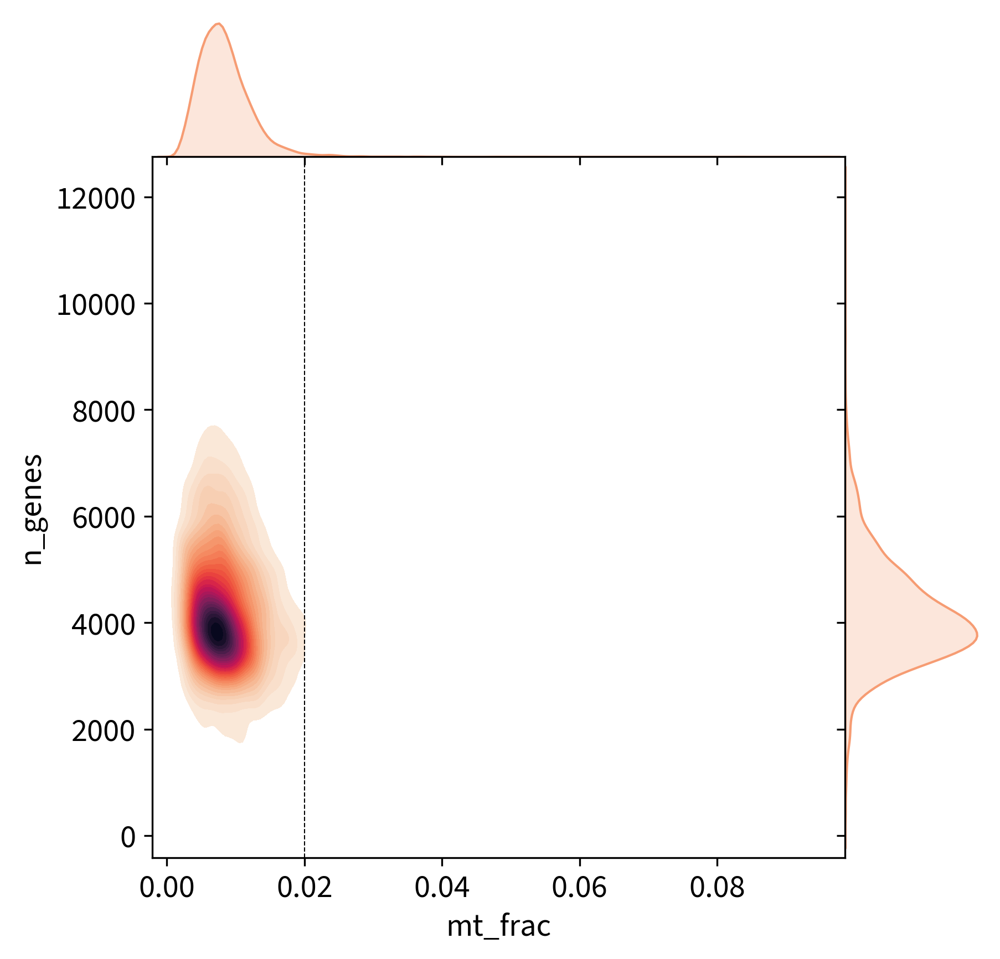

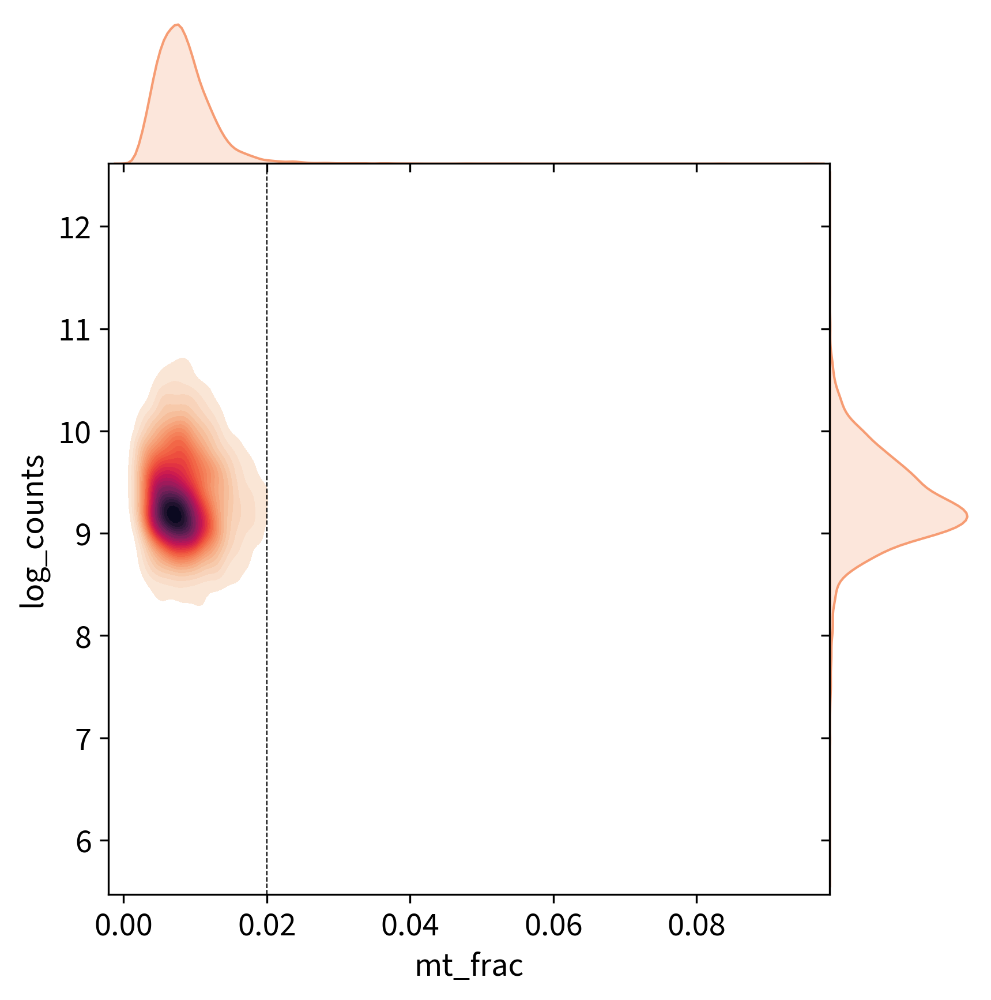

In [50]:
sb.jointplot(x=adata.obs['mt_frac'], y=adata.obs['n_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0).ax_joint.axvline(x=max_mito, ymin=0, ymax=max(adata.obs['n_genes']), color="black", lw=0.5).set_linestyle("--")

sb.jointplot(x=adata.obs['mt_frac'], y=adata.obs['log_counts'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0).ax_joint.axvline(max_mito, 0, max(adata.obs['n_genes']), color="black", lw=0.5).set_linestyle("--")

In [51]:
adata.obs['high_mt_frac']=pd.Categorical(list(map(str,list(adata.obs['mt_frac'] > max_mito))))

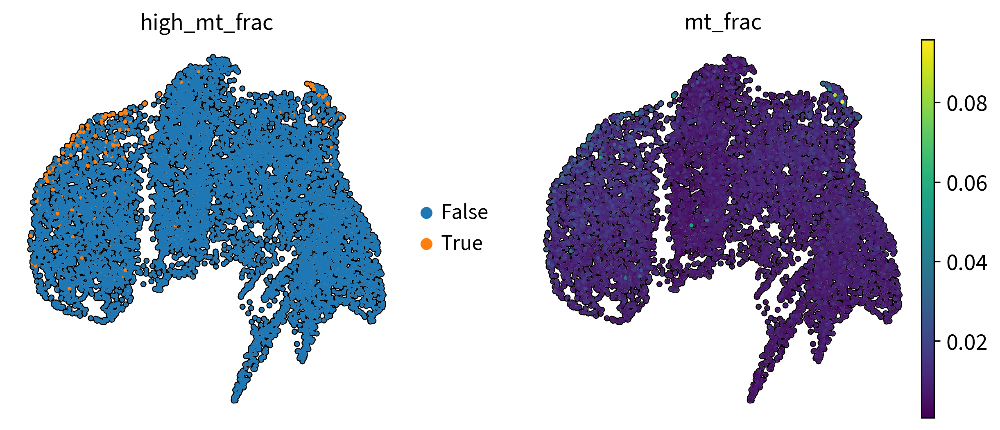

In [52]:
sc.pl.umap(adata, color=['high_mt_frac','mt_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0))

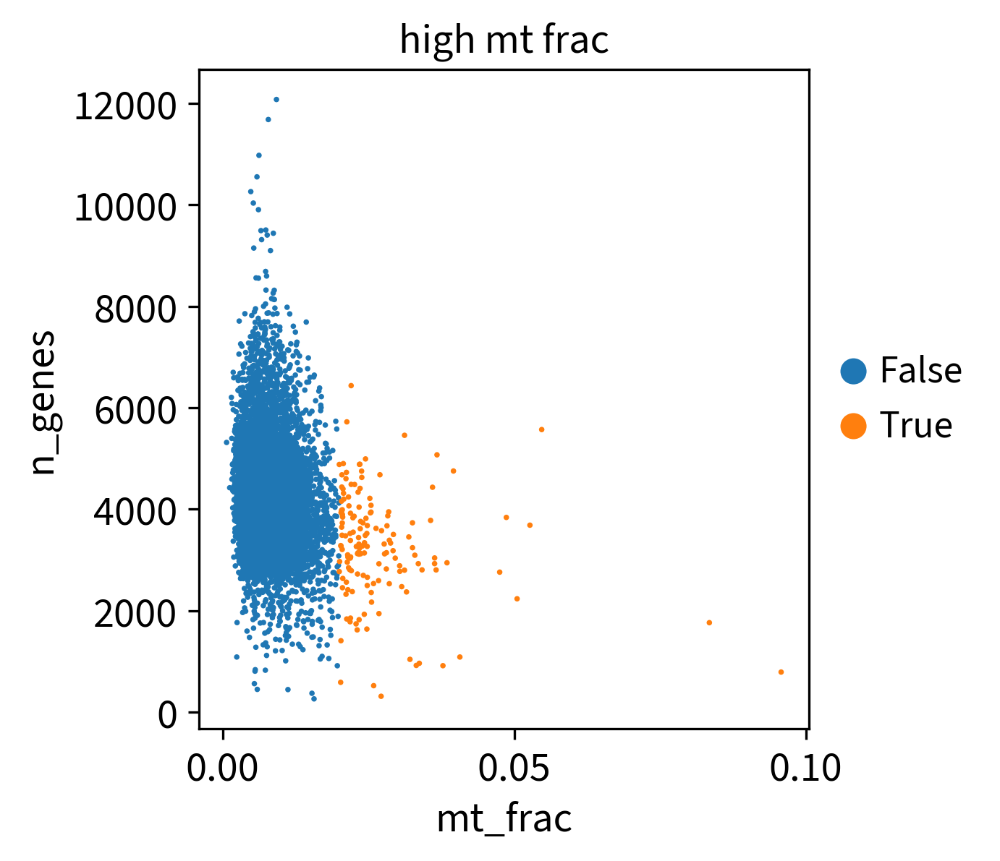

In [53]:
sc.pl.scatter(adata, 'mt_frac', 'n_genes', color='high_mt_frac', color_map=michi_bk_bl_gn_yl)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


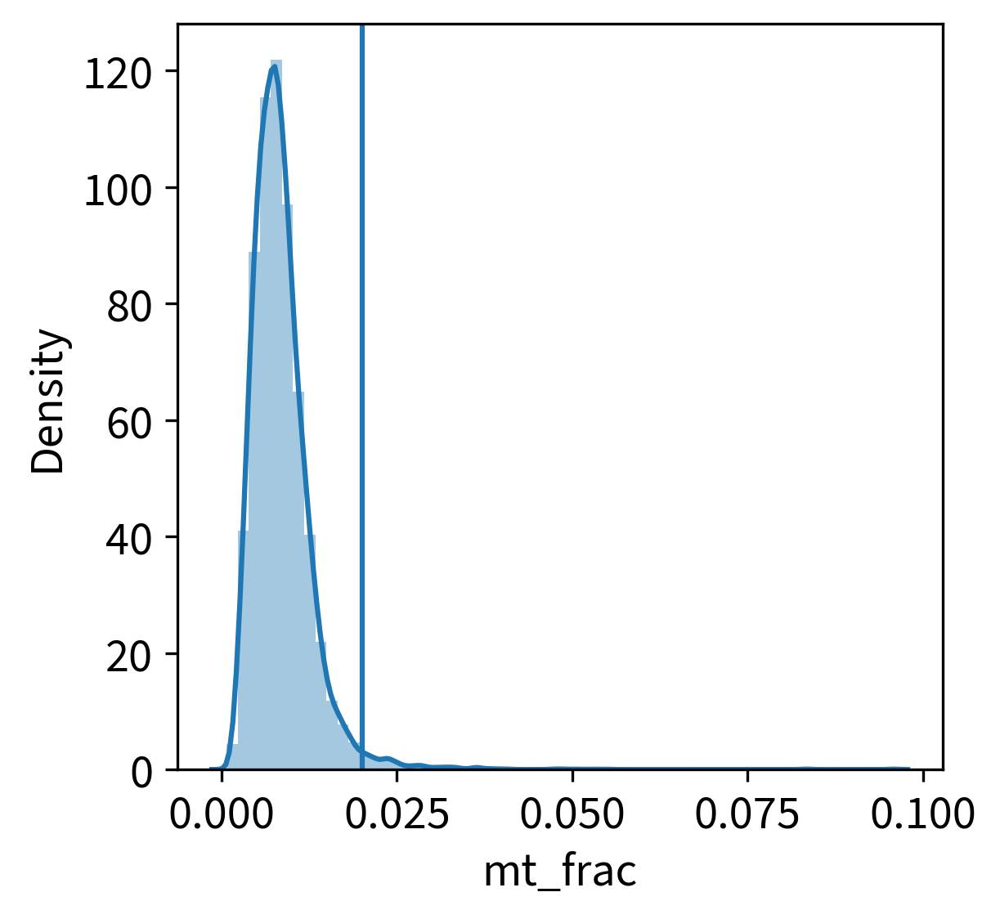

In [54]:
#Thresholding decision: MT-gene fraction
sb.distplot(adata.obs['mt_frac'], kde=True, bins=60)
plt.axvline(max_mito, 0, 1)

#### Ribosomal Gene Fraction

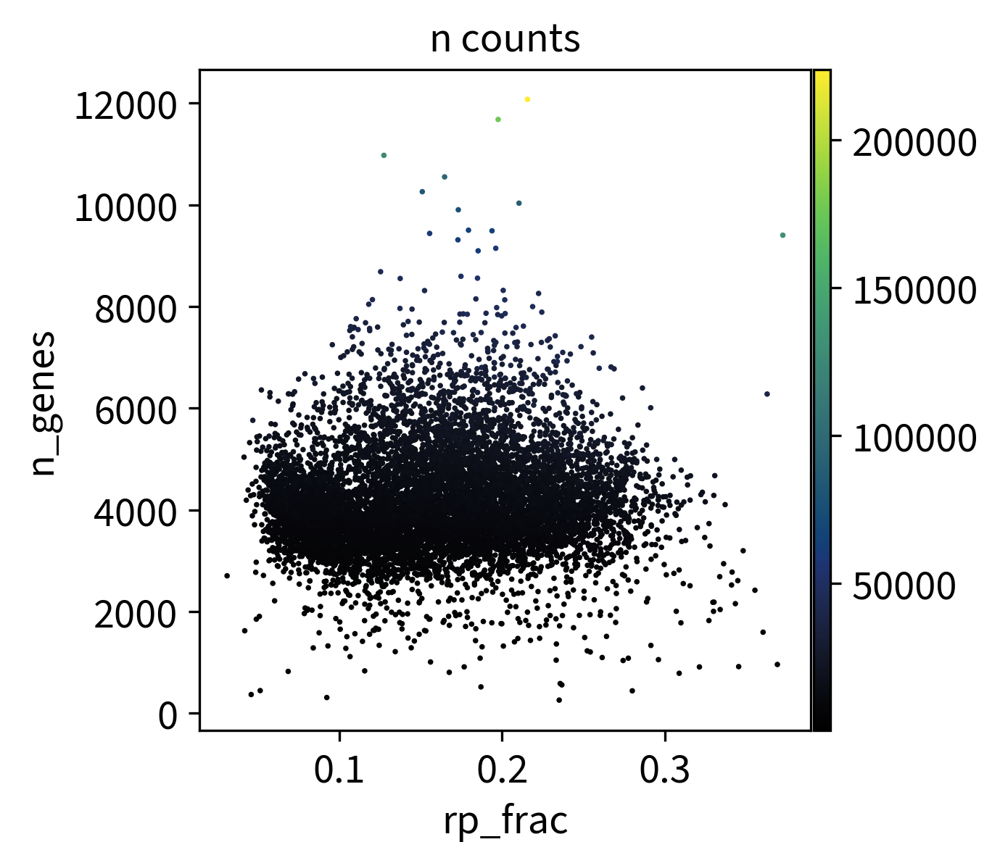

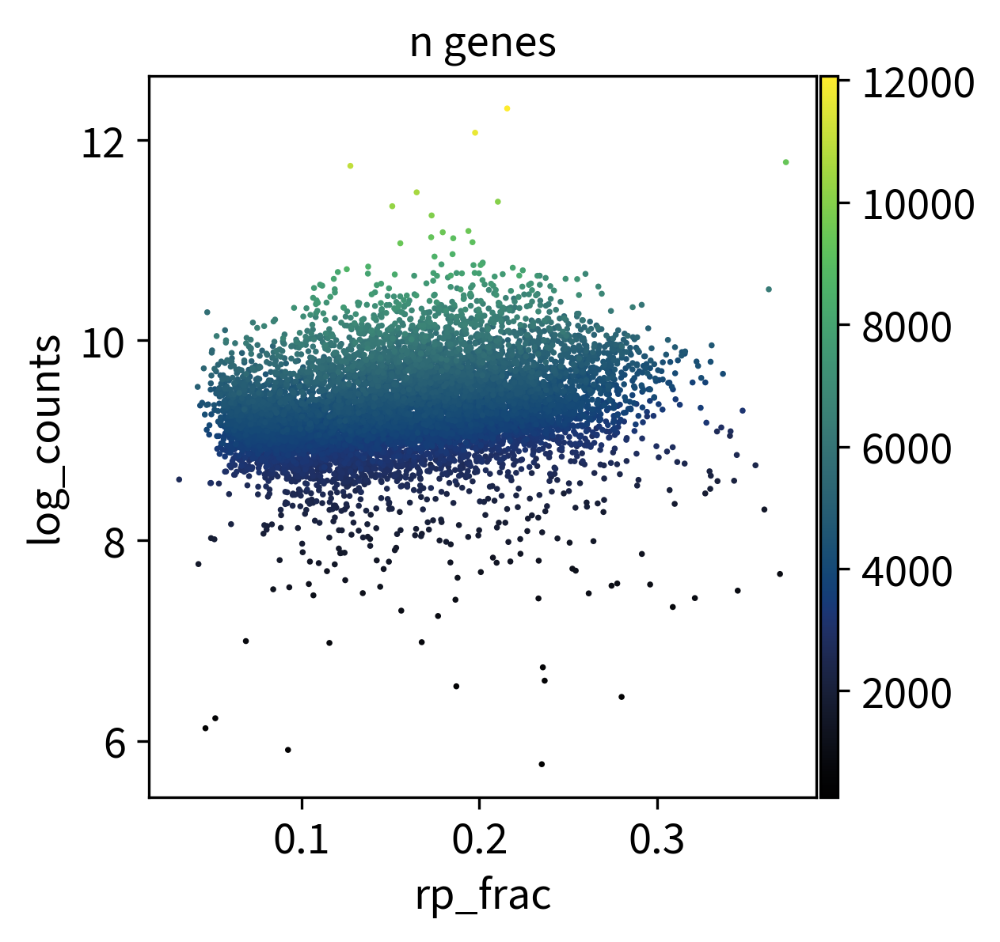

In [55]:
sc.pl.scatter(adata, 'rp_frac', 'n_genes', color='n_counts', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'rp_frac', 'log_counts', color='n_genes', color_map=michi_bk_bl_gn_yl)

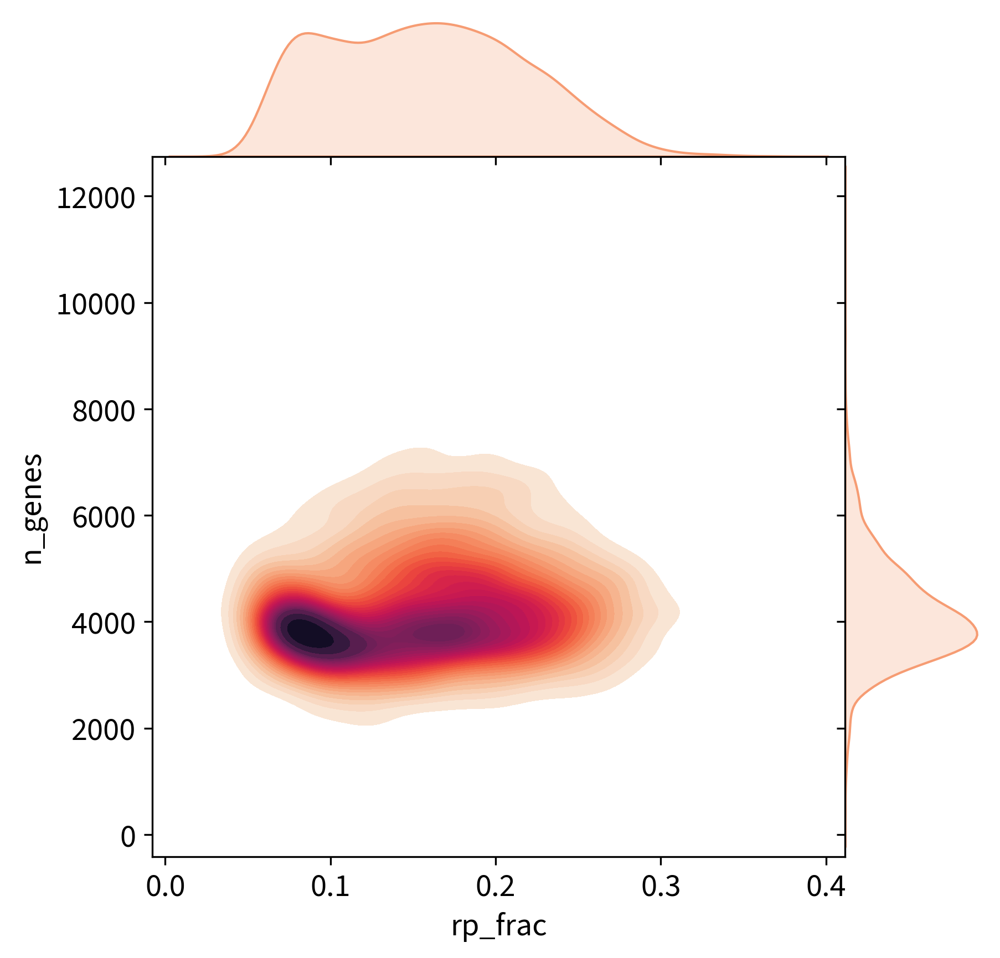

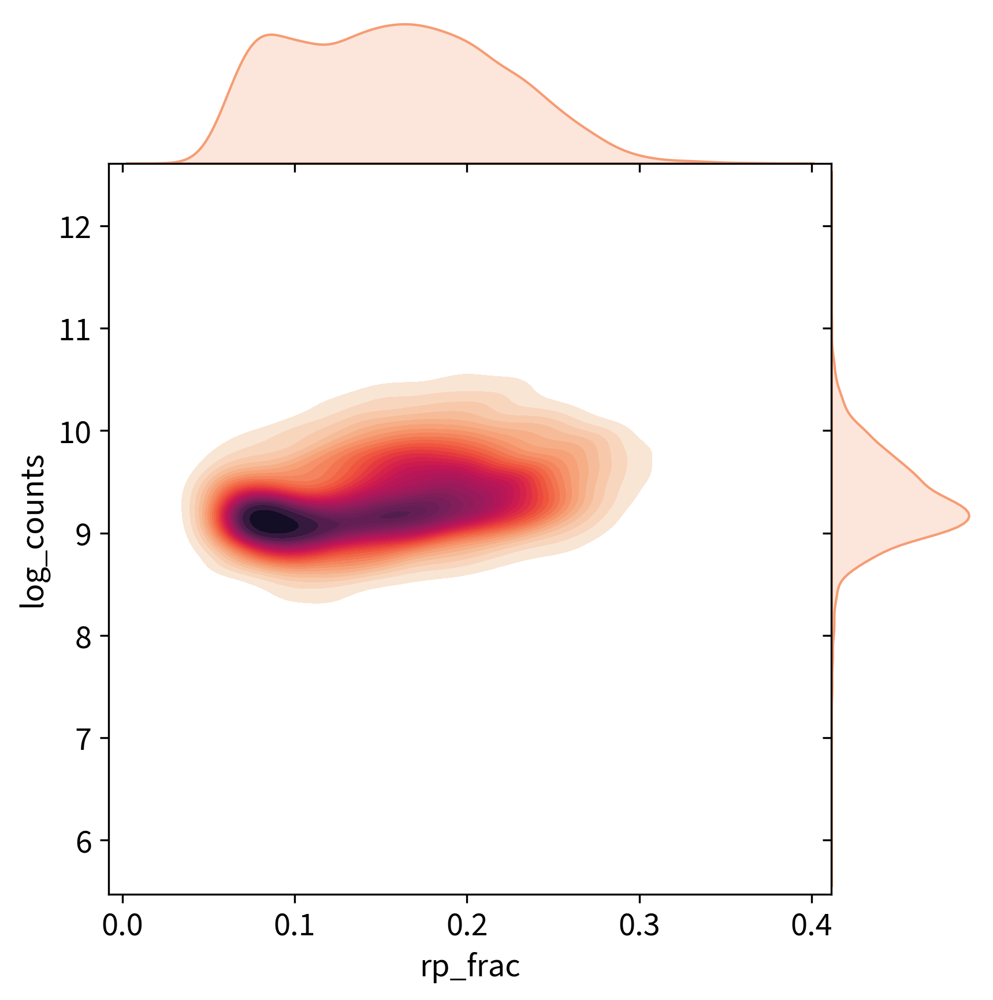

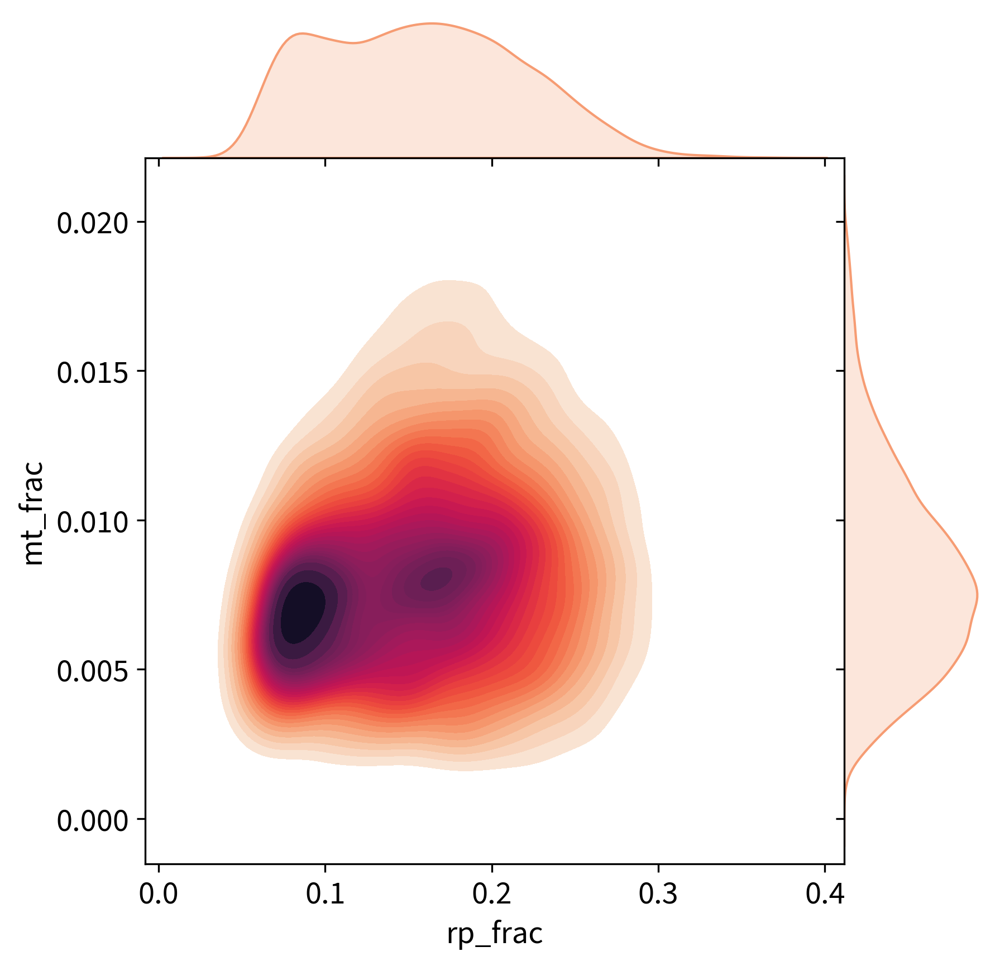

In [56]:
sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['rp_frac'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['n_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['rp_frac'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['log_counts'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['rp_frac'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['mt_frac'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

#### Ambient Gene Fraction

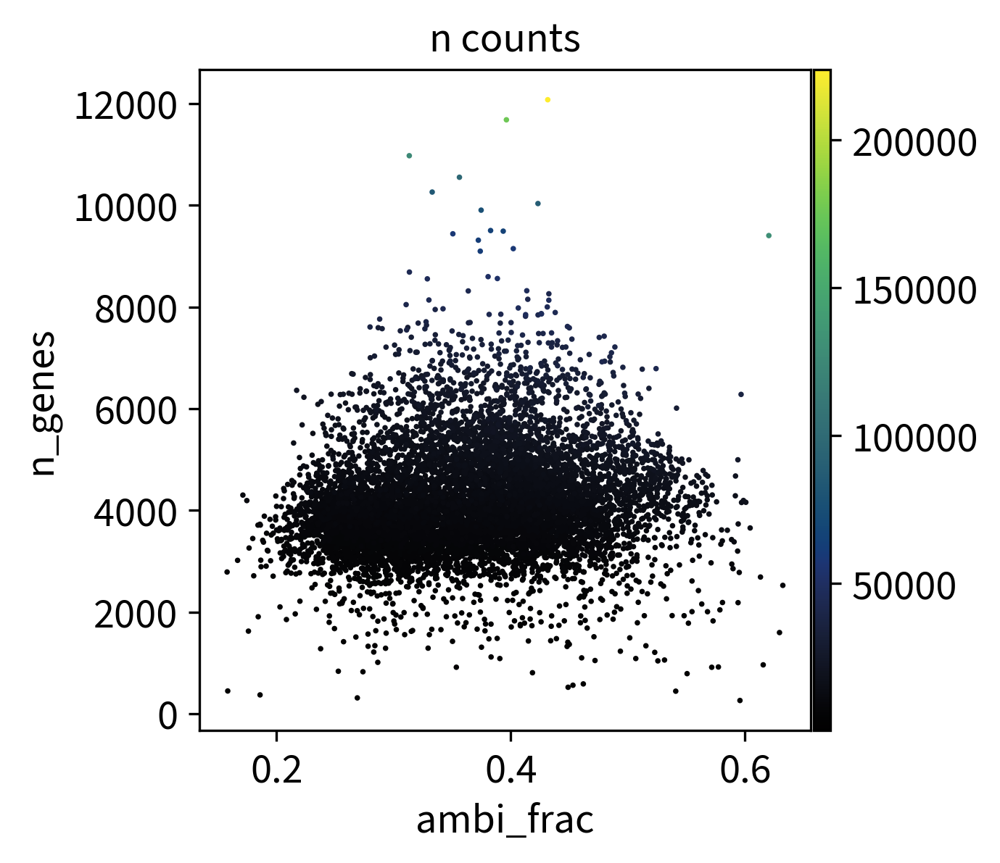

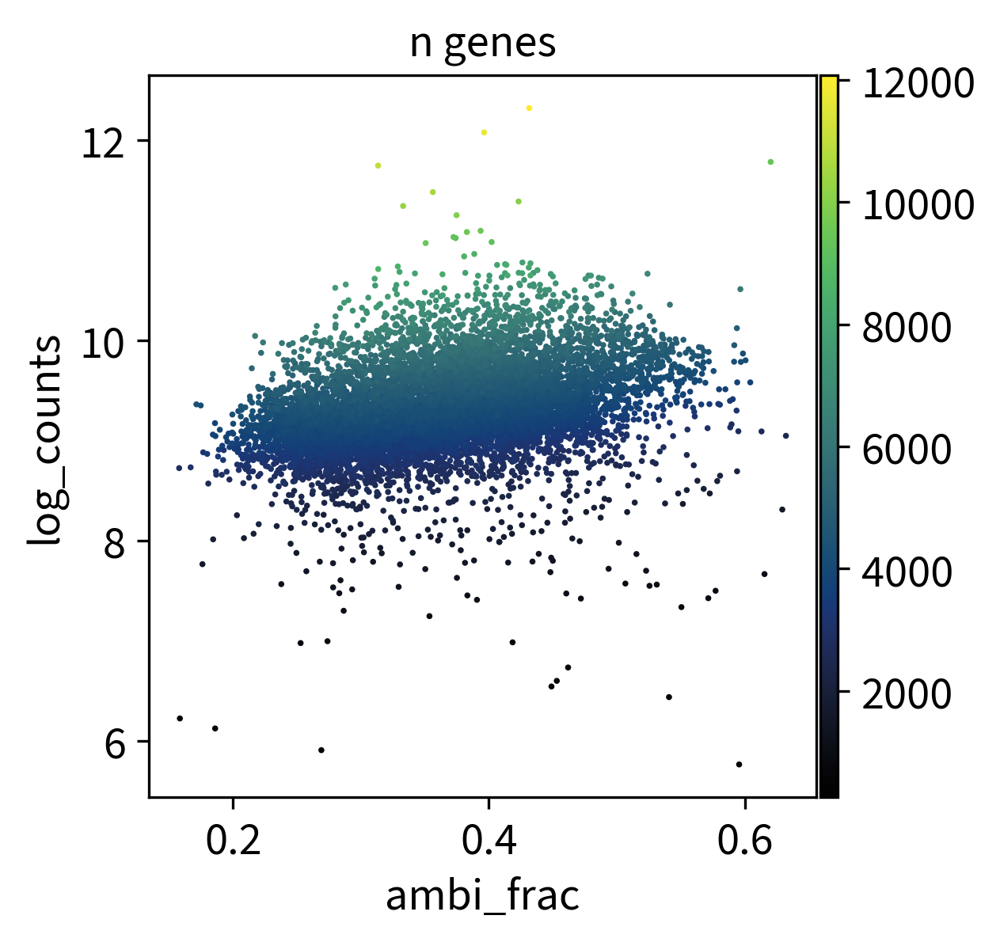

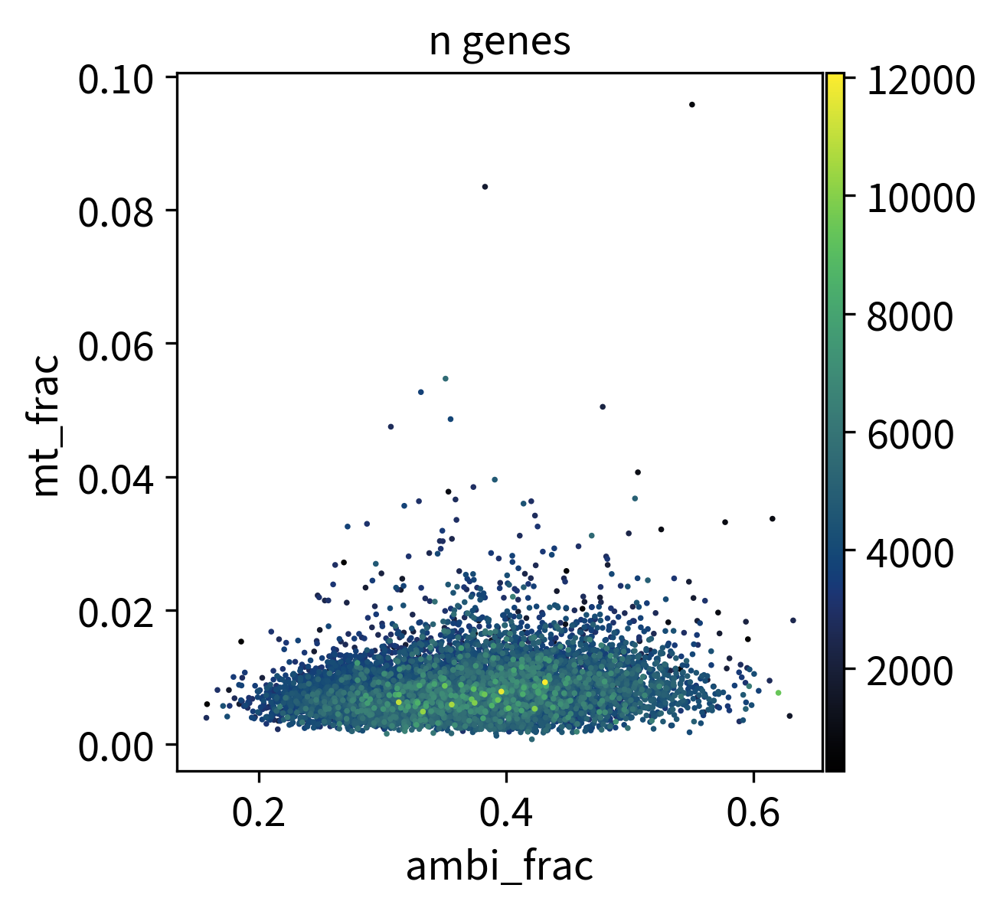

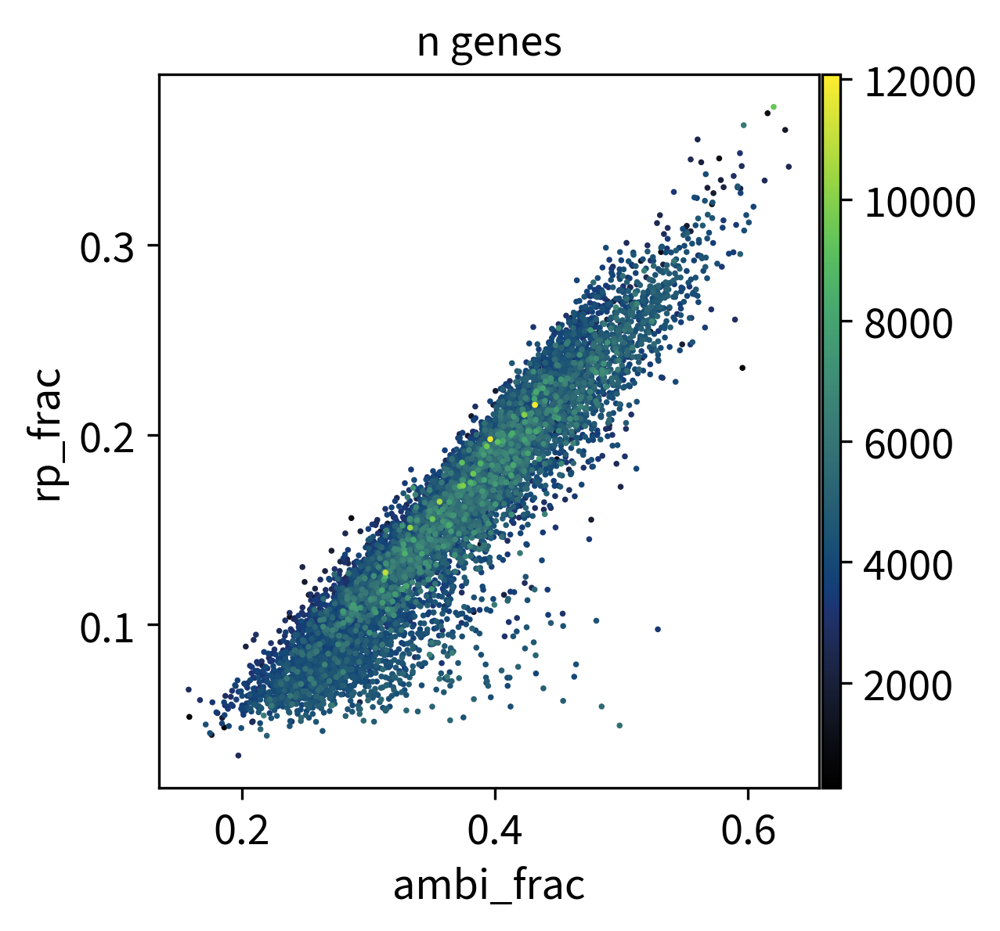

In [57]:
sc.pl.scatter(adata, 'ambi_frac', 'n_genes', color='n_counts', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'ambi_frac', 'log_counts', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'ambi_frac', 'mt_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'ambi_frac', 'rp_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)

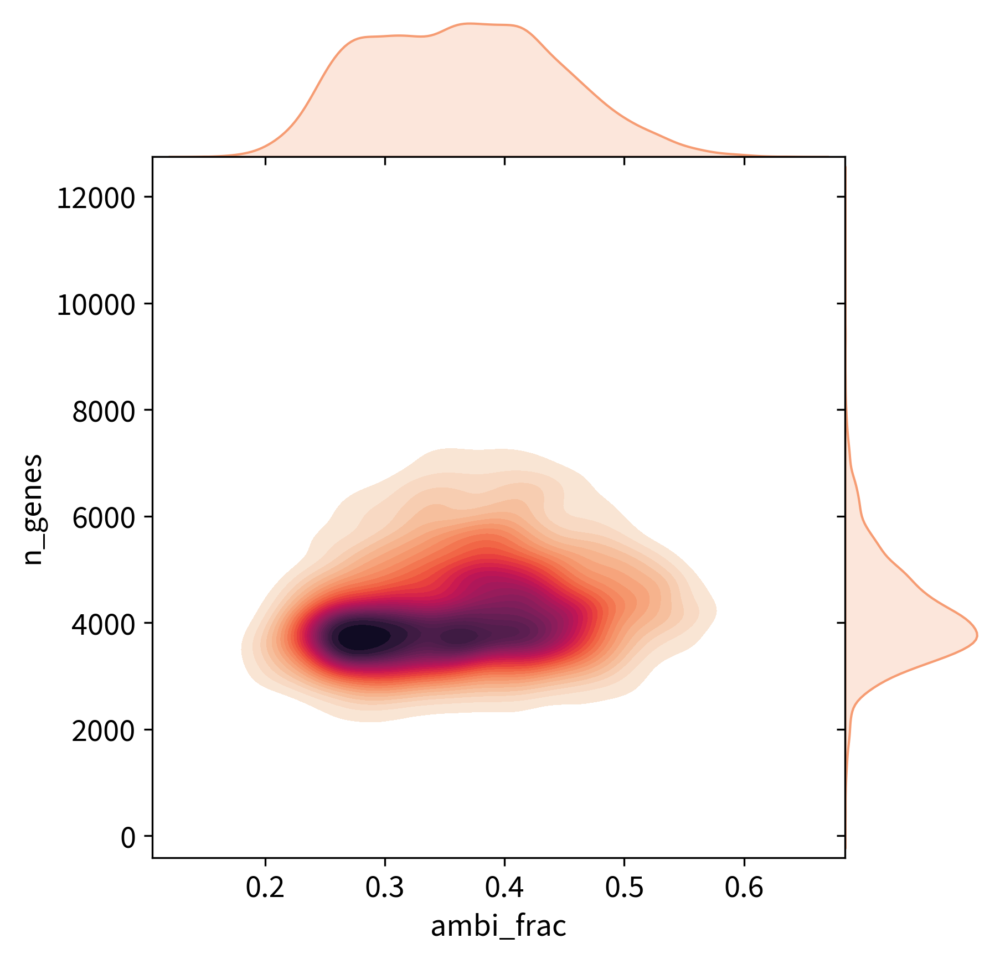

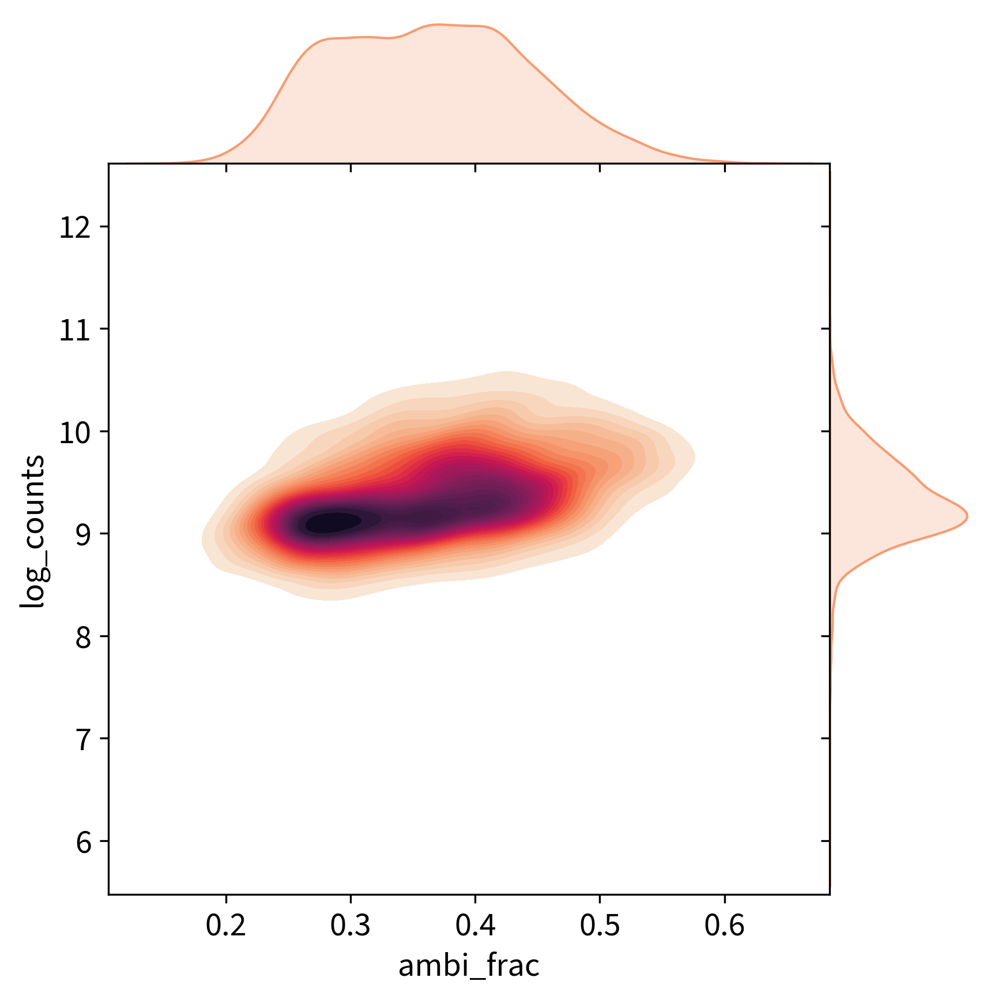

In [58]:
sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['ambi_frac'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['n_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['ambi_frac'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['log_counts'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

#### Cell Probabilities

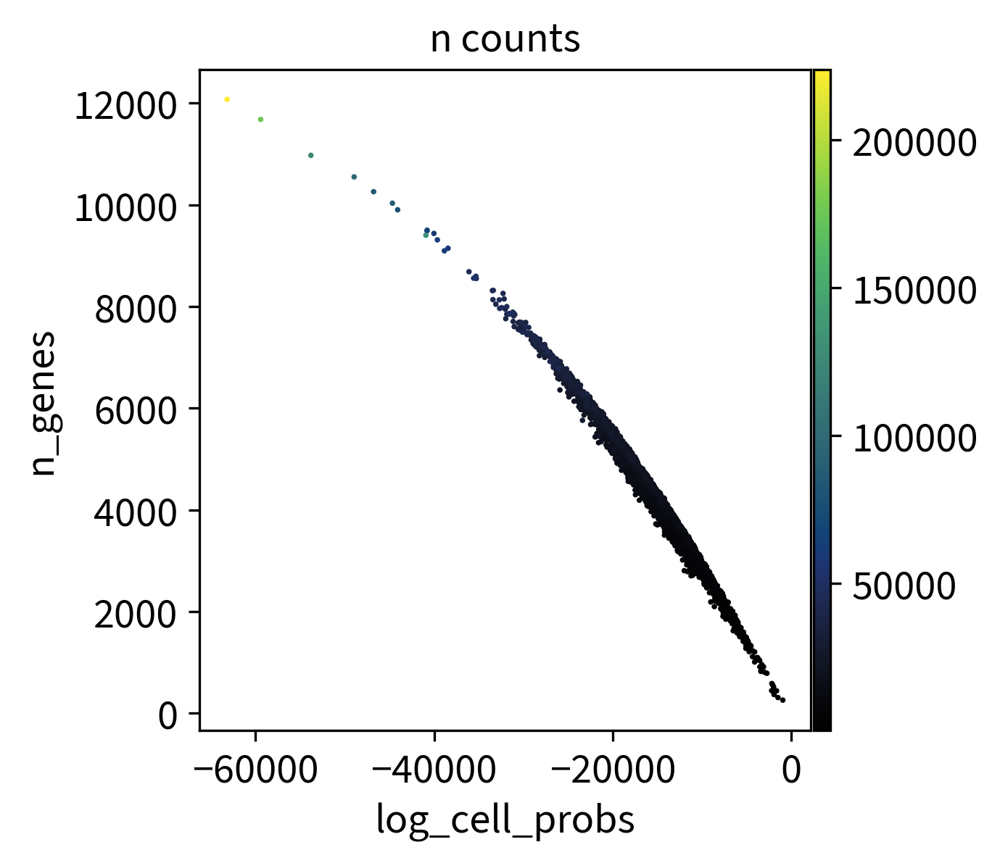

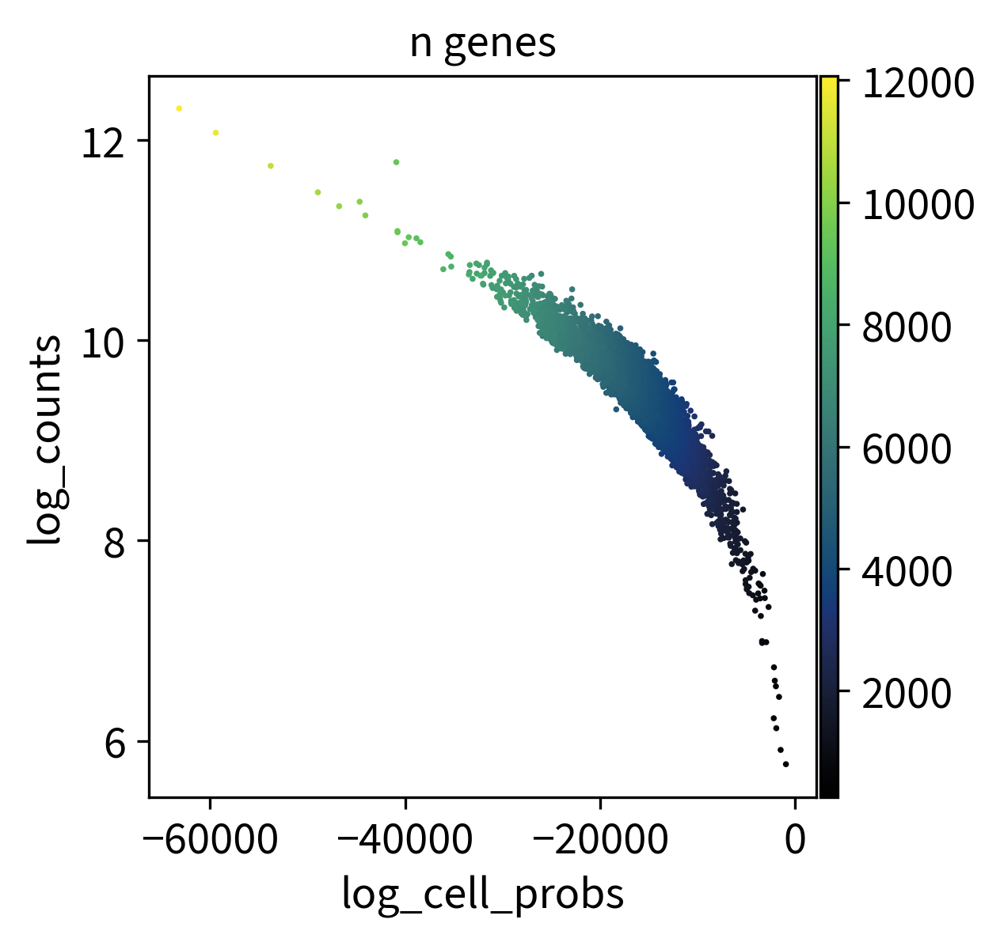

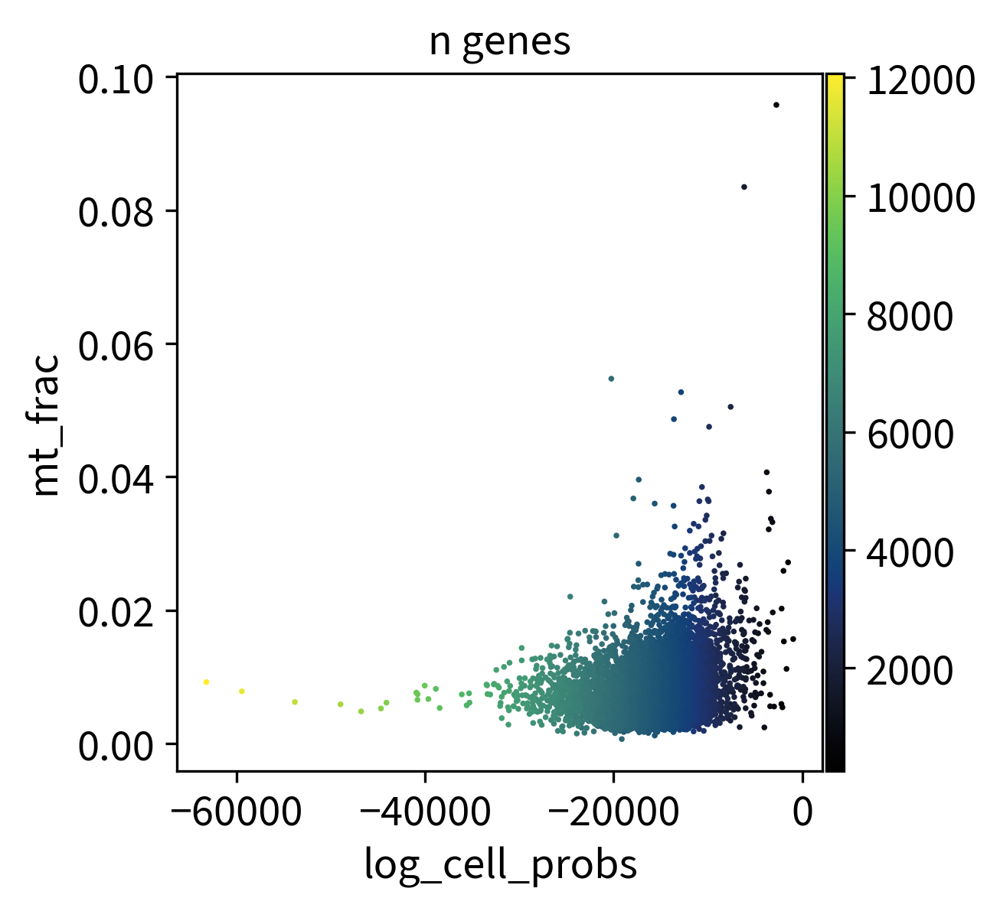

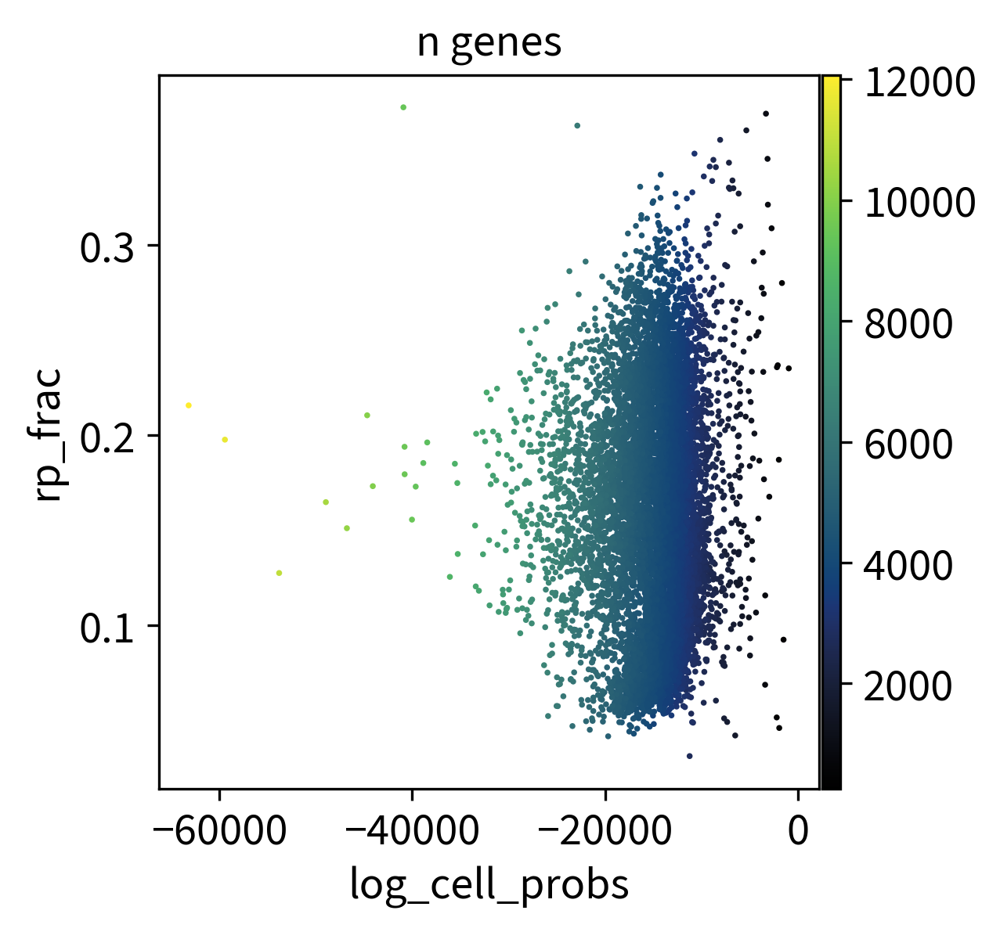

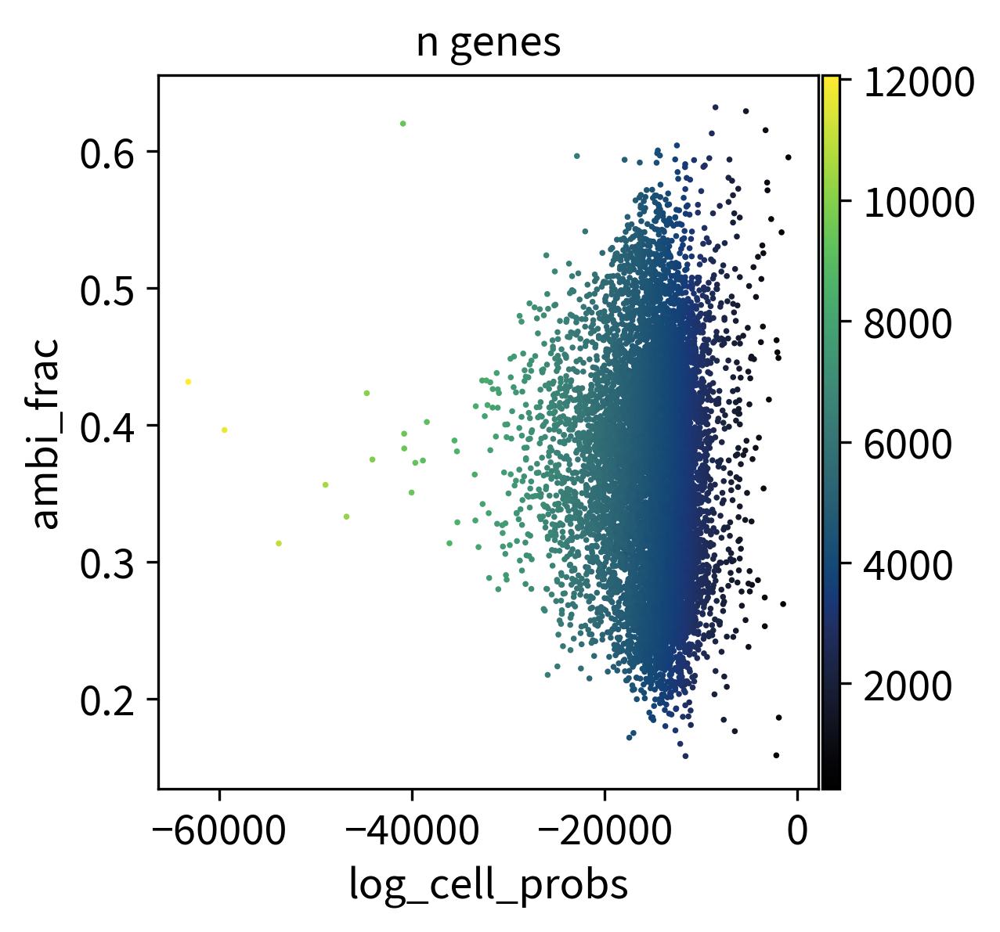

In [59]:
sc.pl.scatter(adata, 'log_cell_probs', 'n_genes', color='n_counts', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'log_cell_probs', 'log_counts', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'log_cell_probs', 'mt_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'log_cell_probs', 'rp_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(adata, 'log_cell_probs', 'ambi_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)

#### Counts

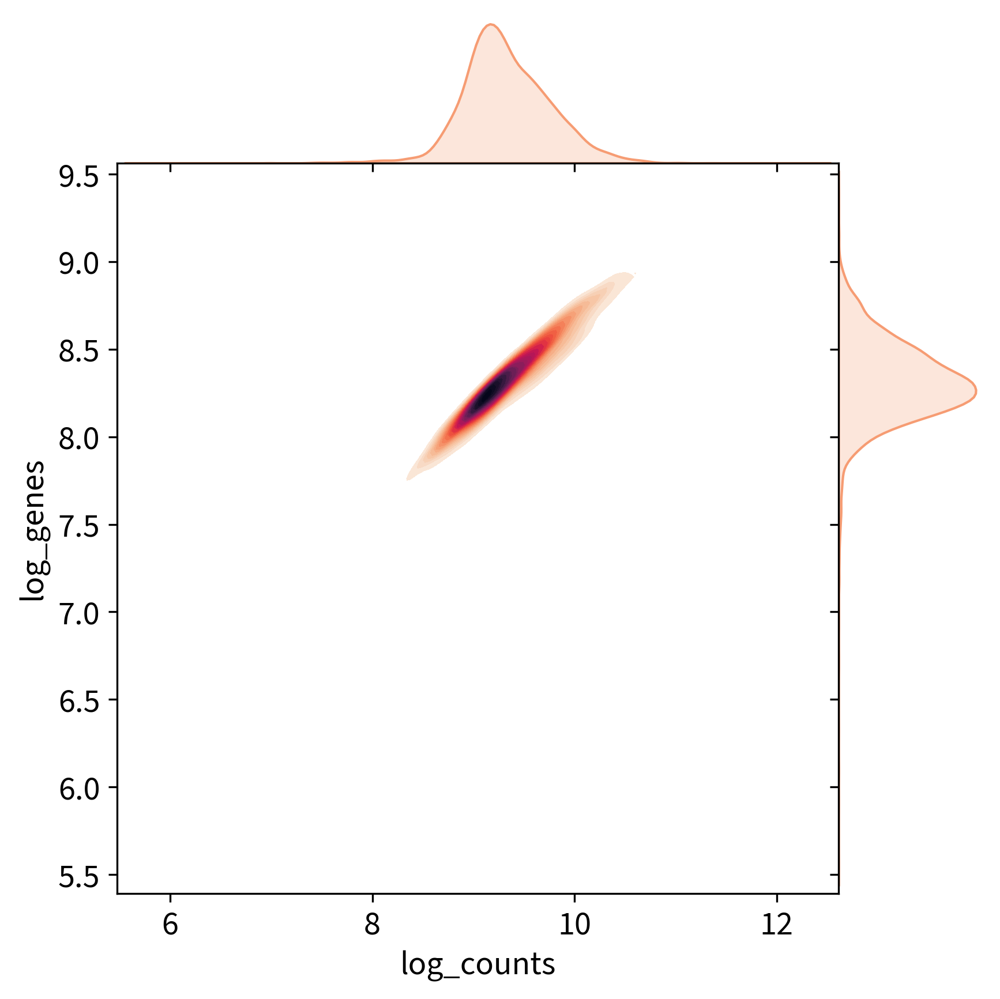

In [60]:
sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['log_counts'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['log_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='n_counts', ylabel='Density'>

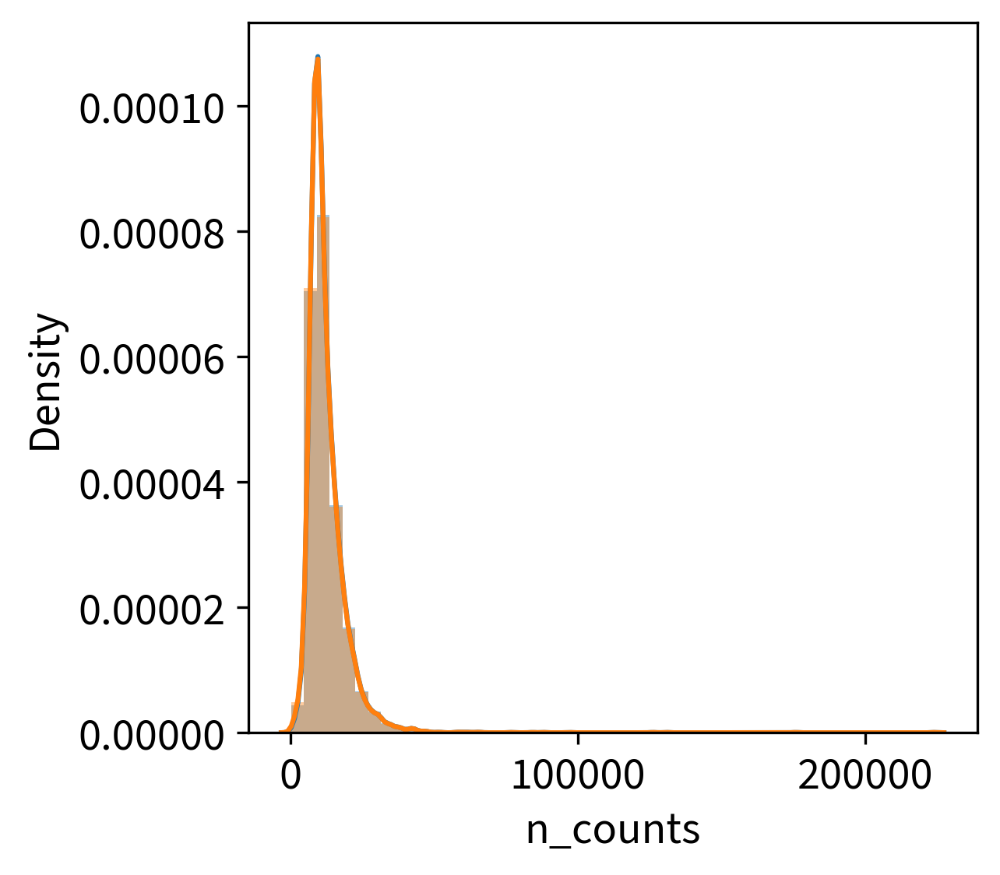

In [61]:
#Thresholding decision: counts
sb.distplot(adata[(adata.obs['mt_frac'] < max_mito)].obs['n_counts'], kde=True)
sb.distplot(adata.obs['n_counts'], kde=True)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


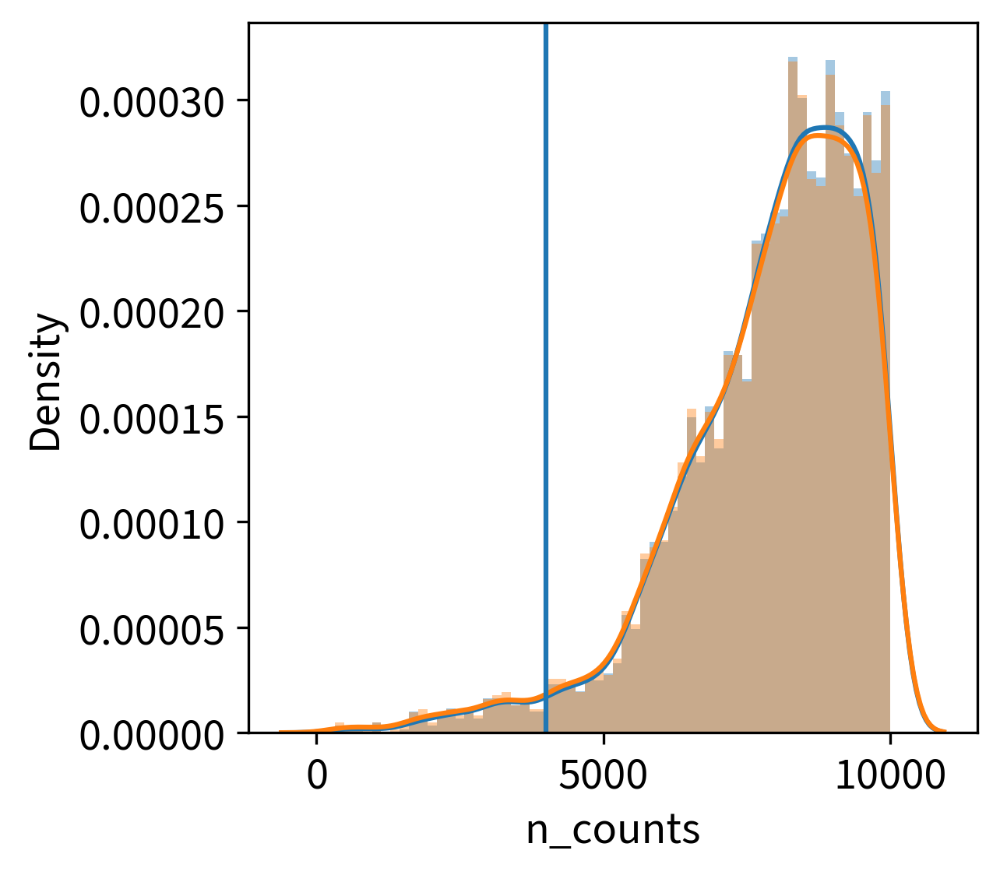

In [62]:
min_counts = 4000
sb.distplot(adata.obs['n_counts'][(adata.obs['n_counts']<10000) & (adata.obs['mt_frac'] < max_mito)], kde=True, bins=60)
sb.distplot(adata.obs['n_counts'][(adata.obs['n_counts']<10000)], kde=True, bins=60)
plt.axvline(min_counts, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


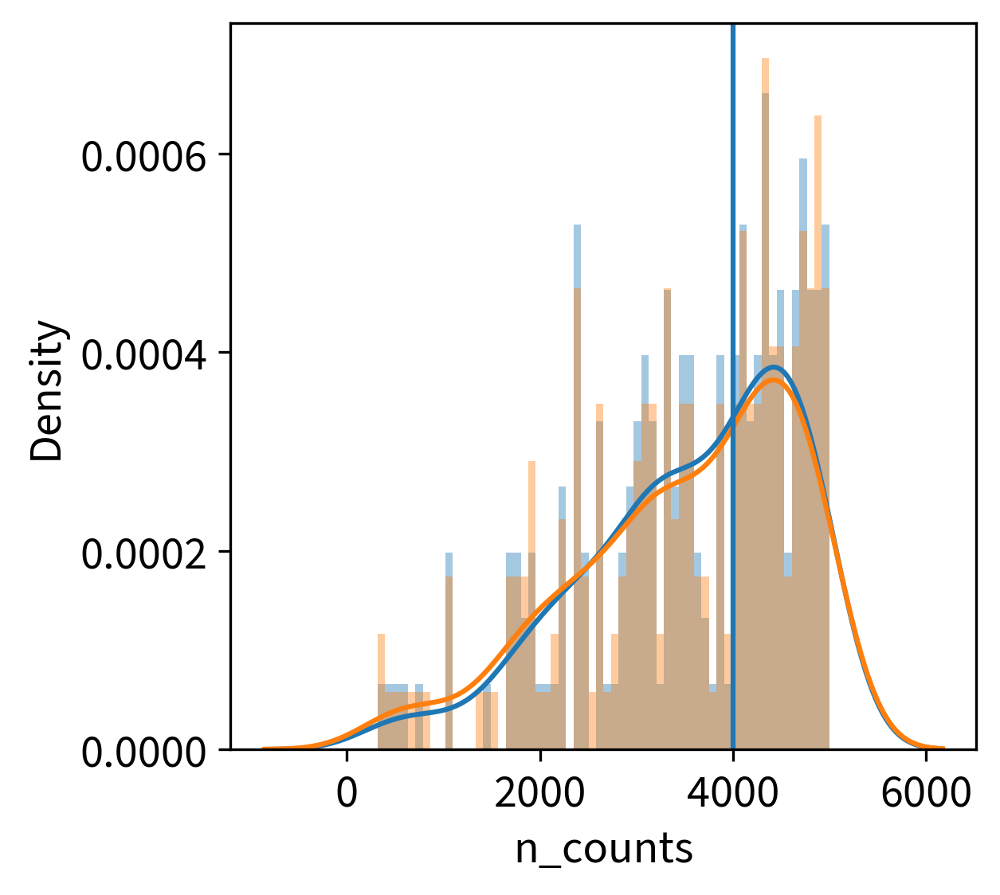

In [63]:
sb.distplot(adata.obs['n_counts'][(adata.obs['n_counts']>100) & (adata.obs['n_counts']<5000) & (adata.obs['mt_frac'] < max_mito)], kde=True, bins=60)
sb.distplot(adata.obs['n_counts'][(adata.obs['n_counts']>100) & (adata.obs['n_counts']<5000)], kde=True, bins=60)
plt.axvline(min_counts, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


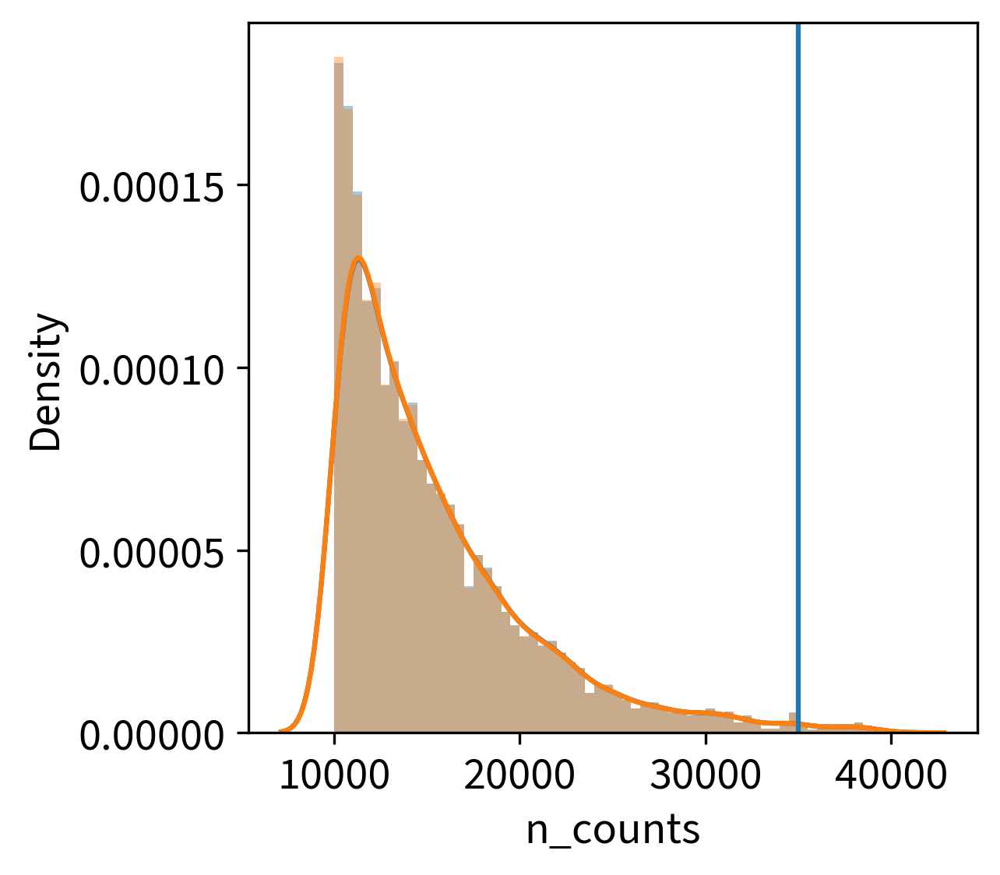

In [64]:
max_counts = 35000
sb.distplot(adata.obs['n_counts'][(adata.obs['n_counts']>10000) & (adata.obs['n_counts']<40000) & (adata.obs['mt_frac'] < max_mito)], kde=True, bins=60)
sb.distplot(adata.obs['n_counts'][(adata.obs['n_counts']>10000) & (adata.obs['n_counts']<40000)], kde=True, bins=60)
plt.axvline(max_counts, 0, 1)

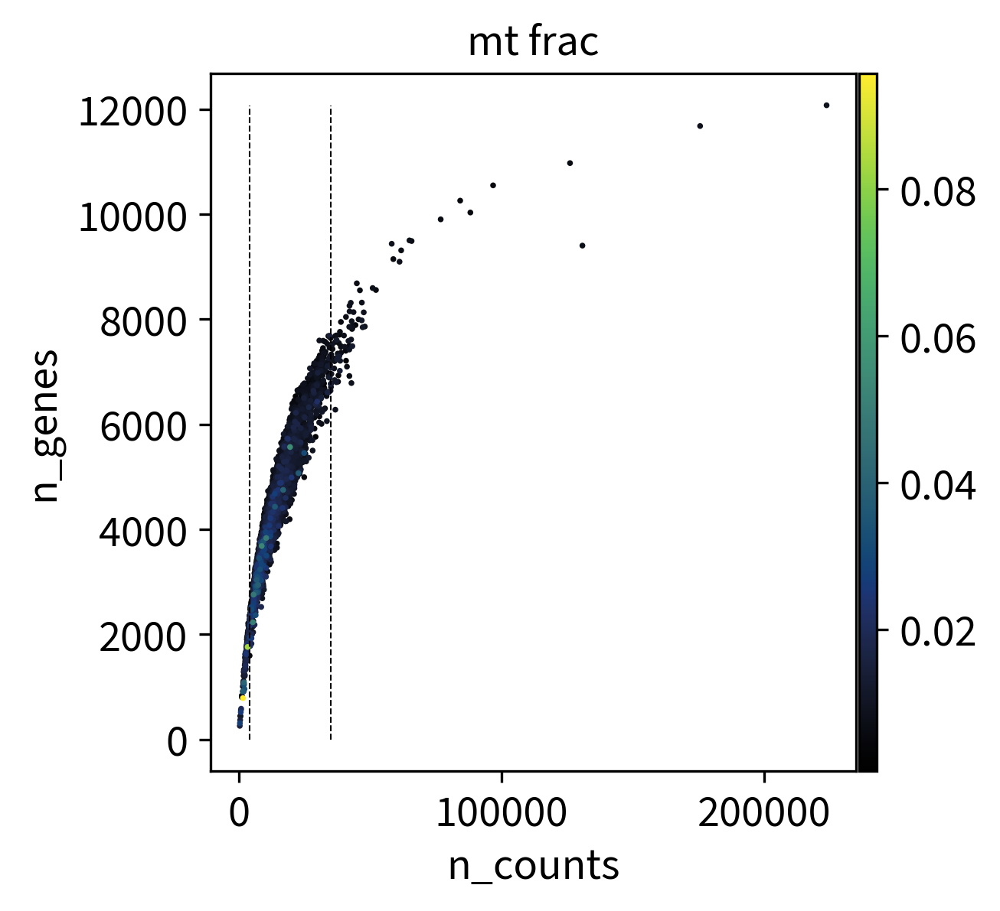

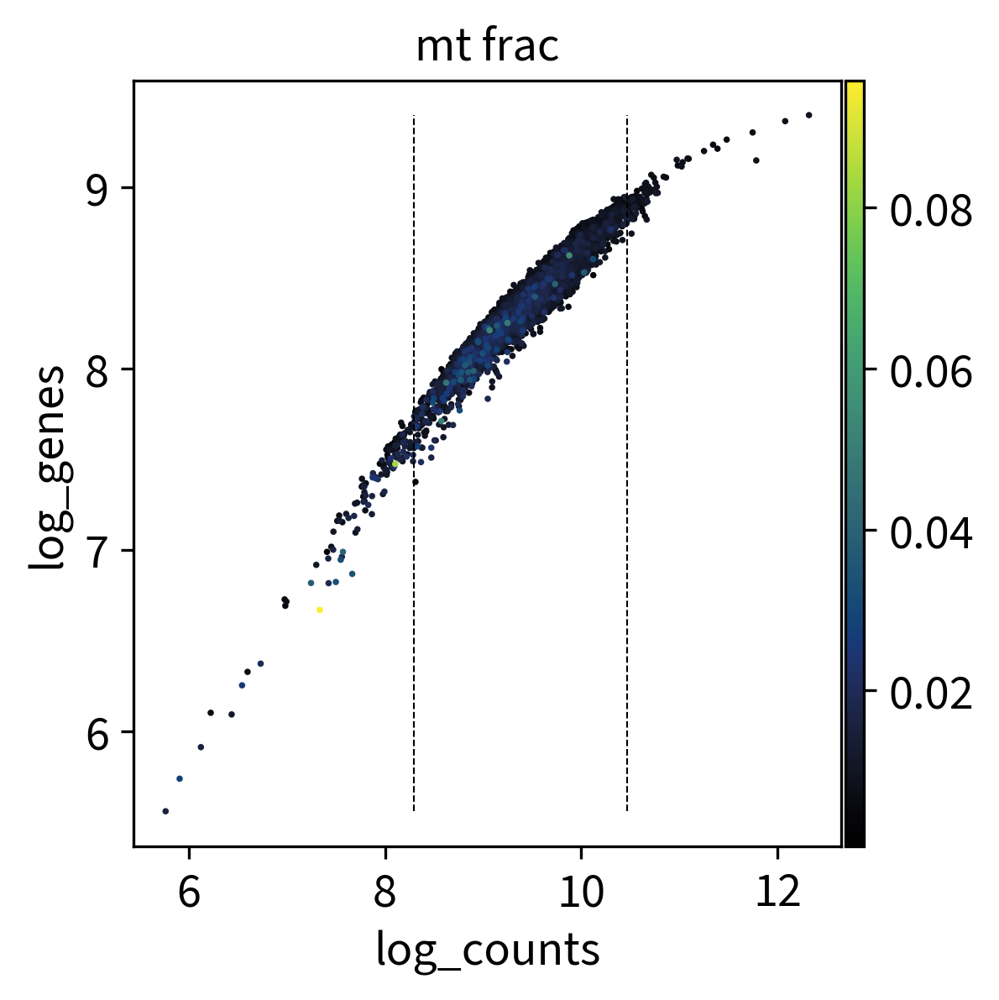

In [65]:
sc.pl.scatter(adata, 'n_counts', 'n_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[min_counts, max_counts], ymin=[0,0], ymax=[max(adata.obs['n_genes']),max(adata.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")
sc.pl.scatter(adata, 'log_counts', 'log_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(adata.obs['n_genes'])),np.log(min(adata.obs['n_genes']))], ymax=[np.log(max(adata.obs['n_genes'])),np.log(max(adata.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")

#### Genes

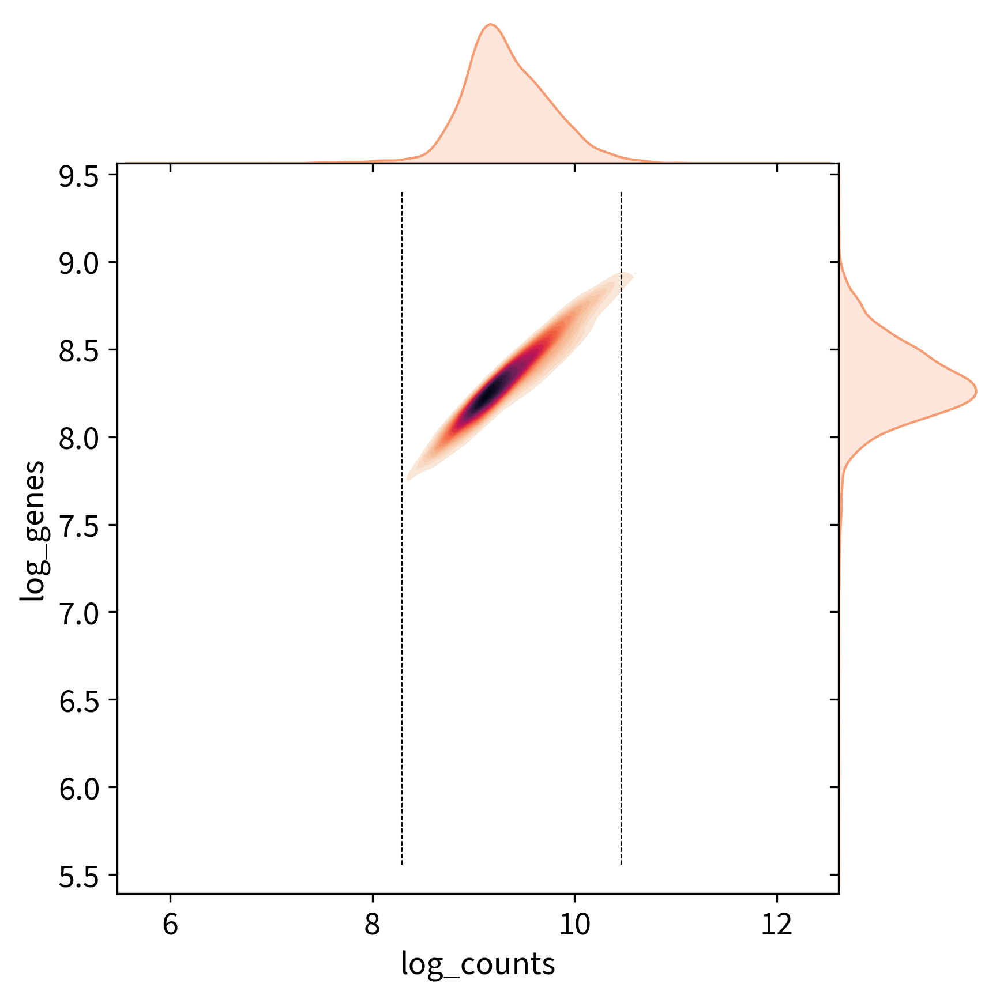

In [66]:
sb.jointplot(x=adata[(adata.obs['mt_frac'] < max_mito)].obs['log_counts'], y=adata[(adata.obs['mt_frac'] < max_mito)].obs['log_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0).ax_joint.vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(adata.obs['n_genes'])),np.log(min(adata.obs['n_genes']))], ymax=[np.log(max(adata.obs['n_genes'])),np.log(max(adata.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a

<AxesSubplot:xlabel='n_genes', ylabel='Density'>

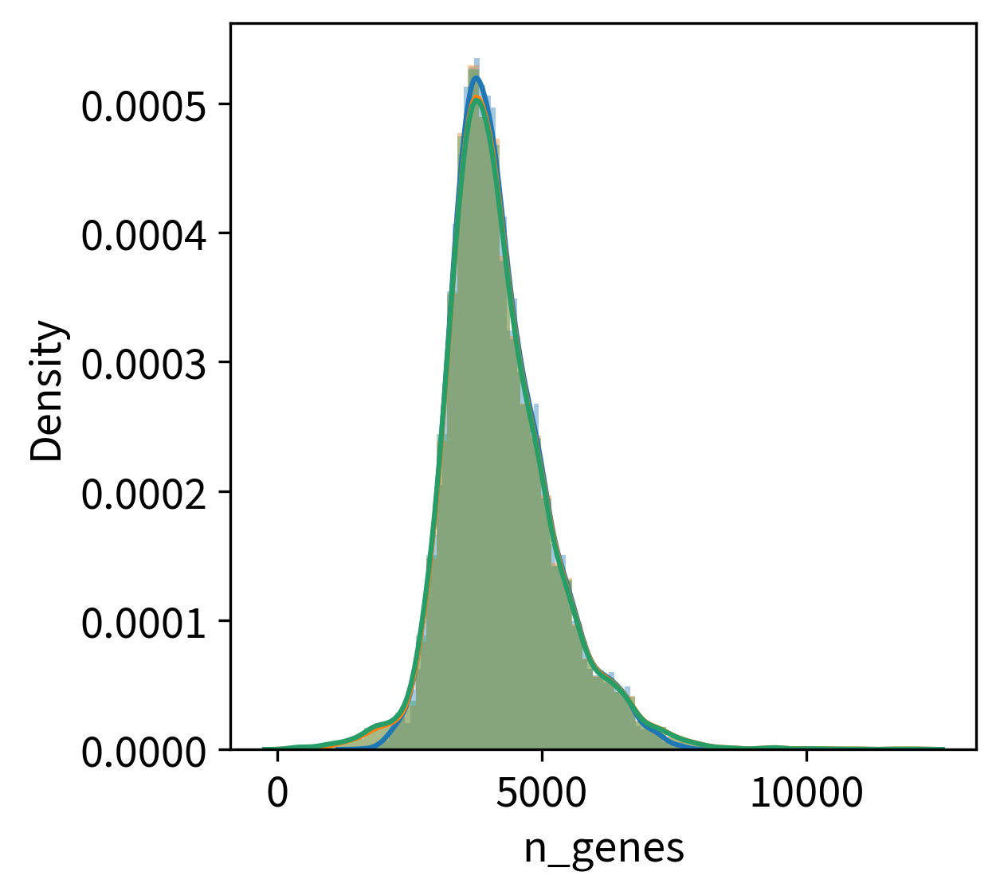

In [67]:
#Thresholding decision: genes
sb.distplot(adata.obs['n_genes'][(adata.obs['mt_frac'] < max_mito) & (adata.obs['n_counts'] > min_counts) & (adata.obs['n_counts'] < max_counts)], kde=True, bins=60)
sb.distplot(adata.obs['n_genes'][(adata.obs['mt_frac'] < max_mito)], kde=True, bins=60)
sb.distplot(adata.obs['n_genes'], kde=True, bins=60)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a

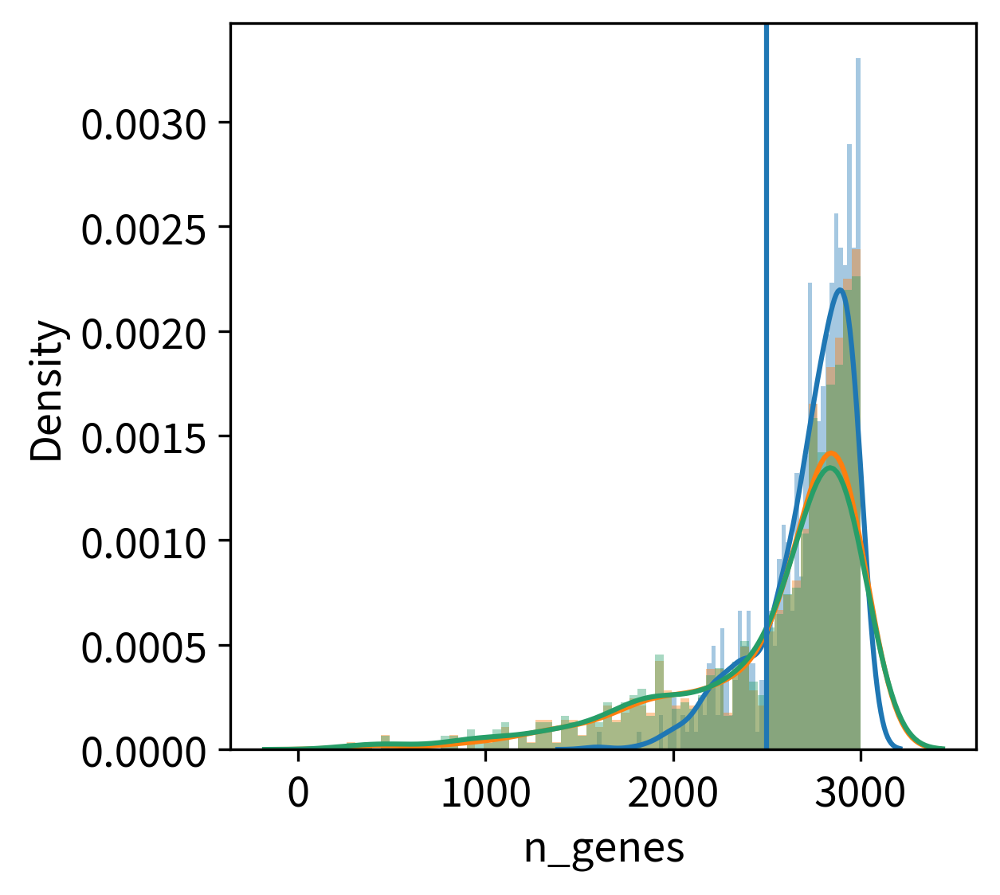

In [68]:
min_genes = 2500
sb.distplot(adata.obs['n_genes'][(adata.obs['n_genes']>100) & (adata.obs['n_genes']<3000)& (adata.obs['mt_frac'] < max_mito) & (adata.obs['n_counts'] > min_counts) & (adata.obs['n_counts'] < max_counts)], kde=True, bins=60)
sb.distplot(adata.obs['n_genes'][(adata.obs['n_genes']>100) & (adata.obs['n_genes']<3000)& (adata.obs['mt_frac'] < max_mito)], kde=True, bins=60)
sb.distplot(adata.obs['n_genes'][(adata.obs['n_genes']>100) & (adata.obs['n_genes']<3000)], kde=True, bins=60)
plt.axvline(min_genes, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a

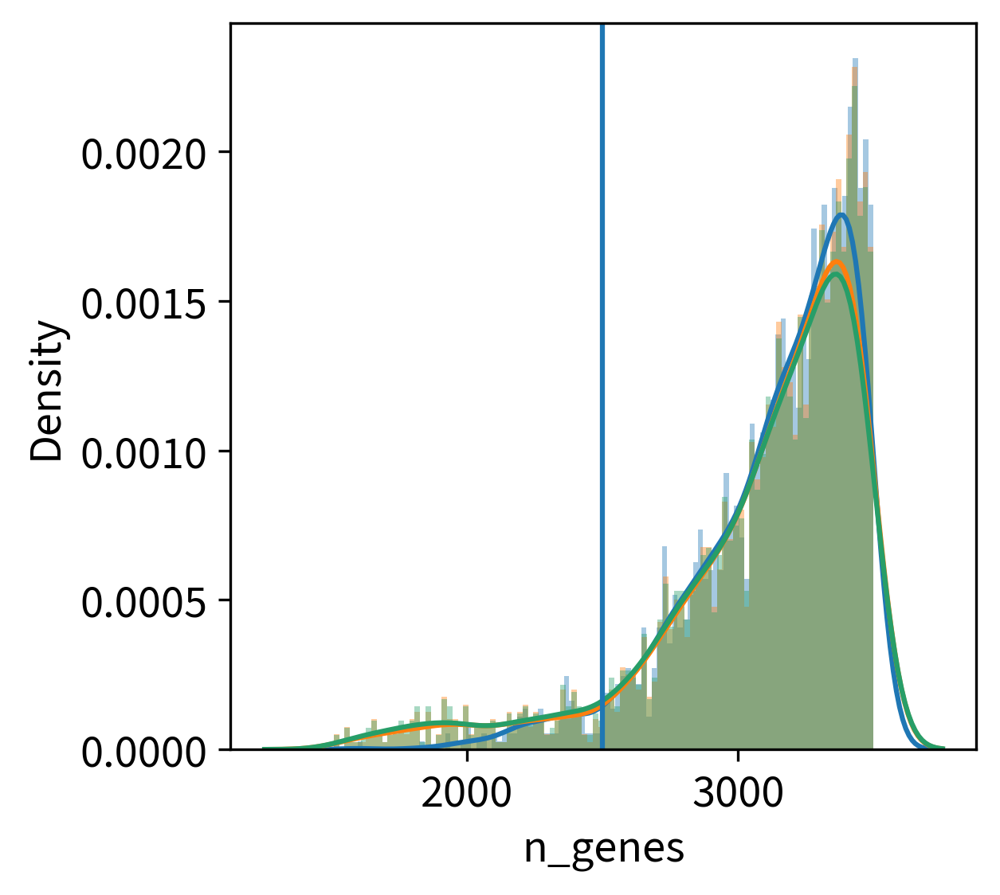

In [69]:
sb.distplot(adata.obs['n_genes'][(adata.obs['n_genes']>1500) & (adata.obs['n_genes']<3500) & (adata.obs['mt_frac'] < max_mito) & (adata.obs['n_counts'] > min_counts) & (adata.obs['n_counts'] < max_counts)], kde=True, bins=100)
sb.distplot(adata.obs['n_genes'][(adata.obs['n_genes']>1500) & (adata.obs['n_genes']<3500) & (adata.obs['mt_frac'] < max_mito)], kde=True, bins=100)
sb.distplot(adata.obs['n_genes'][(adata.obs['n_genes']>1500) & (adata.obs['n_genes']<3500)], kde=True, bins=100)
plt.axvline(min_genes, 0, 1)

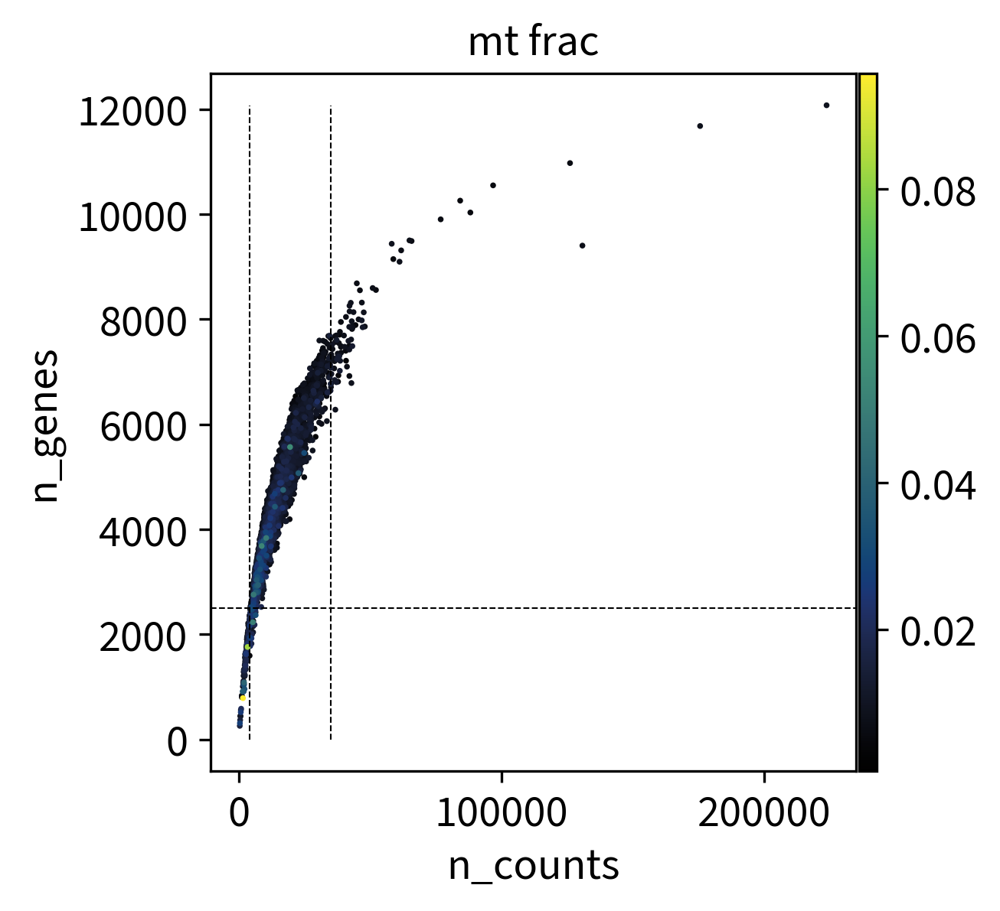

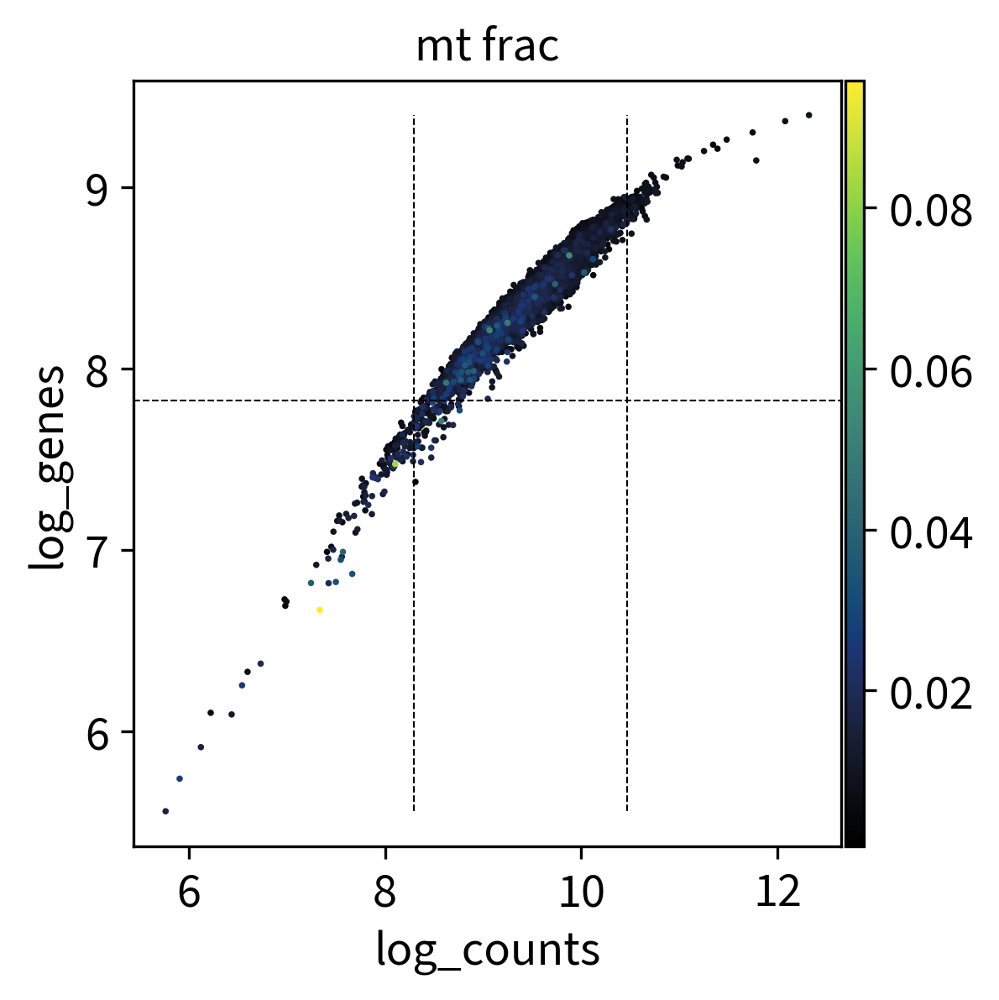

In [70]:
p=sc.pl.scatter(adata, 'n_counts', 'n_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False)
p.vlines(x=[min_counts, max_counts], ymin=[0,0], ymax=[max(adata.obs['n_genes']),max(adata.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")
p.axhline(y=min_genes, xmin=0, xmax=max(adata.obs['n_counts']), color="black", lw=0.5).set_linestyle("--")
plt.show()

p=sc.pl.scatter(adata, 'log_counts', 'log_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False)
p.vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(adata.obs['n_genes'])),np.log(min(adata.obs['n_genes']))], ymax=[np.log(max(adata.obs['n_genes'])),np.log(max(adata.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")
p.axhline(y=np.log(min_genes), color="black", lw=0.5).set_linestyle("--")
plt.show()

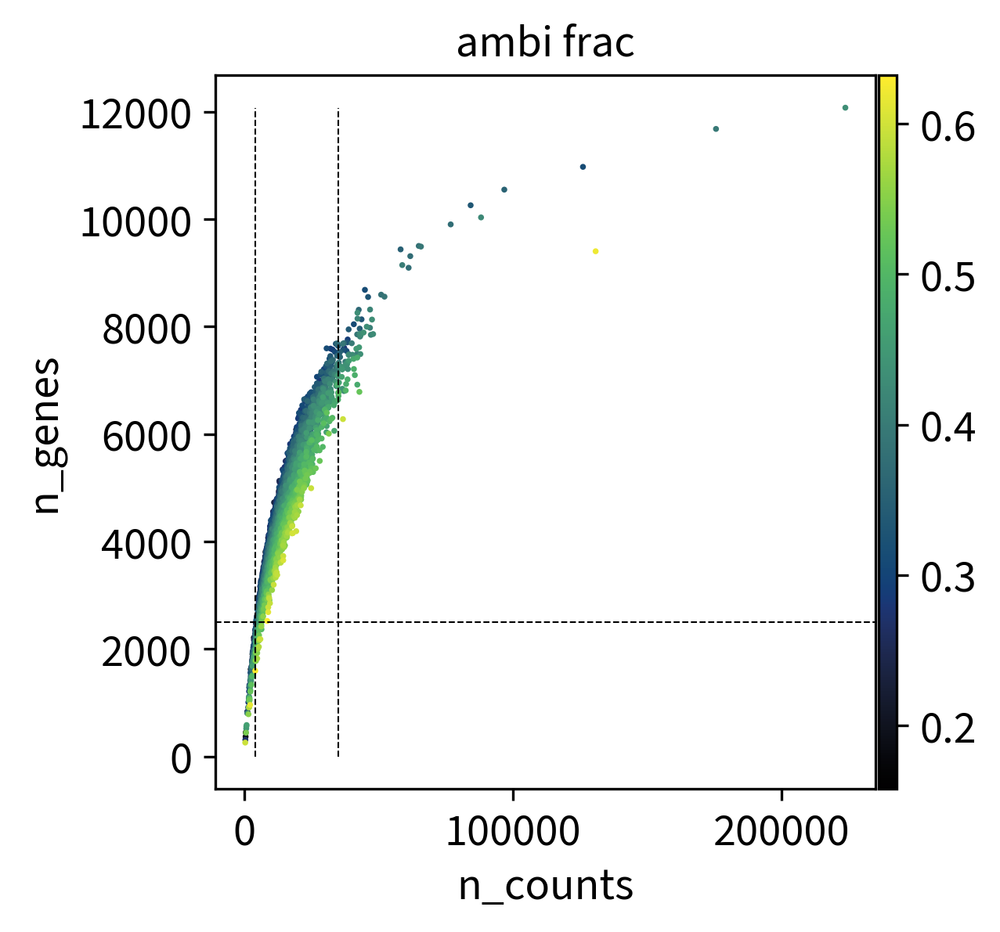

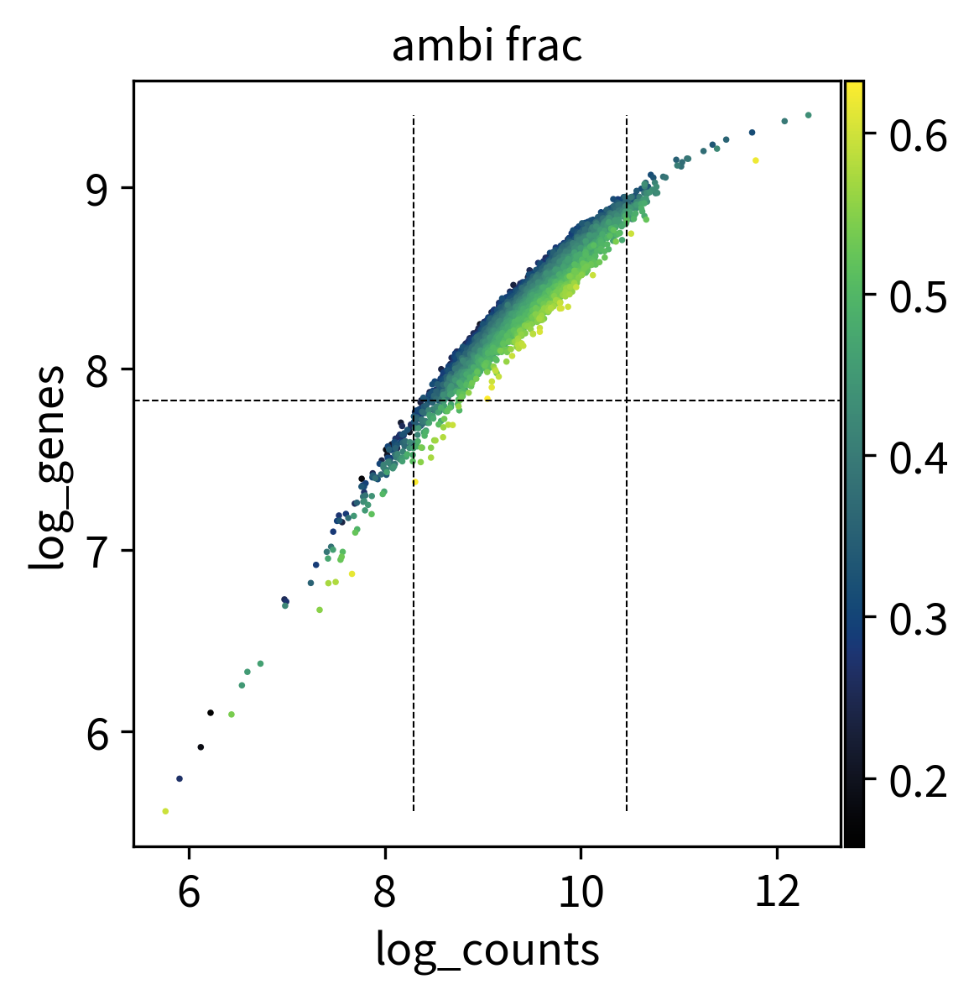

In [71]:
p=sc.pl.scatter(adata, 'n_counts', 'n_genes', color='ambi_frac', color_map=michi_bk_bl_gn_yl, show=False)
p.vlines(x=[min_counts, max_counts], ymin=[0,0], ymax=[max(adata.obs['n_genes']),max(adata.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")
p.axhline(y=min_genes, xmin=0, xmax=max(adata.obs['n_counts']), color="black", lw=0.5).set_linestyle("--")
plt.show()

p=sc.pl.scatter(adata, 'log_counts', 'log_genes', color='ambi_frac', color_map=michi_bk_bl_gn_yl, show=False)
p.vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(adata.obs['n_genes'])),np.log(min(adata.obs['n_genes']))], ymax=[np.log(max(adata.obs['n_genes'])),np.log(max(adata.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")
p.axhline(y=np.log(min_genes), color="black", lw=0.5).set_linestyle("--")
plt.show()

### Filtering

In [72]:
adata.obs['filtered_cells']=pd.Categorical(list(map(str,list((adata.obs['n_counts'] > min_counts) & (adata.obs['n_counts'] < max_counts) & (adata.obs['n_genes'] > min_genes) & (adata.obs['mt_frac'] < max_mito)))))

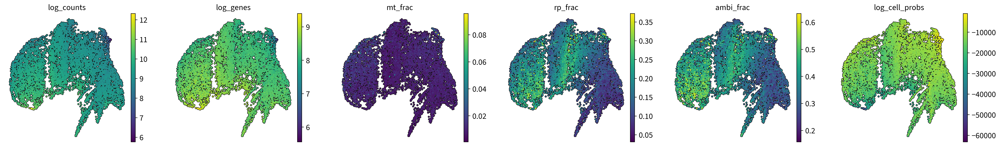

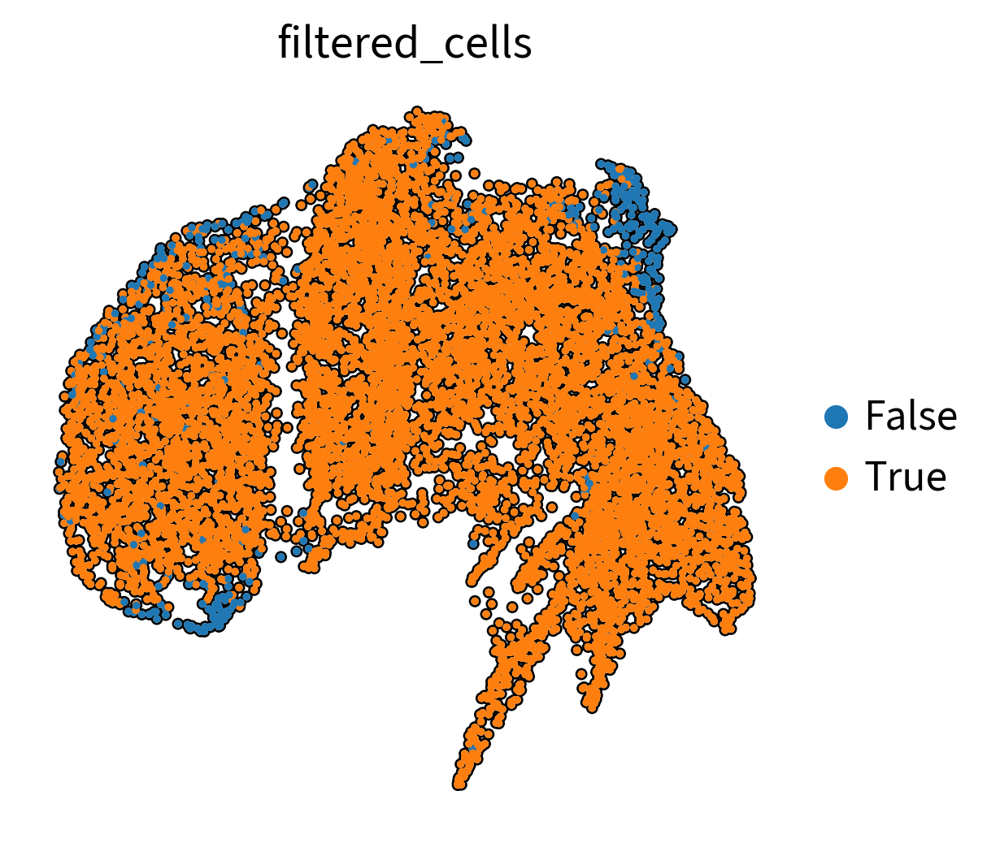

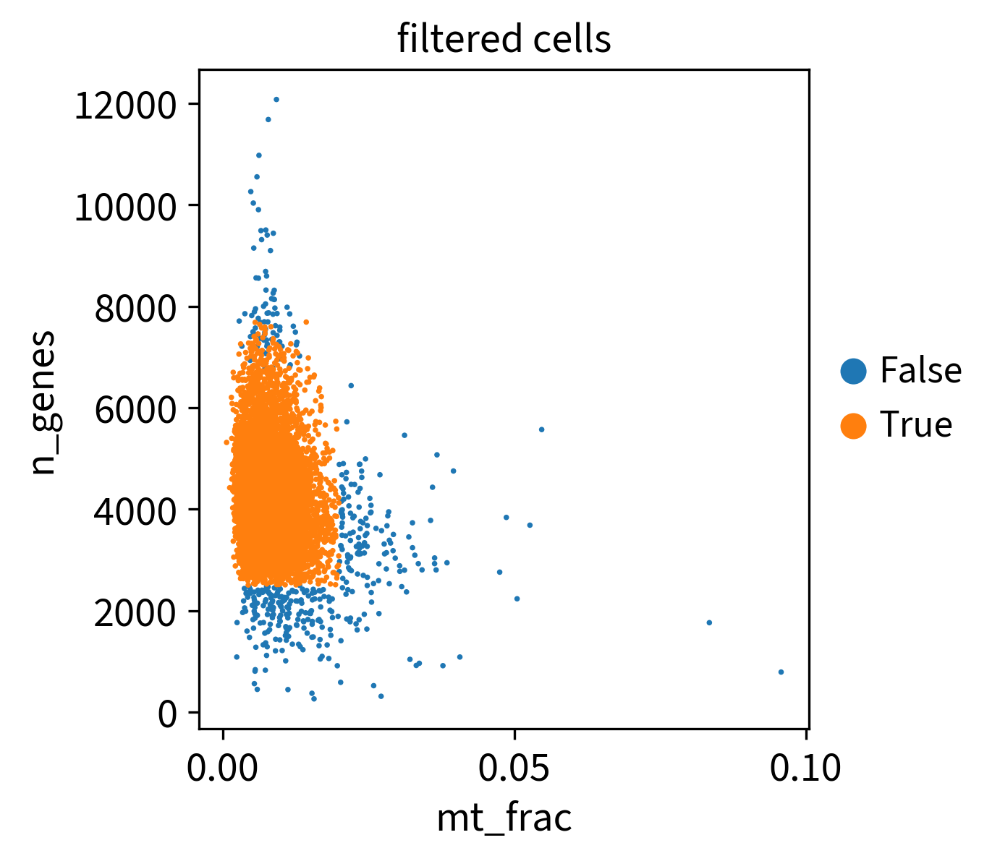

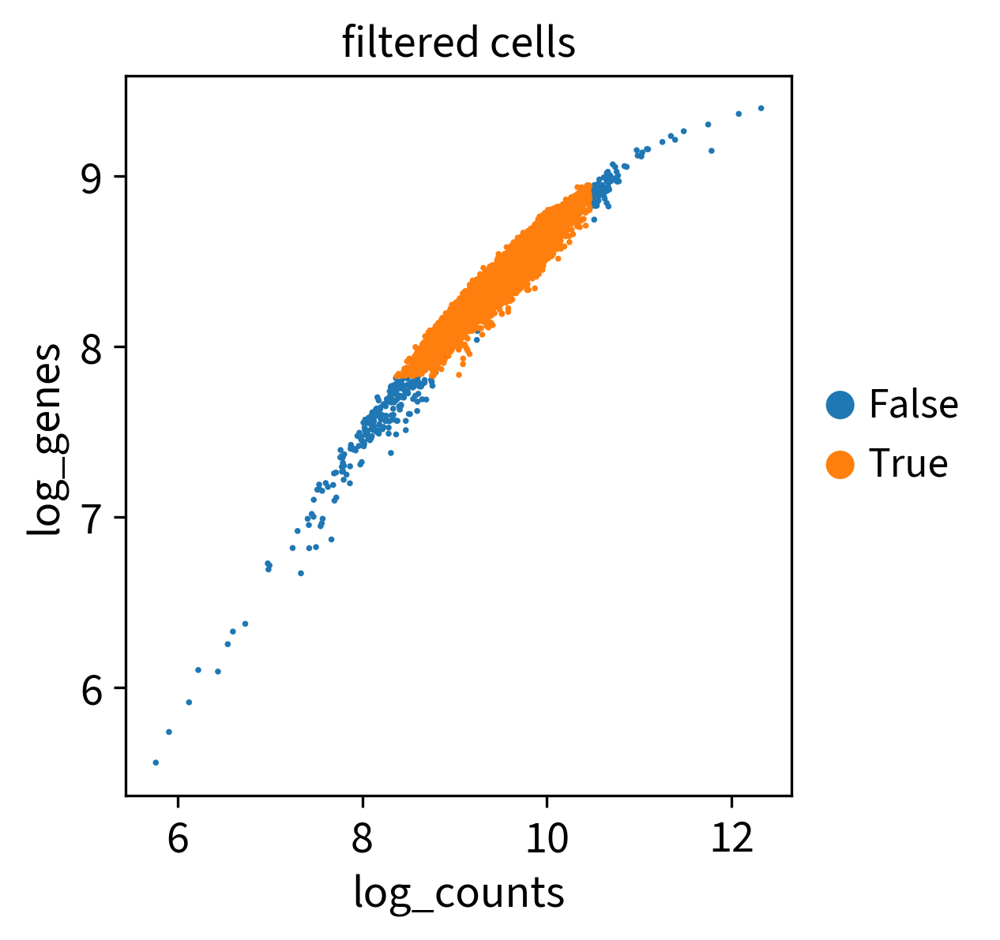

In [73]:
sc.pl.umap(adata, color=['log_counts','log_genes','mt_frac','rp_frac','ambi_frac','log_cell_probs'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)
sc.pl.umap(adata, color=['filtered_cells'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)
sc.pl.scatter(adata, 'mt_frac', 'n_genes', color='filtered_cells')
sc.pl.scatter(adata, 'log_counts', 'log_genes', color='filtered_cells')

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Log Cell Probabilities\nFiltered Cell Barcodes')

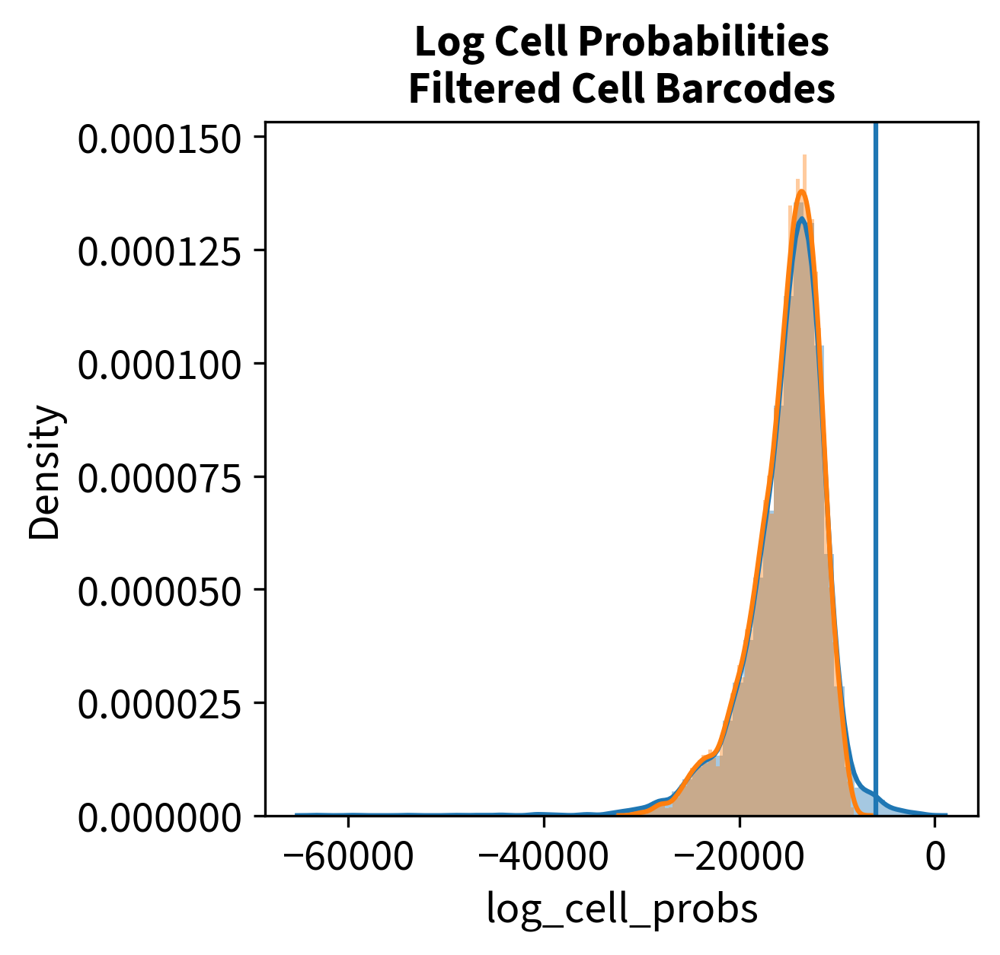

In [74]:
max_prob = -6000
sb.distplot(adata.obs['log_cell_probs'], kde=True, bins=60)
sb.distplot(adata[adata.obs['filtered_cells']=='True'].obs['log_cell_probs'], kde=True, bins=60)
plt.axvline(max_prob, 0, 1)
plt.title(label='Log Cell Probabilities\nFiltered Cell Barcodes', fontweight='bold')

In [75]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_counts = min_counts)
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = max_counts)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

adata = adata[(adata.obs['mt_frac'] < max_mito)]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = min_genes)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 9067
filtered out 123 cells that have less than 4000 counts
Number of cells after min count filter: 8944
filtered out 83 cells that have more than 35000 counts
Number of cells after max count filter: 8861
Number of cells after MT filter: 8724
filtered out 84 cells that have less than 2500 genes expressed


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 8640


In [76]:
del adata.obs['filtered_cells']
del adata.obs['high_mt_frac']
#del adata.obs['low_mt_frac']

In [77]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


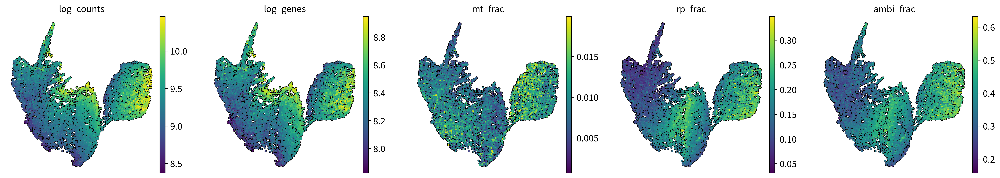

In [78]:
sc.pl.umap(adata, color=['log_counts','log_genes','mt_frac','rp_frac','ambi_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5)

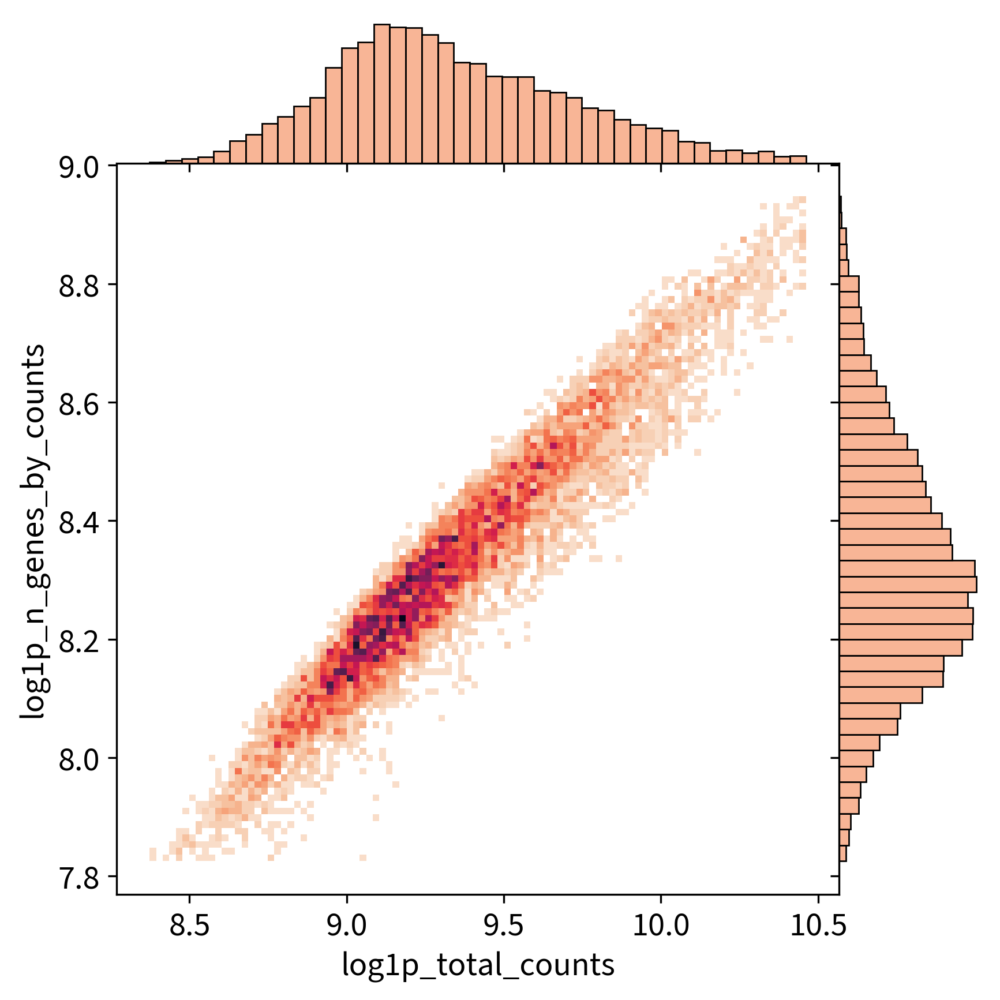

In [79]:
sb.jointplot(
    data=adata.obs,
    x="log1p_total_counts",
    y="log1p_n_genes_by_counts",
    kind="hist", bins=100, cmap="rocket_r", color="#f69c73", space=0
)

# Preprocessing ATAC

## QC & Filtering ATAC

In [80]:
# Get filtered barcodes
gex_filtered_bc = list(adata.obs_names)

In [81]:
%%R -i gex_filtered_bc -o filter_stats

# extract gene annotations from EnsDb
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v102)

# rename chromosome names to match cellranger output
BSgenome.Mmusculus.UCSC.mm10.renamed <- renameSeqlevels(BSgenome.Mmusculus.UCSC.mm10, value = str_replace(str_replace(seqnames(BSgenome.Mmusculus.UCSC.mm10), pattern = "chr", replacement = ""), pattern = "M", replacement = "MT"))

# read cellranger output 
counts <- Read10X_h5(filename = "/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/filtered_feature_bc_matrix.h5") # the filtered mtx is fine since GEX QC is based on the same filtered barcodes
fragpath <- "/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz"

# create seurat objects
## create a Seurat object containing the RNA adata
seurat <- CreateSeuratObject(counts = counts$`Gene Expression`, assay = "RNA", project = "NVF-E15.5")

## create ATAC assay and add it to the object
seurat[["ATAC"]] <- CreateChromatinAssay(counts = counts$Peaks, sep = c(":", "-"), fragments = fragpath, annotation = annotations)

# filter cells
seurat <- seurat[,gex_filtered_bc]

#ATAC-seq QC
DefaultAssay(seurat) <- "ATAC"
seurat <- NucleosomeSignal(seurat)
seurat <- TSSEnrichment(seurat)

# get filter stats and export
filter_stats <- seurat@meta.data

  |                                                  | 0 % ~calculating  

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |+++++                                             | 9 % ~04m 16s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |++++++++++                                        | 18% ~03m 26s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |++++++++++++++                                    | 27% ~03m 24s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |+++++++++++++++++++                               | 36% ~02m 54s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |+++++++++++++++++++++++                           | 45% ~02m 27s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |++++++++++++++++++++++++++++                      | 55% ~02m 02s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |++++++++++++++++++++++++++++++++                  | 64% ~01m 42s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |+++++++++++++++++++++++++++++++++++++             | 73% ~01m 15s      

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |+++++++++++++++++++++++++++++++++++++++++         | 82% ~51s          

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |++++++++++++++++++++++++++++++++++++++++++++++    | 91% ~26s          

[W::hts_idx_load2] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/atac_fragments.tsv.gz.tbi


  |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=04m 42s


In [82]:
adata.obs.loc[:,['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile']] = filter_stats.loc[adata.obs_names,['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile']]

In [83]:
adata.obs['log_nCount_ATAC'] = np.log(adata.obs['nCount_ATAC'])
adata.obs['log_nFeature_ATAC'] = np.log(adata.obs['nFeature_ATAC'])

<Axes:title={'center':'log nCount ATAC'}, xlabel='TSS.enrichment', ylabel='nucleosome_signal'>

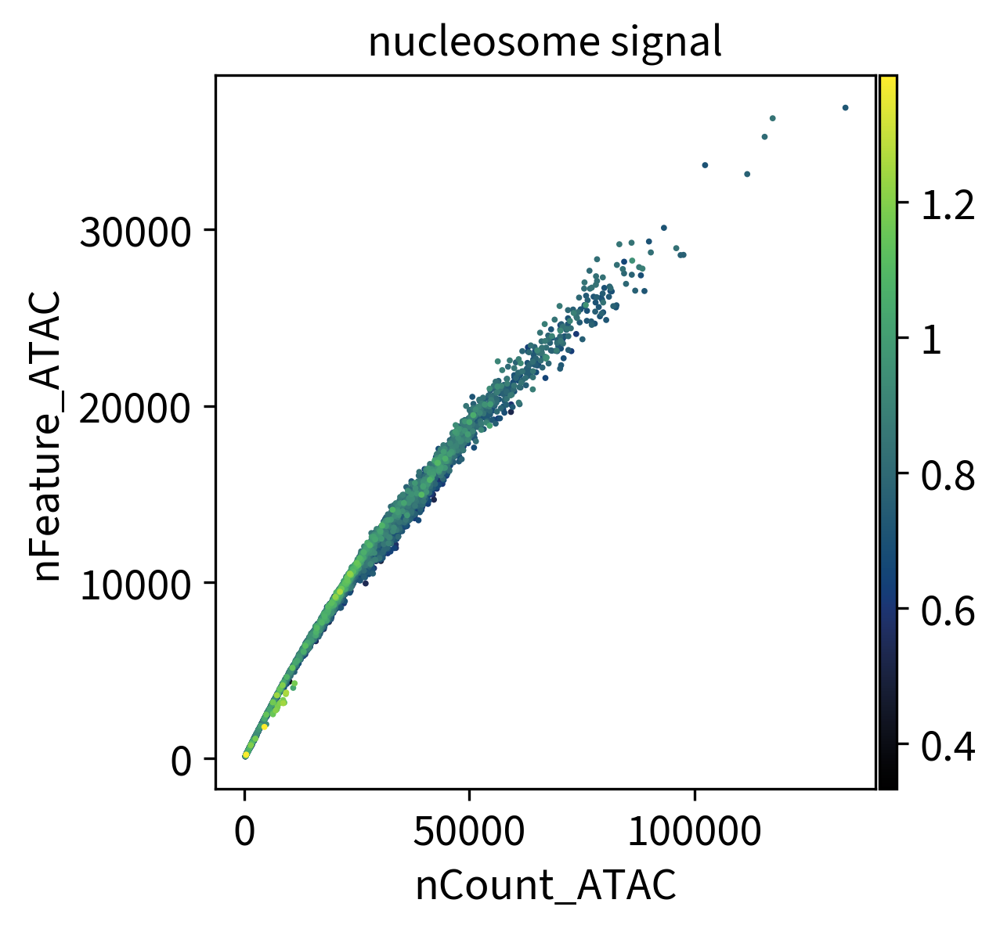

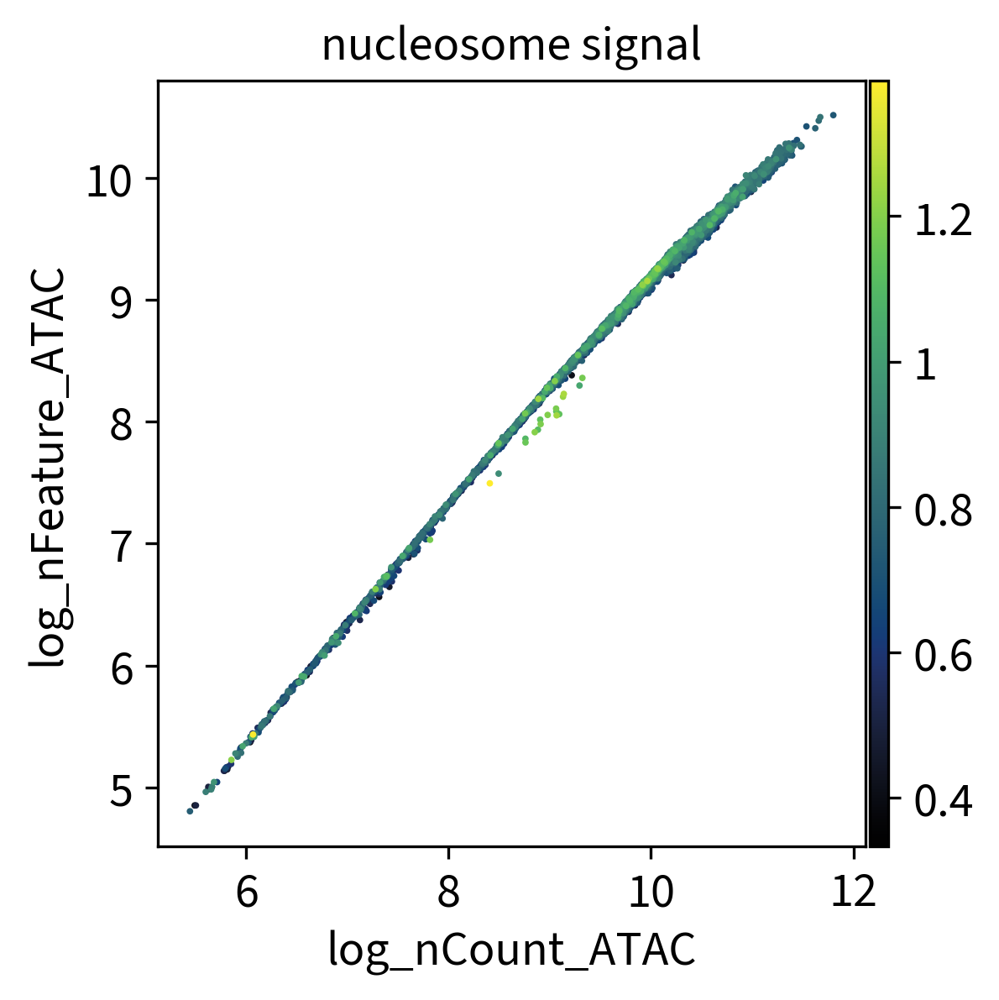

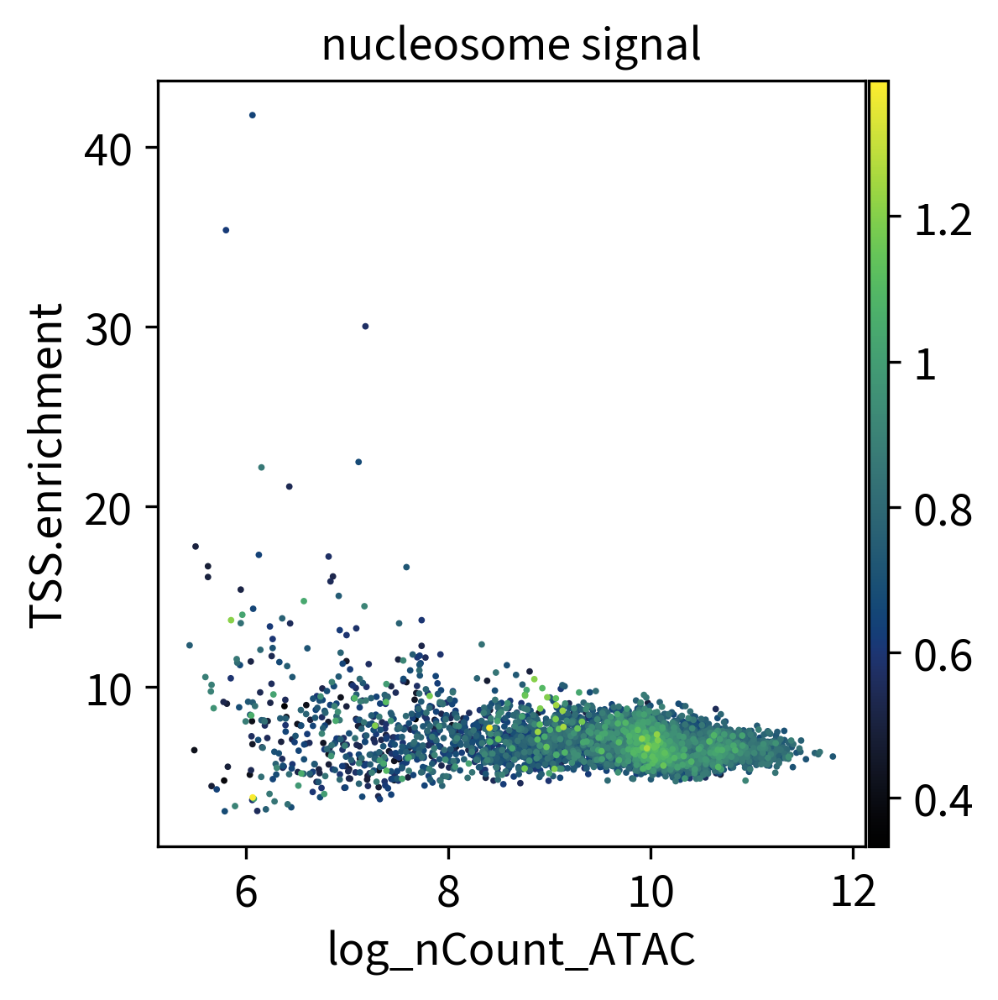

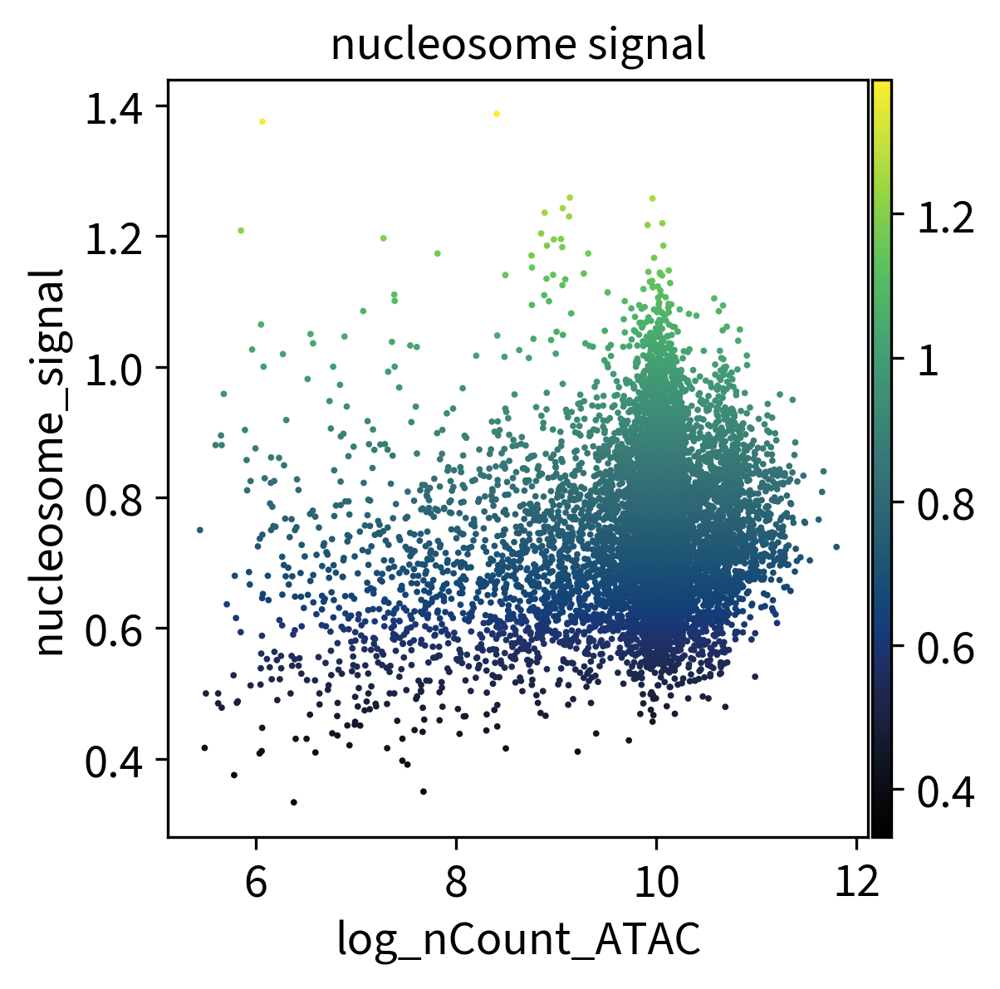

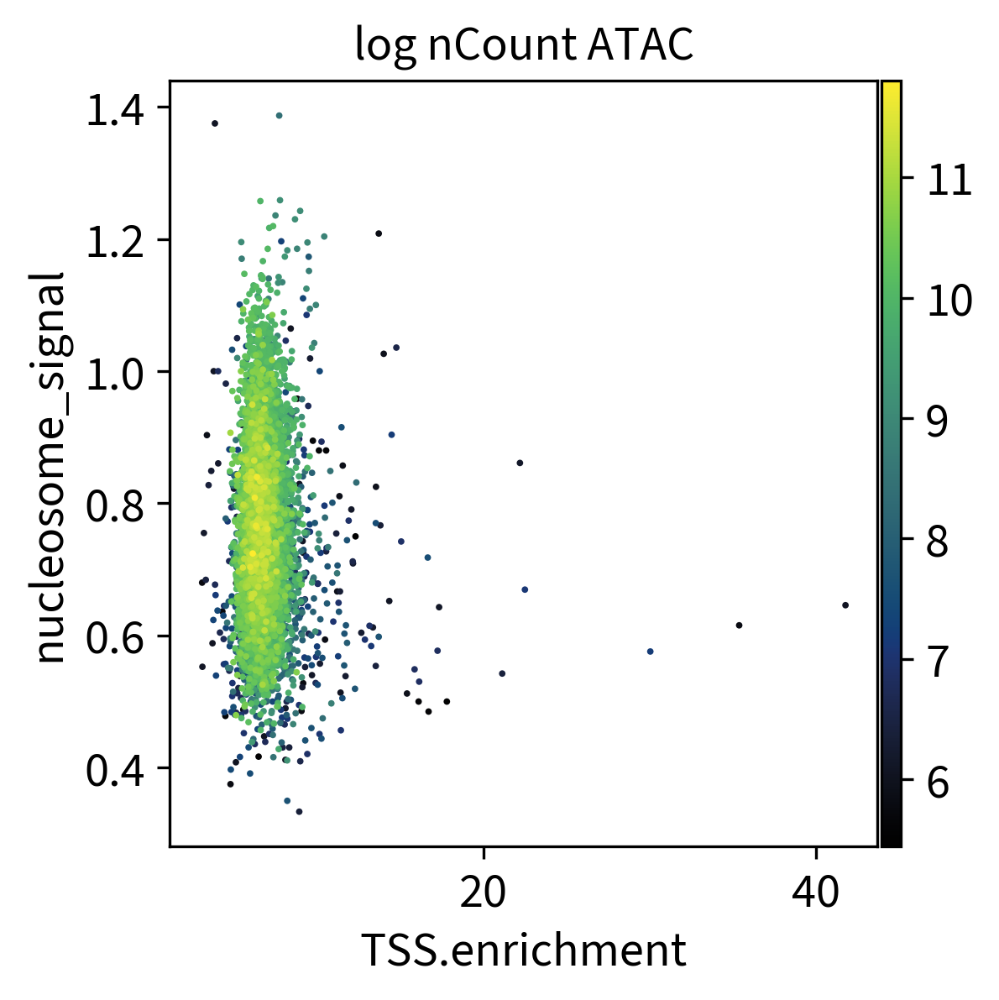

In [84]:
sc.pl.scatter(adata, 'nCount_ATAC', 'nFeature_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(adata, 'log_nCount_ATAC', 'log_nFeature_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(adata, 'log_nCount_ATAC', 'TSS.enrichment', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(adata, 'log_nCount_ATAC', 'nucleosome_signal', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(adata, 'TSS.enrichment', 'nucleosome_signal', color='log_nCount_ATAC', color_map=michi_bk_bl_gn_yl, show=False)

### QC & Thresholding Decisions

#### Counts

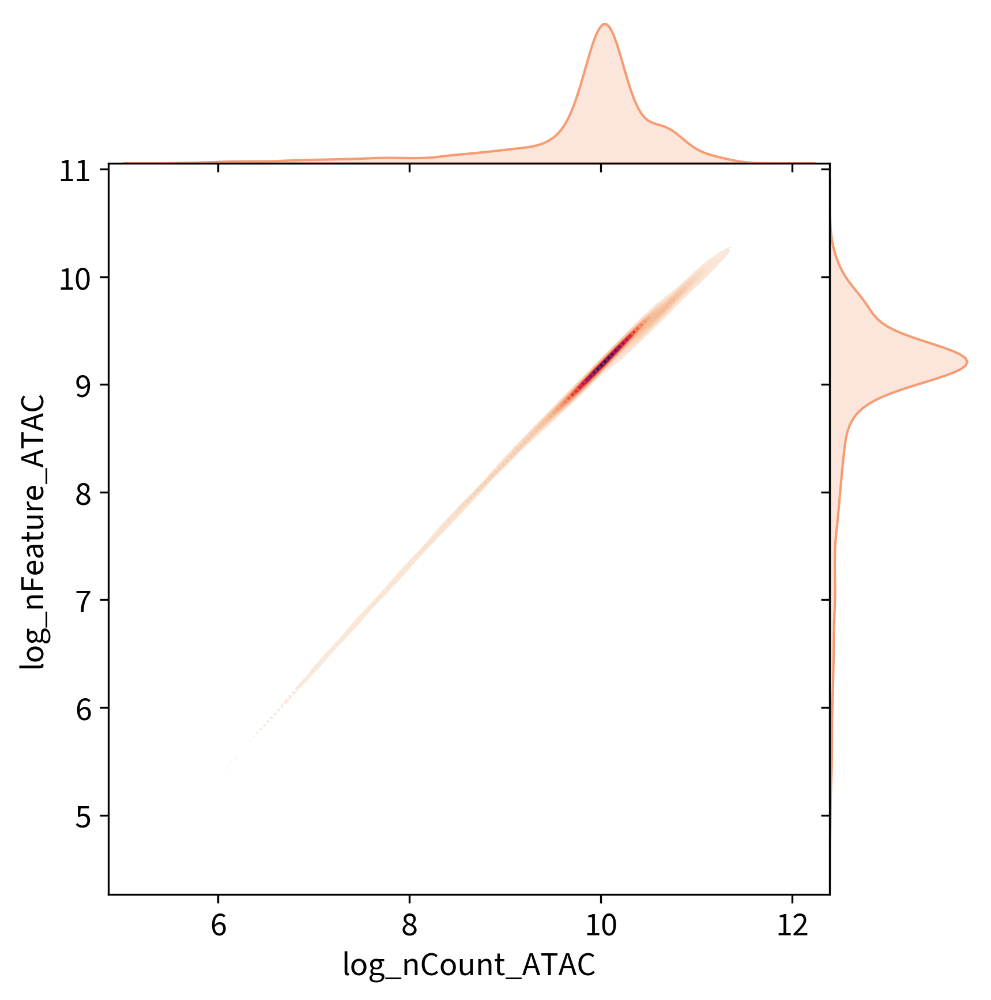

In [85]:
sb.jointplot(x=adata.obs['log_nCount_ATAC'], y=adata.obs['log_nFeature_ATAC'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='nCount_ATAC', ylabel='Density'>

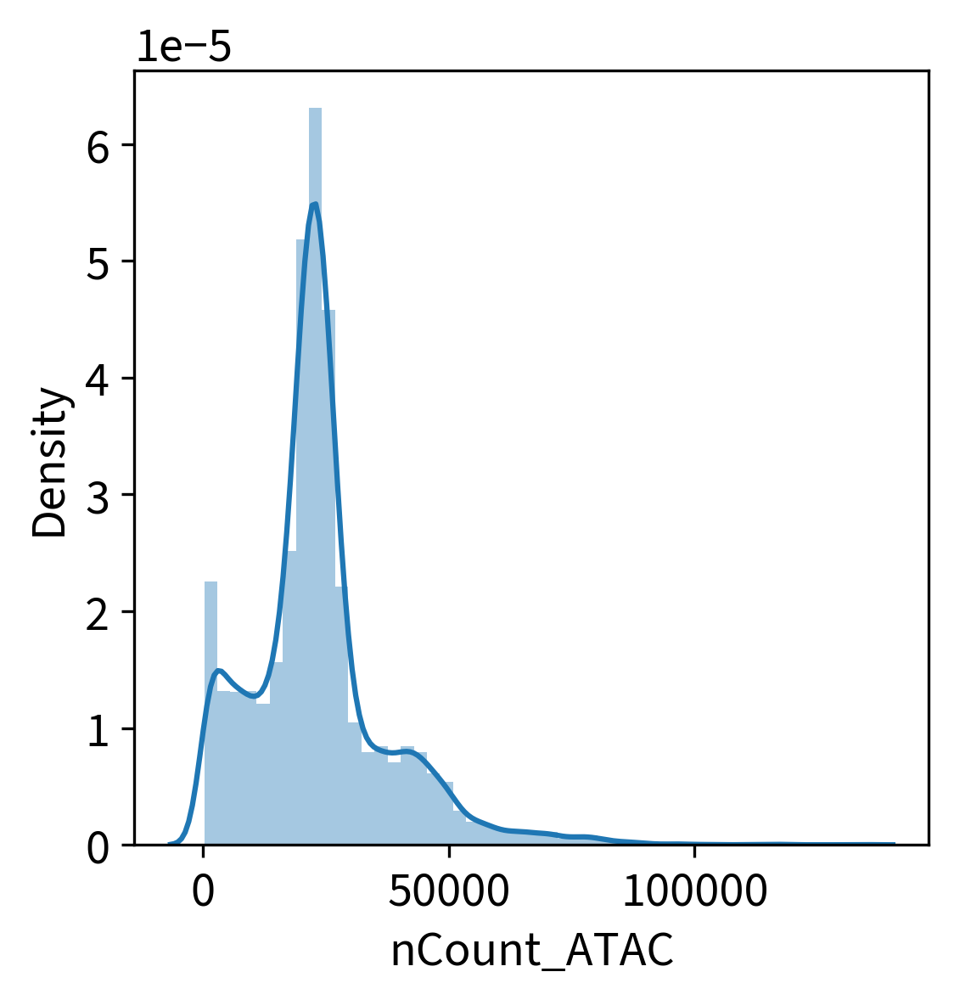

In [86]:
#Thresholding decision: counts
sb.distplot(adata.obs['nCount_ATAC'], kde=True)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


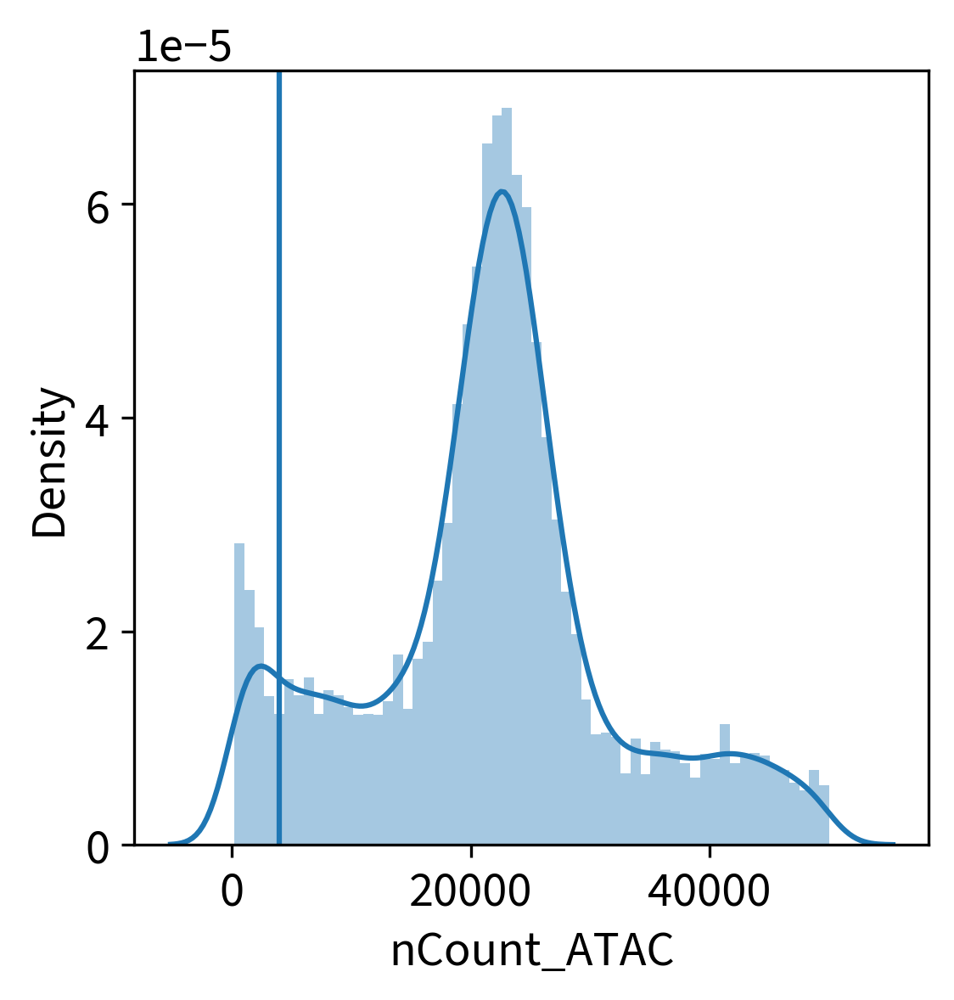

In [87]:
min_counts_atac = 4000
sb.distplot(adata.obs['nCount_ATAC'][(adata.obs['nCount_ATAC']<50000)], kde=True, bins=60)
plt.axvline(min_counts_atac, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


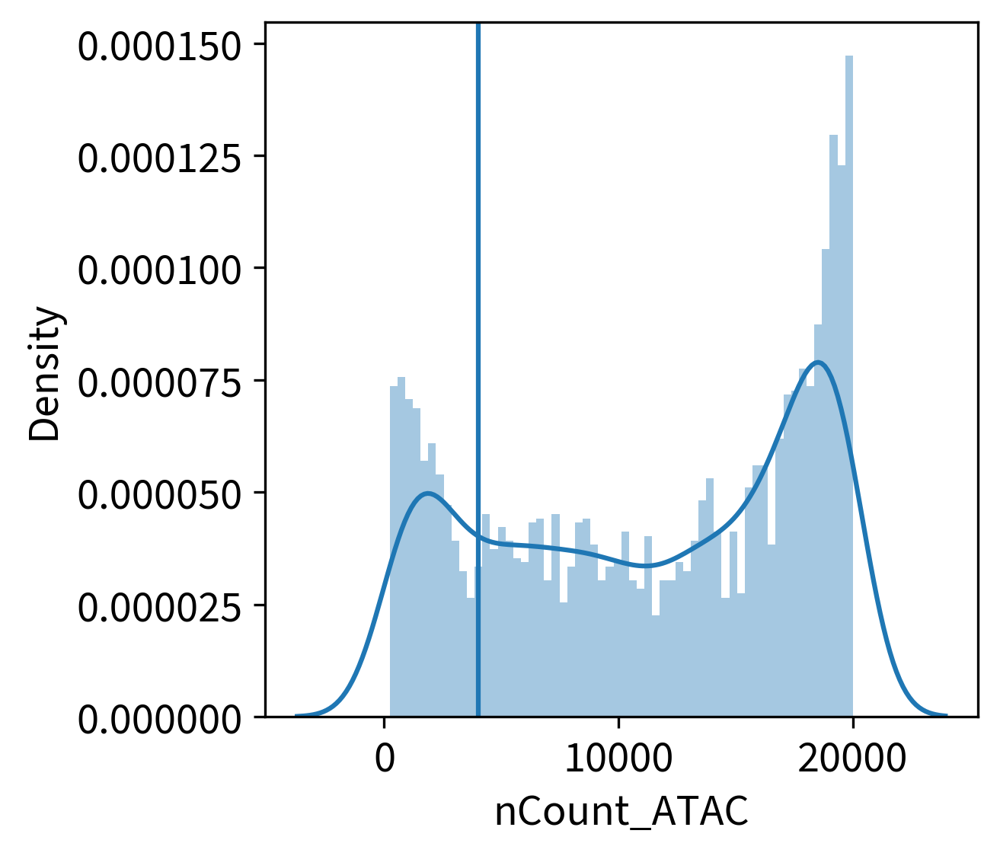

In [88]:
sb.distplot(adata.obs['nCount_ATAC'][(adata.obs['nCount_ATAC']>100) & (adata.obs['nCount_ATAC']<20000)], kde=True, bins=60)
plt.axvline(min_counts_atac, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


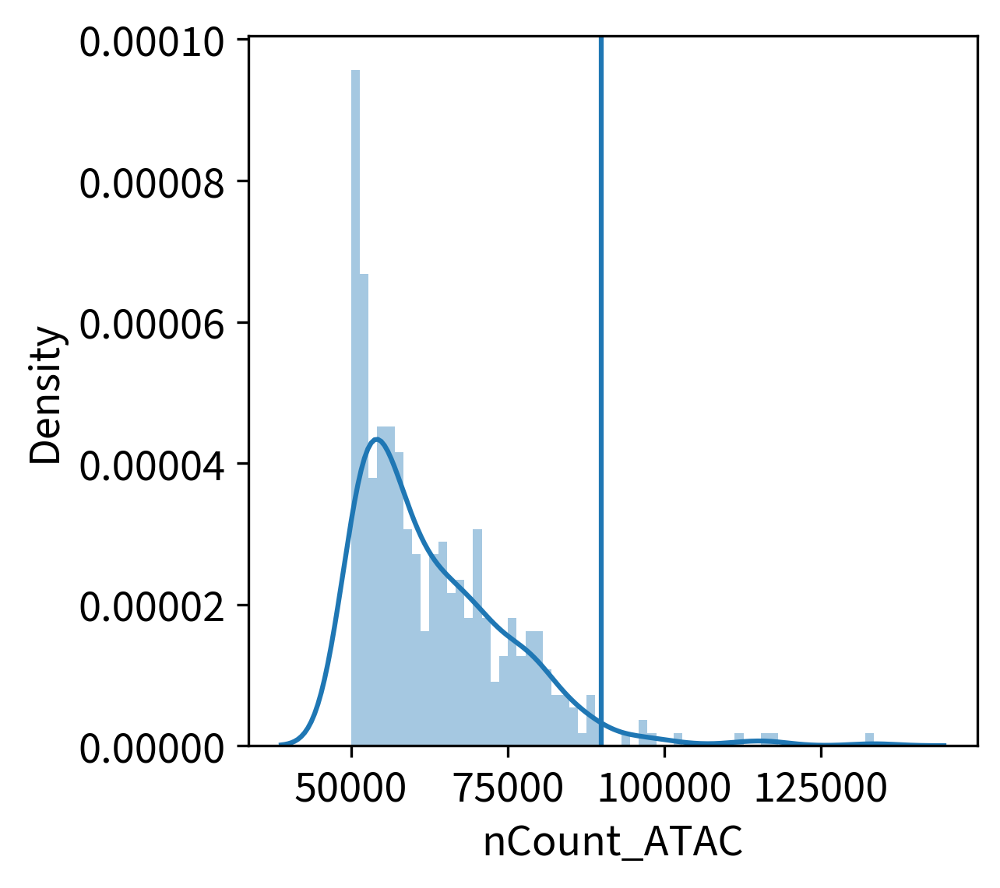

In [89]:
max_counts_atac = 90000
sb.distplot(adata.obs['nCount_ATAC'][(adata.obs['nCount_ATAC']>50000) & (adata.obs['nCount_ATAC']<200000)], kde=True, bins=60)
plt.axvline(max_counts_atac, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


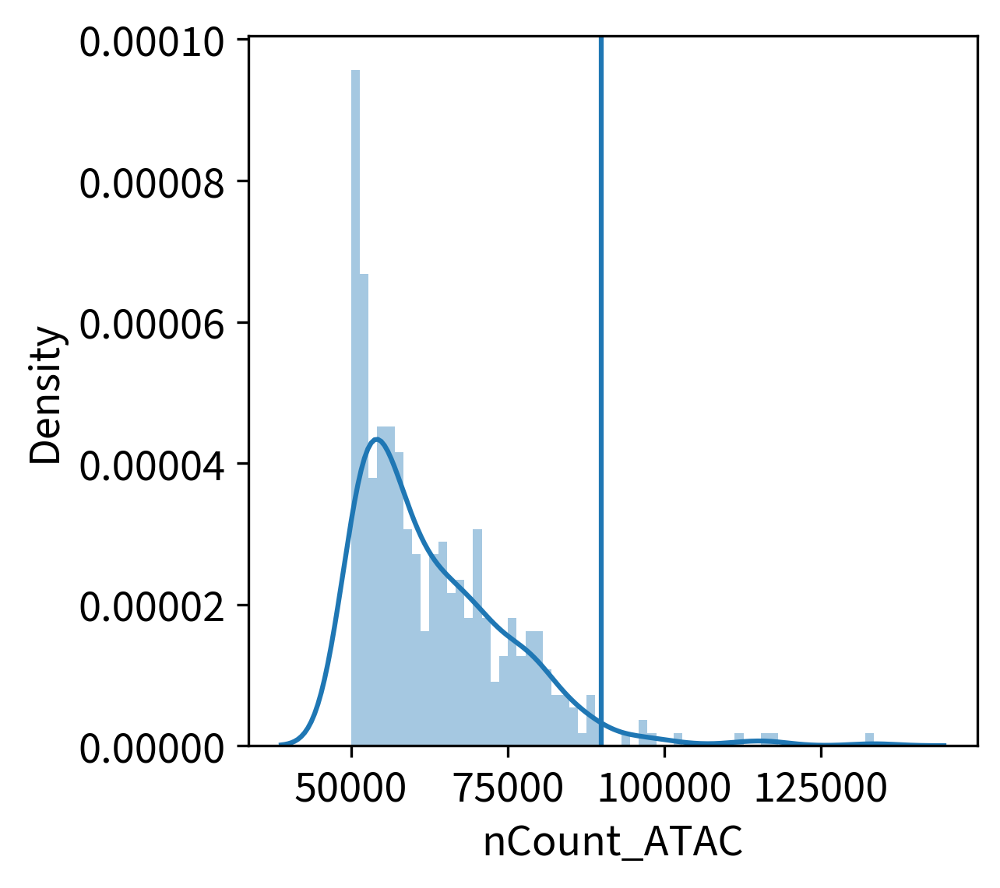

In [90]:
sb.distplot(adata.obs['nCount_ATAC'][(adata.obs['nCount_ATAC']>50000) & (adata.obs['nCount_ATAC']<175000)], kde=True, bins=60)
plt.axvline(max_counts_atac, 0, 1)

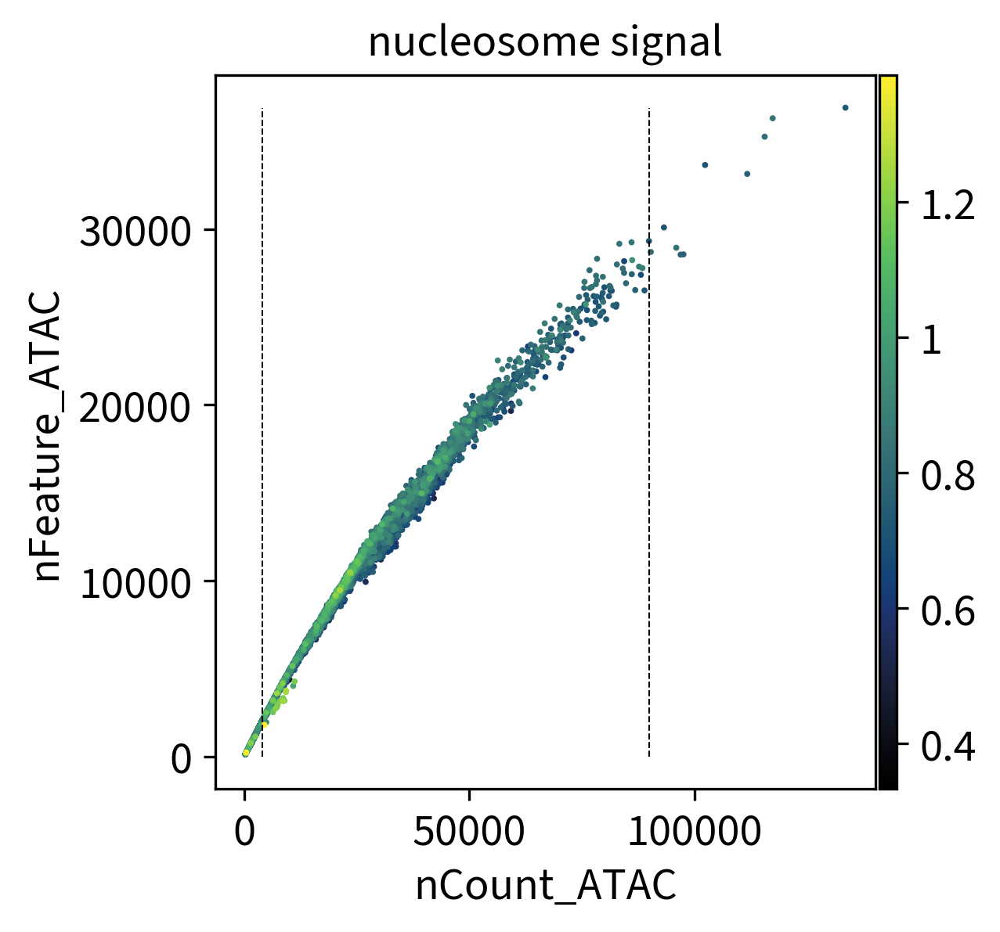

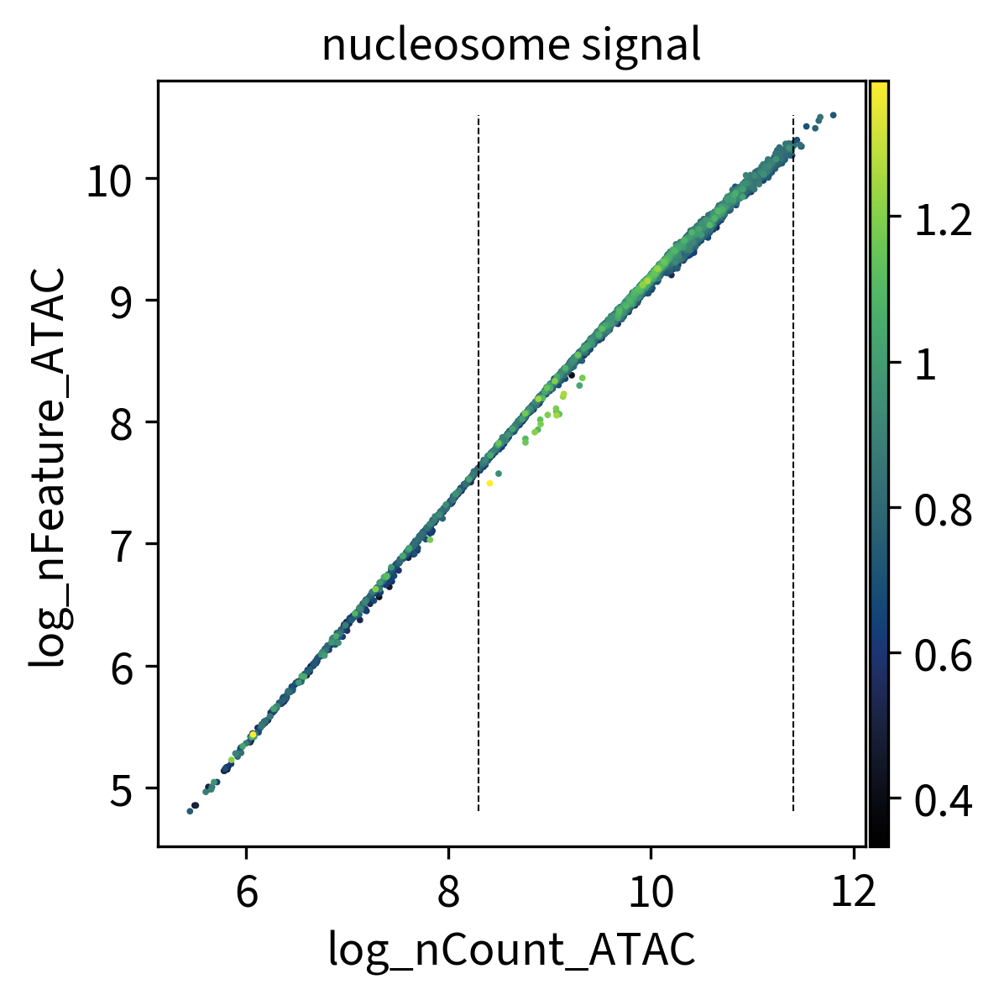

In [91]:
sc.pl.scatter(adata, 'nCount_ATAC', 'nFeature_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[min_counts_atac, max_counts_atac], ymin=[0,0], ymax=[max(adata.obs['nFeature_ATAC']),max(adata.obs['nFeature_ATAC'])], color="black", lw=0.5).set_linestyle("--")
sc.pl.scatter(adata, 'log_nCount_ATAC', 'log_nFeature_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[np.log(min_counts_atac), np.log(max_counts_atac)], ymin=[np.log(min(adata.obs['nFeature_ATAC'])),np.log(min(adata.obs['nFeature_ATAC']))], ymax=[np.log(max(adata.obs['nFeature_ATAC'])),np.log(max(adata.obs['nFeature_ATAC']))], color="black", lw=0.5).set_linestyle("--")

#### TSS Enrichment

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='TSS.enrichment', ylabel='Density'>

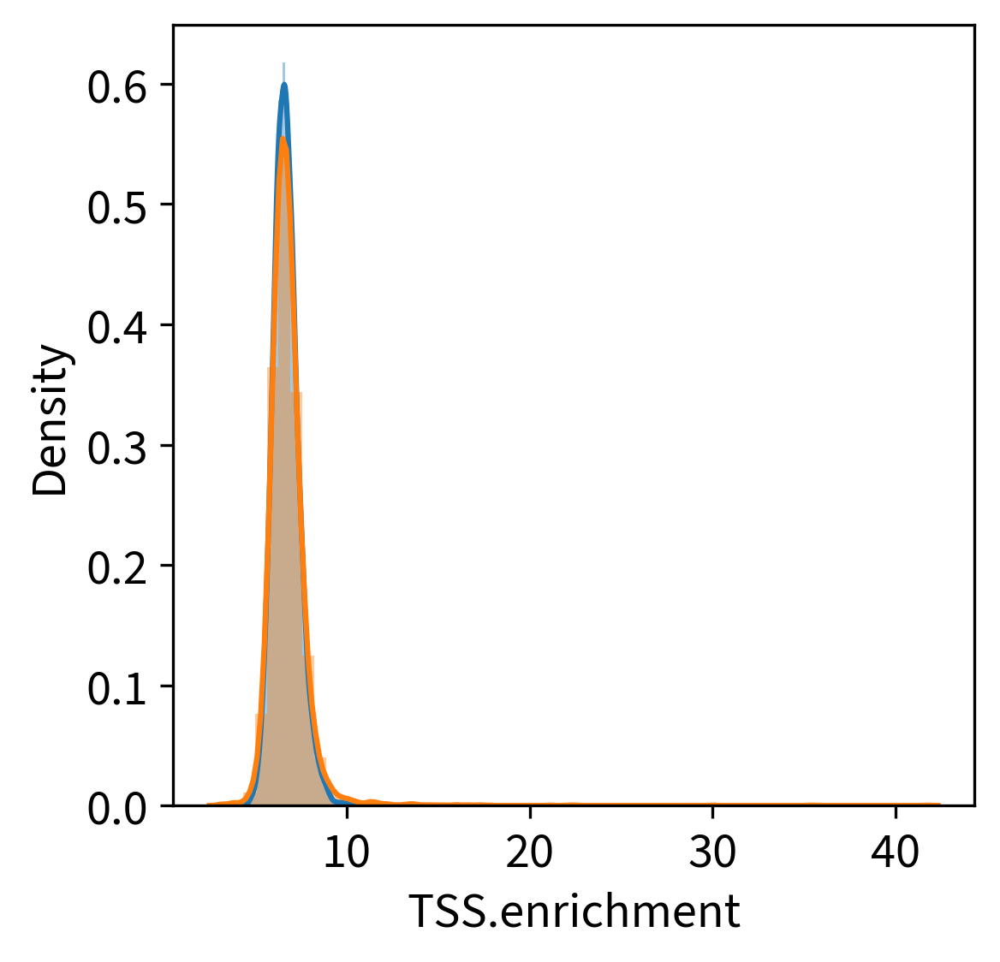

In [92]:
#Thresholding decision: tss enrichment
sb.distplot(adata.obs['TSS.enrichment'][(adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)], kde=True, bins=60)
sb.distplot(adata.obs['TSS.enrichment'], kde=True, bins=60)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


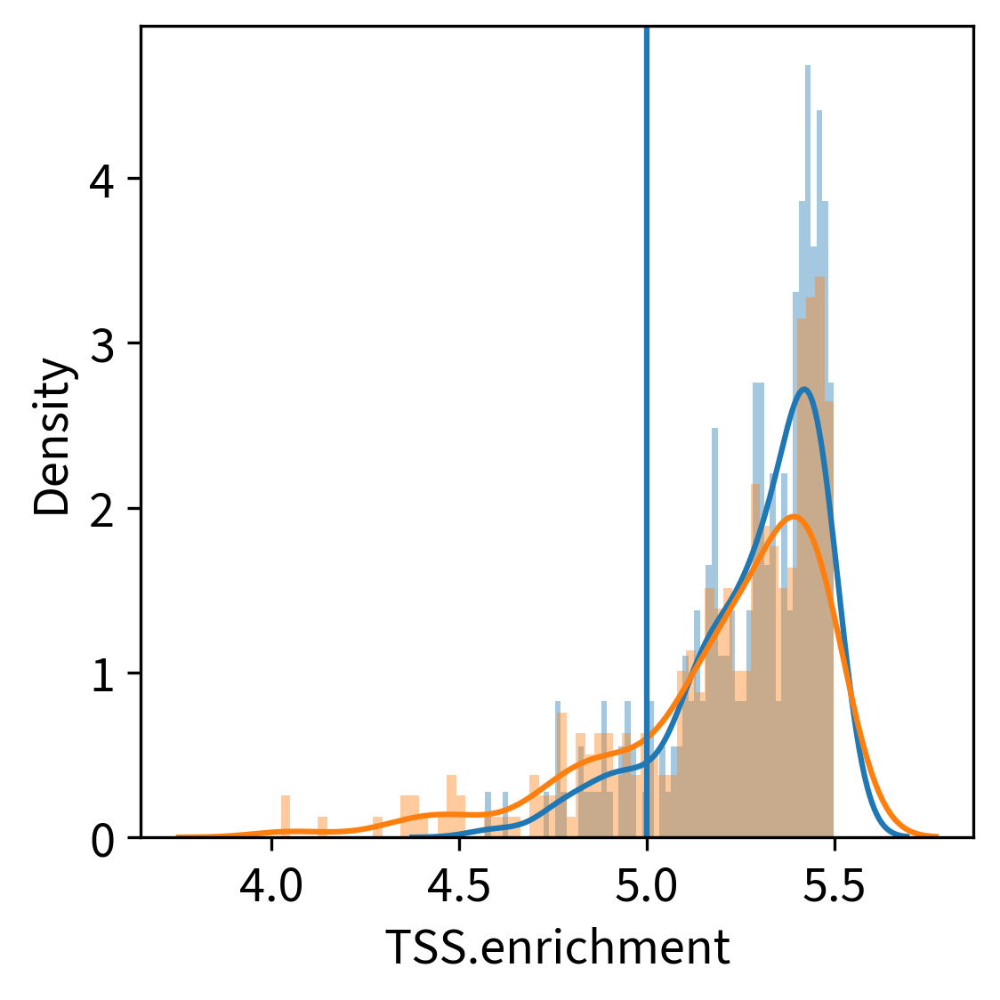

In [93]:
min_tss = 5
sb.distplot(adata.obs['TSS.enrichment'][(adata.obs['TSS.enrichment']>4) & (adata.obs['TSS.enrichment']<5.5) & (adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)], kde=True, bins=60)
sb.distplot(adata.obs['TSS.enrichment'][(adata.obs['TSS.enrichment']>4) & (adata.obs['TSS.enrichment']<5.5)], kde=True, bins=60)
plt.axvline(min_tss, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


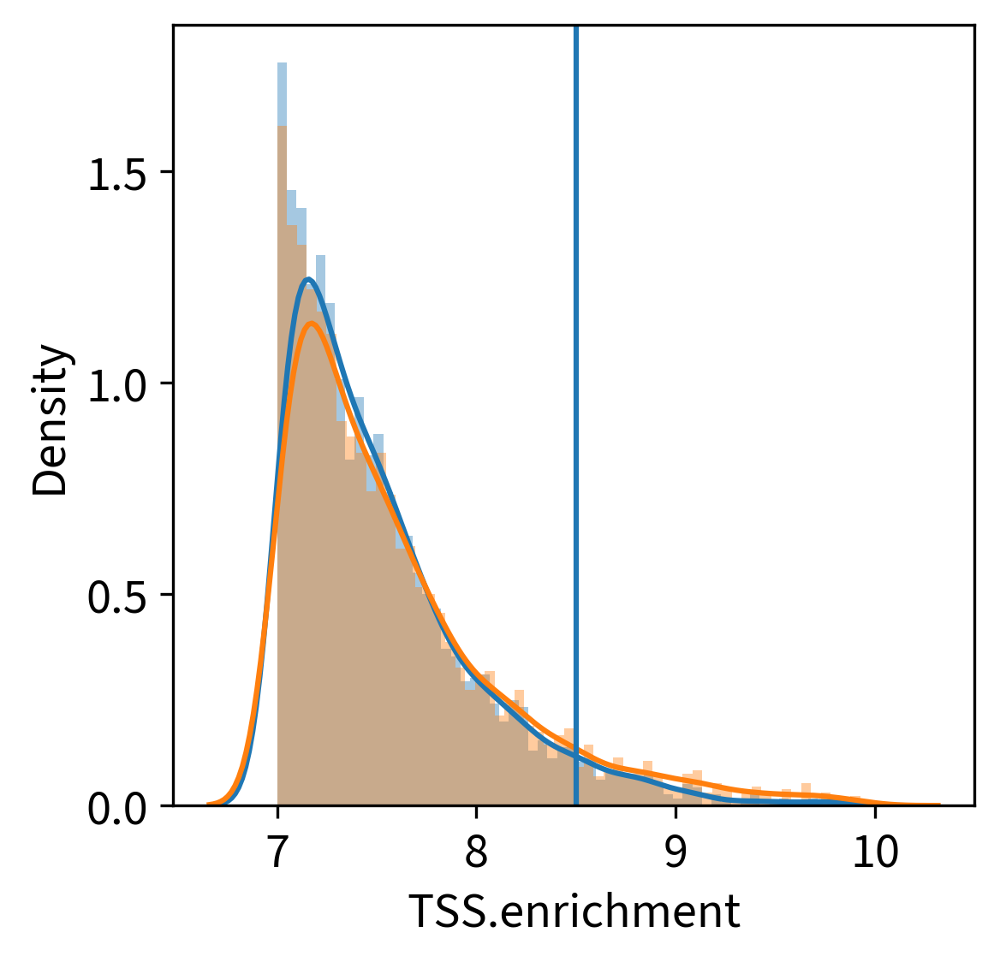

In [94]:
max_tss = 8.5
sb.distplot(adata.obs['TSS.enrichment'][(adata.obs['TSS.enrichment']>7) & (adata.obs['TSS.enrichment']<10) & (adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)], kde=True, bins=60)
sb.distplot(adata.obs['TSS.enrichment'][(adata.obs['TSS.enrichment']>7) & (adata.obs['TSS.enrichment']<10)], kde=True, bins=60)
plt.axvline(max_tss, 0, 1)

#### Nucleosome Signal

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='nucleosome_signal', ylabel='Density'>

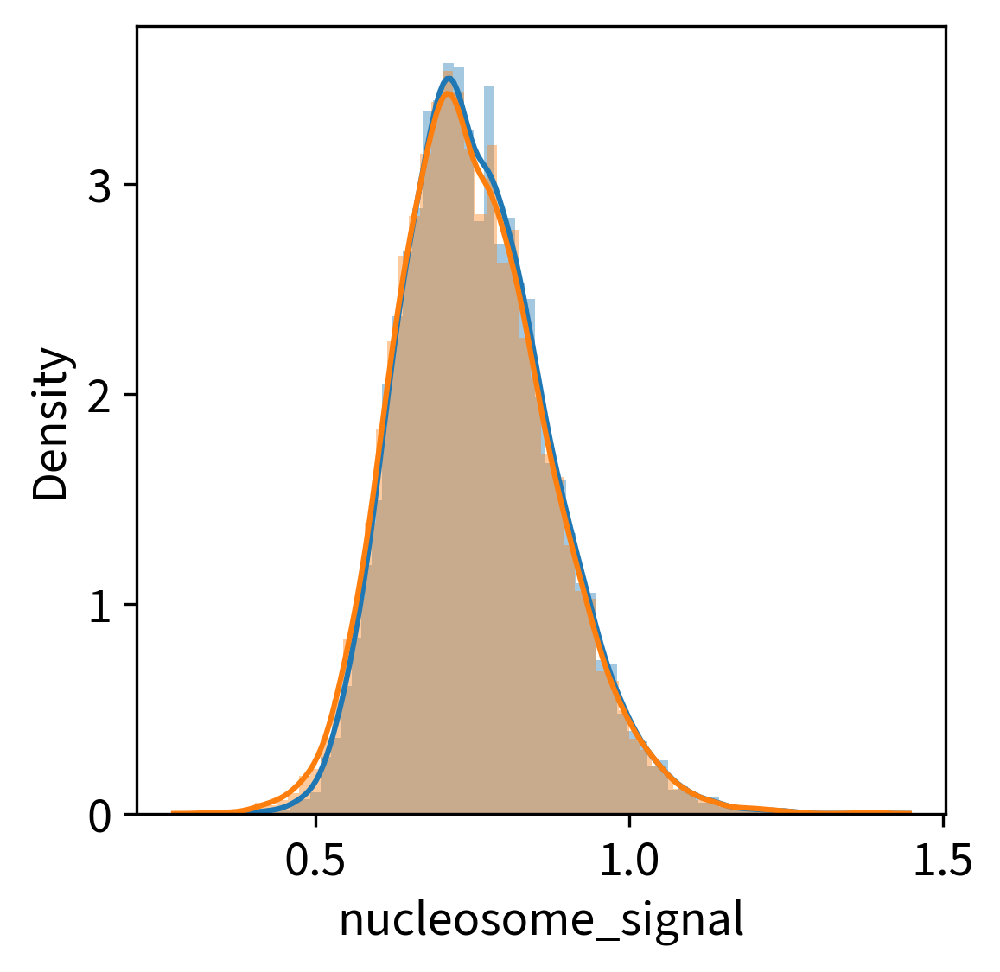

In [95]:
#Thresholding decision: nucleosome signal
sb.distplot(adata.obs['nucleosome_signal'][(adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)], kde=True, bins=60)
sb.distplot(adata.obs['nucleosome_signal'], kde=True, bins=60)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


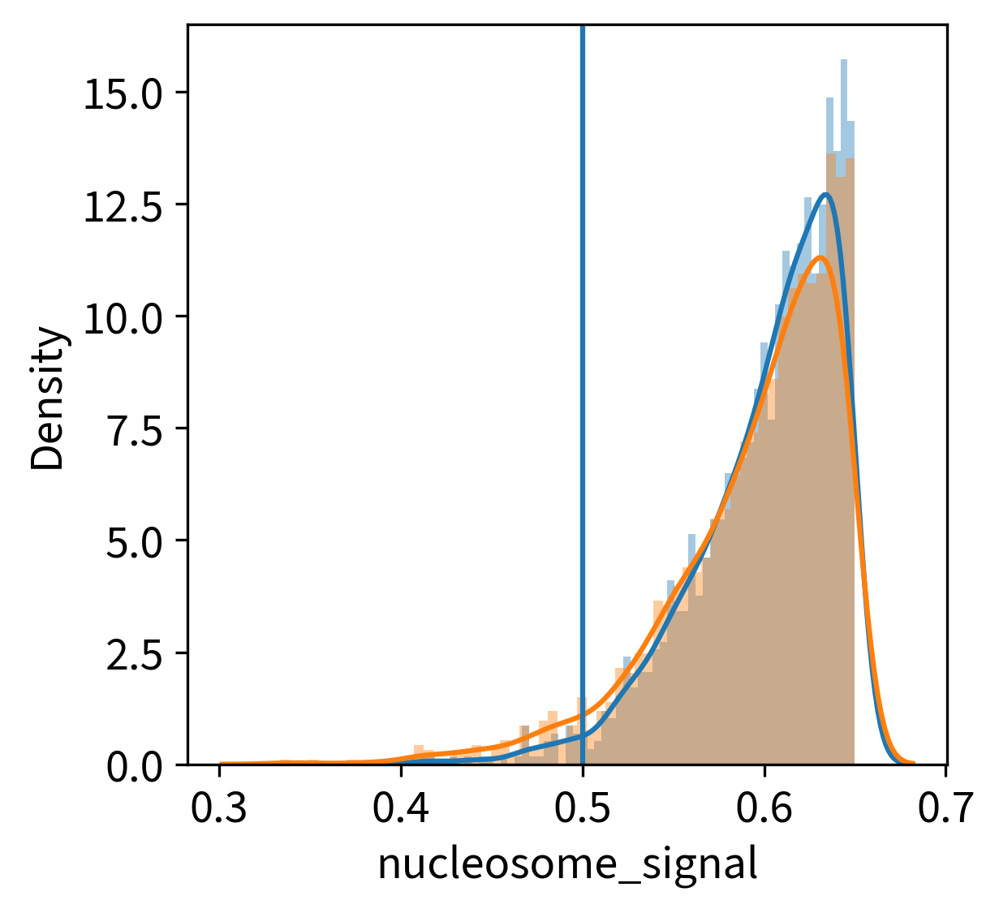

In [96]:
min_nuc = 0.5
sb.distplot(adata.obs['nucleosome_signal'][(adata.obs['nucleosome_signal']>0.25) & (adata.obs['nucleosome_signal']<0.65) & (adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)], kde=True, bins=60)
sb.distplot(adata.obs['nucleosome_signal'][(adata.obs['nucleosome_signal']>0.25) & (adata.obs['nucleosome_signal']<0.65)], kde=True, bins=60)
plt.axvline(min_nuc, 0, 1)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


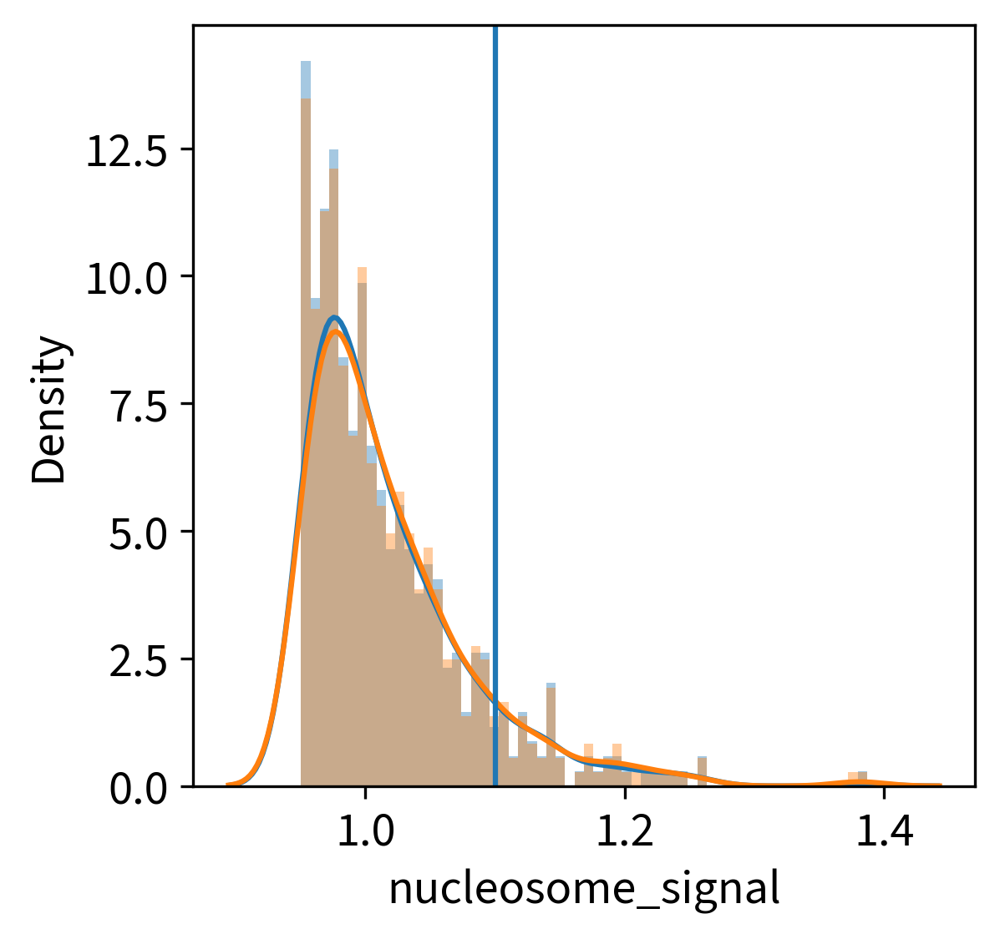

In [97]:
max_nuc = 1.1
sb.distplot(adata.obs['nucleosome_signal'][(adata.obs['nucleosome_signal']>0.95) & (adata.obs['nucleosome_signal']<1.5) & (adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)], kde=True, bins=60)
sb.distplot(adata.obs['nucleosome_signal'][(adata.obs['nucleosome_signal']>0.95) & (adata.obs['nucleosome_signal']<1.5)], kde=True, bins=60)
plt.axvline(max_nuc, 0, 1)

### Filtering

In [98]:
adata = adata[(adata.obs['nucleosome_signal'] > min_nuc) & (adata.obs['nucleosome_signal'] < max_nuc) & 
              (adata.obs['TSS.enrichment'] > min_tss) & (adata.obs['TSS.enrichment'] < max_tss) & 
              (adata.obs['nCount_ATAC'] > min_counts_atac) & (adata.obs['nCount_ATAC'] < max_counts_atac)].copy()

In [99]:
adata_multi = adata_multi[adata.obs_names].copy()

In [100]:
adata_multi.obs.loc[:,['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile']] = adata.obs.loc[:,['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile']]

In [101]:
# Get filtered barcodes
final_filtered_bc = list(adata.obs_names)

In [102]:
%%R -i final_filtered_bc

# filter cells
seurat <- seurat[,final_filtered_bc]

# save seurat file
saveRDS(seurat, "/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered_seurat.rds")

# Save Results

In [103]:
# Save
sc.write('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_gex_bc_matrix_filtered.h5ad', adata)
sc.write('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered.h5ad', adata_multi)
pd.Series(final_filtered_bc).to_csv('//storage/scRNA-seq/scMultiome_Mouse-Islets_NVF-E14.5_210044/data/cr_arc/cr_count/E15-5/outs/E15-5_raw_feature_bc_matrix_filtered_barcodes.txt', header=False, index=False)

/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'sample' as categorical
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'int_id' as categorical
/home/michi/Software/venvs/fvf_revision/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated